In [ ]:
# figure s3 is a crucial demonstration of all the signal processing in the paper - particularly the quantification
# data required here is: 1) identification and dose-response dipping, 2) mixed mixtures/serum and CSF dipping (see file fig2)

In [ ]:
# strategy for matching masks/identities across multiple movies:
# 1. load compmatch files for the whole set of movies for a probe - mask numbers are from merged_refit
# 2. Assign identities to masks in ID movie using ligand_row information determined as below from the clustering
# 3. Propagate these identities to every other movie based on respective compmatch information
# 4. 20230823_PL28,20230915_PL52,20230916_PL54 need propagation back to ref 001 movie, then from there to all other movies
# 5. Use this information for all subsequent movies - e.g. don't even mess with dose movies until IDs are firmly established and saved

In [1]:
movie_list_full = [[r'H:\CNMFoutputs\peter\mask_matching\20230823_PL28_done\20230823_PL28_wells001_Tiara_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230823_PL28_done\20230823_PL28_wells101_Tiara_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230823_PL28_done\20230823_PL28_wells201_Tiara_done_qc_doneqc'],
                   [r'H:\CNMFoutputs\peter\mask_matching\20230915_PL52_done\20230915_PL52_wells001_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230915_PL52_done\20230915_PL52_wells101_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230915_PL52_done\20230915_PL52_wells201_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230915_PL52_done\20230915_PL52_wells301_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230915_PL52_done\20230915_PL52_wells401_Yael_Done_qc_doneqc'],
                   [r'H:\CNMFoutputs\charlotte\mask_matching\20230916_PL48_charlotte_done\20230916_PL48_wells001_Tiara_done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230916_PL48_charlotte_done\20230916_PL48_wells101_Tiara_done_qc_doneqc'],
                   [r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells001_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells101_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells201_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells301_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells401_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells501_jordan_done_qc_doneqc'],
                   [r'H:\CNMFoutputs\charlotte\mask_matching\20230920_PL58_charlotte_done\20230920_PL58_wells001_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230920_PL58_charlotte_done\20230920_PL58_wells101_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230920_PL58_charlotte_done\20230920_PL58_wells201_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230920_PL58_charlotte_done\20230920_PL58_wells301_Done_qc_doneqc'],
                   [r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells001_jordan_done_qc_done',
                   r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells101_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells201_maddy_done_qc_done',
                   r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells301_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells401_Tiara_done_qc_done',
                   r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells501_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells601_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells701_david_done_qc_doneqc'],
                   [r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells001_Tiara_done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells101_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells201_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells301_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells401_Yael_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells501_Yael_Done_qc_doneqc'],
                   [r'H:\CNMFoutputs\peter\mask_matching\20230925_PL58_done\20230925_PL58_wells001_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230925_PL58_done\20230925_PL58_wells101_Tiara_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230925_PL58_done\20230925_PL58_wells201_Tiara_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230925_PL58_done\20230925_PL58_wells301_Tiara_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230925_PL58_done\20230925_PL58_wells401_Tiara_done_qc_doneqc'],
                   [r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells001_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells101_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells201_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells301_jordan_done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells401_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells501_david_done_qc_doneqc'],
                   [r'H:\CNMFoutputs\charlotte\mask_matching\20230927_PL34_charlotte_done\20230927_PL34_wells001_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230927_PL34_charlotte_done\20230927_PL34_wells101_Done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230927_PL34_charlotte_done\20230927_PL34_wells201_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\charlotte\mask_matching\20230927_PL34_charlotte_done\20230927_PL34_wells301_Done_qc_doneqc'],
                   [r'H:\CNMFoutputs\peter\mask_matching\20230927_PL58_done\20230927_PL58_wells001_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230927_PL58_done\20230927_PL58_wells101_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230927_PL58_done\20230927_PL58_wells201_david_done_qc_doneqc',
                   r'H:\CNMFoutputs\peter\mask_matching\20230927_PL58_done\20230927_PL58_wells301_david_done_qc_doneqc']]

In [2]:
# load in all movies to be used in this set of figures
import numpy as np
movie_list_id = [r'H:\CNMFoutputs\peter\mask_matching\20230823_PL28_done\20230823_PL28_wells201_Tiara_done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230915_PL52_done\20230915_PL52_wells301_Yael_Done_qc_doneqc',
             r'H:\CNMFoutputs\charlotte\mask_matching\20230916_PL48_charlotte_done\20230916_PL48_wells001_Tiara_done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells201_jordan_done_qc_doneqc',
             r'H:\CNMFoutputs\charlotte\mask_matching\20230920_PL58_charlotte_done\20230920_PL58_wells001_Done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells001_jordan_done_qc_done', #use old_version where necessary
             r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells001_Tiara_done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230925_PL58_done\20230925_PL58_wells001_jordan_done_qc_doneqc',
             r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells001_Done_qc_doneqc', 
             r'H:\CNMFoutputs\charlotte\mask_matching\20230927_PL34_charlotte_done\20230927_PL34_wells001_david_done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230927_PL58_done\20230927_PL58_wells001_david_done_qc_doneqc']
#which fit to use - can be varied if no # at the end of the row - probably dose-response is best, unless it's late in the dipping (confirm best for each movie)
pythonic_list_id = [1, #
                2, #
                0, #
                1, #
                1,
                1,
                0,
                1,
                1,
                1,
                1] 
mean_factor_id = [52,
               31,
               31,
               31,
               31,
               31,
               31,
               31,
               31,
               31,
               31] #[31 for i in range(len(pythonic_list))]
well_ids_id = [['AVP',
           'OXT',
           'ANA5VMAS-6',
           'ANA5VMAS-5',
           'ANA5VMAS-4',
           'ANA5VMAS-3',
           'ANA5VMAS-2',
           'ANA5VMAS-1',
           'DAOANPCH-6',
           'DAOANPCH-5',
           'DAOANPCH-4',
           'DAOANPCH-3',
           'DAOANPCH-2',
           'DAOANPCH-1',
           'P',
           'ACh',
           'NE',
           'ATP',
           '5HT',
           'DA',
           'MT',
           'SST',
           'P',
           'CCK',
           'HA',
           'Ado',
           'PTH',
           'NPY',
           'VIP',
           'AEA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P'],
           ['AVP',
           'OXT',
           '5HT',
           'CCK',
           'NPY',
           'VIP',
           'NE',
           'SST',
           'DA',
           'ACh',
           'ATP',
           'MT',
           'PTH',
           'Ado',
           'AEA',
           'HA',
           'P']]
wells_exclude_id = [np.arange(2,14),
                None,
                None,
                None,
                None,
                None,
                None,
                None,
                None,
                None,
                None]

In [3]:
# load in all movies to be used in this set of figures
movie_list_doses = [r'H:\CNMFoutputs\peter\mask_matching\20230823_PL28_done\20230823_PL28_wells201_Tiara_done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230915_PL52_done\20230915_PL52_wells401_Yael_Done_qc_doneqc',
             r'H:\CNMFoutputs\charlotte\mask_matching\20230916_PL48_charlotte_done\20230916_PL48_wells101_Tiara_done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230916_PL54_done\20230916_PL54_wells301_jordan_done_qc_doneqc',
             r'H:\CNMFoutputs\charlotte\mask_matching\20230920_PL58_charlotte_done\20230920_PL58_wells201_Done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells201_maddy_done_qc_done', #use old_version where necessary
             r'H:\CNMFoutputs\charlotte\mask_matching\20230923_PL35_charlotte_done\20230923_PL35_wells101_Yael_Done_qc_doneqc',
             r'H:\CNMFoutputs\peter\mask_matching\20230925_PL58_done\20230925_PL58_wells201_Tiara_done_qc_doneqc',
             r'H:\CNMFoutputs\charlotte\mask_matching\20230926_PL56_charlotte_done\20230926_PL56_wells201_jordan_done_qc_doneqc', 
             r'H:\CNMFoutputs\charlotte\mask_matching\20230927_PL34_charlotte_done\20230927_PL34_wells201_david_done_qc_doneqc', 
             r'H:\CNMFoutputs\peter\mask_matching\20230927_PL58_done\20230927_PL58_wells201_david_done_qc_doneqc']
#which fit to use - can be varied if no # at the end of the row
pythonic_list_doses = [1, #
                3, #
                0, #
                2, #
                1, #
                1, #
                0, #
                1, #
                1, #
                1, 
                1]  #
mean_factor_doses = [52,
               31,
               31,
               31,
               31,
               31,
               31,
               31,
               31,
               31,
               31] #[31 for i in range(len(pythonic_list))]
well_ids_doses = [['AVP',
           'OXT',
           'ANA5VMAS-6',
           'ANA5VMAS-5',
           'ANA5VMAS-4',
           'ANA5VMAS-3',
           'ANA5VMAS-2',
           'ANA5VMAS-1',
           'DAOANPCH-6',
           'DAOANPCH-5',
           'DAOANPCH-4',
           'DAOANPCH-3',
           'DAOANPCH-2',
           'DAOANPCH-1',
           'P',
           'ACh',
           'NE',
           'ATP',
           '5HT',
           'DA',
           'MT',
           'SST',
           'P',
           'CCK',
           'HA',
           'Ado',
           'PTH',
           'NPY',
           'VIP',
           'AEA',
           'P'],
           ['AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P',
           '5ND3',
           'VAAH2',
           '5ND2',
           'AMOC2',
           'ASAP1',
           '5ND5',
           'ASAP2',
           '5ND1',
           'AMOC1',
           '5ND4',
           'VAAH1',
           'P',
           'P',
           'P'],
           ['AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['5ND3',
           'VAAH2',
           '5ND2',
           'AMOC2',
           'ASAP1',
           '5ND5',
           'ASAP2',
           '5ND1',
           'AMOC1',
           '5ND4',
           'VAAH1',
           'P',
           'AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['5ND3',
           'VAAH2',
           '5ND2',
           'AMOC2',
           'ASAP1',
           '5ND5',
           'ASAP2',
           '5ND1',
           'AMOC1',
           '5ND4',
           'VAAH1',
           'P',
           'AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['5ND3',
           'VAAH2',
           '5ND2',
           'AMOC2',
           'ASAP1',
           '5ND5',
           'ASAP2',
           '5ND1',
           'AMOC1',
           '5ND4',
           'VAAH1',
           'P',
           'AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['5ND3',
           'VAAH2',
           '5ND2',
           'AMOC2',
           'ASAP1',
           '5ND5',
           'ASAP2',
           '5ND1',
           'AMOC1',
           '5ND4',
           'VAAH1',
           'P',
           'AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P'],
           ['5ND3',
           'VAAH2',
           '5ND2',
           'AMOC2',
           'ASAP1',
           '5ND5',
           'ASAP2',
           '5ND1',
           'AMOC1',
           '5ND4',
           'VAAH1',
           'P',
           'AO5CNVNS-6',
           'AO5CNVNS-5',
           'AO5CNVNS-4',
           'AO5CNVNS-3',
           'AO5CNVNS-2',
           'AO5CNVNS-1',
           'DAAMPAAH-6',
           'DAAMPAAH-5',
           'DAAMPAAH-4',
           'DAAMPAAH-3',
           'DAAMPAAH-2',
           'DAAMPAAH-1',
           'P']]
wells_exclude_doses = [np.hstack((np.arange(0,2),np.arange(15,29))),
                None,
                np.arange(14,25),
                None,
                None,
                None,
                np.arange(0,12),
                np.arange(0,12),
                np.arange(0,12),
                np.arange(0,12),
                np.arange(0,12)]

In [4]:
%%time
# All set up for merged_refit files! Remember to adjust for raw
## LOADING EVERYTHING UP - TAKES ~20 sec

# load packages

import napari
from magicgui import magicgui, widgets
import time
from sklearn.cluster import HDBSCAN
from scipy.spatial.distance import pdist,cdist,squareform
from itertools import chain


from IPython import get_ipython
from IPython.display import clear_output
import os
import matplotlib.pyplot as plt
from scipy.sparse import csc_matrix
from scipy import signal as sg
from scipy.ndimage import center_of_mass
import scipy
import pickle

from tifffile.tifffile import imwrite,imread
from tqdm.auto import tqdm,trange

from copy import deepcopy
import h5py

import caiman as cm
from caiman.source_extraction.cnmf import cnmf,params
from caiman.paths import caiman_datadir
from caiman.utils.visualization import get_contours

try:
    if __IPYTHON__:
        get_ipython().run_line_magic('load_ext', 'autoreload')
        get_ipython().run_line_magic('autoreload', '2')
except NameError:
    pass

def load_pickle(file_path):
    """
    Load a dictionary from a pickle file.

    Args:
    - file_path (str): Path to the pickle file.

    Returns:
    - dict: Loaded dictionary.
    """
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
    return data
    

from joblib import Parallel, delayed
from joblib.externals.loky import get_reusable_executor

import contextlib
import joblib
from tqdm import tqdm

n_cores = 35

@contextlib.contextmanager
def tqdm_joblib(tqdm_object):
    """Context manager to patch joblib to report into tqdm progress bar given as argument"""
    class TqdmBatchCompletionCallback(joblib.parallel.BatchCompletionCallBack):
        def __call__(self, *args, **kwargs):
            tqdm_object.update(n=self.batch_size)
            return super().__call__(*args, **kwargs)

    old_batch_callback = joblib.parallel.BatchCompletionCallBack
    joblib.parallel.BatchCompletionCallBack = TqdmBatchCompletionCallback
    try:
        yield tqdm_object
    finally:
        joblib.parallel.BatchCompletionCallBack = old_batch_callback
        tqdm_object.close()

CPU times: total: 14.8 s
Wall time: 19 s


In [5]:
print(len(movie_list_id))
print(len(pythonic_list_id))
print(len(mean_factor_id))
print(len(well_ids_id))
print(len(wells_exclude_id))

print(len(movie_list_doses))
print(len(pythonic_list_doses))
print(len(mean_factor_doses))
print(len(well_ids_doses))
print(len(wells_exclude_doses))

11
11
11
11
11
11
11
11
11
11


In [160]:
cnmf_dicts_id = []

for l in trange(len(movie_list_id)):
    if r'peter' in movie_list_id[l]:
        base_dir = r'H:\CNMFoutputs\peter\stitch_warp_done'
    elif r'charlotte' in movie_list_id[l]:
        base_dir = r'H:\CNMFoutputs\charlotte\stitch_warp_done'
    else:
        print("base dir error")

    cnmf_dict = {
        'base_dir': base_dir,
        'cnmf_path': os.path.join(movie_list_id[l], 'ch0_means_movie_nobg_cnmf_merged_refit.hdf5'),
        'cnmf': list(),
        'spcomps': list(),
        'CY': list(),
        'cnmf_matched_path': list(),
        'cnmf_matched': list(),
        'spcomps_matched': list(),
        'CY_matched': list(),
        'cnmf_matched_path_raw': list(),
        'cnmf_matched_raw': list(),
        'spcomps_matched_raw': list(),
        'CY_matched_raw': list()
    }

    if pythonic_list_id[l]==0:
        cnmf_dict['cnmf_matched_path'] = os.path.join(movie_list_id[l], f'ch0_means_movie_nobg_cnmf_merged_refit_matched.hdf5')
        cnmf_dict['cnmf_matched_path_raw'] = os.path.join(movie_list_id[l], f'ch0_means_movie_nobg_cnmf_mr_raw_refit_matched.hdf5')
    else:
        cnmf_dict['cnmf_matched_path'] = os.path.join(movie_list_id[l], f'ch0_means_movie_nobg_cnmf_merged_refit_matched{pythonic_list_id[l]:01}.hdf5')
        cnmf_dict['cnmf_matched_path_raw'] = os.path.join(movie_list_id[l], f'ch0_means_movie_nobg_cnmf_mr_raw_refit_matched{pythonic_list_id[l]:01}.hdf5')
    
    # CNMFE model
    cnmf_dict['cnmf'] = cnmf.load_CNMF(cnmf_dict['cnmf_path'], 
                                n_processes=1,
                                dview=None)
    
    # Line up all static inputs
    cnmf_dict['spcomps'] = np.reshape(cnmf_dict['cnmf'].estimates.A.toarray(),cnmf_dict['cnmf'].estimates.dims + (-1,),order='F')
    cnmf_dict['spcomps'] = cnmf_dict['spcomps'].transpose([3,2,0,1]).astype(np.float32)
    cnmf_dict['CY'] = cnmf_dict['cnmf'].estimates.C + cnmf_dict['cnmf'].estimates.YrA # temporal loadings
    print(f"Successfully loaded merged/refit CNMF model")
    
    # CNMFE model
    cnmf_dict['cnmf_matched'] = cnmf.load_CNMF(cnmf_dict['cnmf_matched_path'], 
                                n_processes=1,
                                dview=None)
    
    # Line up all static inputs
    cnmf_dict['spcomps_matched'] = np.reshape(cnmf_dict['cnmf_matched'].estimates.A.toarray(),cnmf_dict['cnmf_matched'].estimates.dims + (-1,),order='F')
    cnmf_dict['spcomps_matched'] = cnmf_dict['spcomps_matched'].transpose([3,2,0,1]).astype(np.float32)
    cnmf_dict['CY_matched'] = cnmf_dict['cnmf_matched'].estimates.C + cnmf_dict['cnmf_matched'].estimates.YrA # temporal loadings
    print(f"Successfully loaded matched CNMF model")
    
    # CNMFE model
    cnmf_dict['cnmf_matched_raw'] = cnmf.load_CNMF(cnmf_dict['cnmf_matched_path_raw'], 
                                n_processes=1,
                                dview=None)
    
    # Line up all static inputs
    cnmf_dict['spcomps_matched_raw'] = np.reshape(cnmf_dict['cnmf_matched_raw'].estimates.A.toarray(),cnmf_dict['cnmf_matched_raw'].estimates.dims + (-1,),order='F')
    cnmf_dict['spcomps_matched_raw'] = cnmf_dict['spcomps_matched_raw'].transpose([3,2,0,1]).astype(np.float32)
    cnmf_dict['CY_matched_raw'] = cnmf_dict['cnmf_matched_raw'].estimates.C + cnmf_dict['cnmf_matched_raw'].estimates.YrA # temporal loadings
    print(f"Successfully loaded matched raw CNMF model")

    cnmf_dicts_id.append(cnmf_dict)

  0%|          | 0/11 [00:00<?, ?it/s]

Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNM

In [23]:
cnmf_dicts_doses = []

for l in trange(len(movie_list_doses)):
    if r'peter' in movie_list_doses[l]:
        base_dir = r'H:\CNMFoutputs\peter\stitch_warp_done'
    elif r'charlotte' in movie_list_doses[l]:
        base_dir = r'H:\CNMFoutputs\charlotte\stitch_warp_done'
    else:
        print("base dir error")

    cnmf_dict = {
        'base_dir': base_dir,
        'cnmf_path': os.path.join(movie_list_doses[l], 'ch0_means_movie_nobg_cnmf_merged_refit.hdf5'),
        'cnmf': list(),
        'spcomps': list(),
        'CY': list(),
        'cnmf_matched_path': list(),
        'cnmf_matched': list(),
        'spcomps_matched': list(),
        'CY_matched': list(),
        'cnmf_matched_path_raw': list(),
        'cnmf_matched_raw': list(),
        'spcomps_matched_raw': list(),
        'CY_matched_raw': list()
    }

    if pythonic_list_doses[l]==0:
        cnmf_dict['cnmf_matched_path'] = os.path.join(movie_list_doses[l], f'ch0_means_movie_nobg_cnmf_merged_refit_matched.hdf5')
        cnmf_dict['cnmf_matched_path_raw'] = os.path.join(movie_list_doses[l], f'ch0_means_movie_nobg_cnmf_mr_raw_refit_matched.hdf5')
    else:
        cnmf_dict['cnmf_matched_path'] = os.path.join(movie_list_doses[l], f'ch0_means_movie_nobg_cnmf_merged_refit_matched{pythonic_list_doses[l]:01}.hdf5')
        cnmf_dict['cnmf_matched_path_raw'] = os.path.join(movie_list_doses[l], f'ch0_means_movie_nobg_cnmf_mr_raw_refit_matched{pythonic_list_doses[l]:01}.hdf5')
    
    # CNMFE model
    cnmf_dict['cnmf'] = cnmf.load_CNMF(cnmf_dict['cnmf_path'], 
                                n_processes=1,
                                dview=None)
    
    # Line up all static inputs
    cnmf_dict['spcomps'] = np.reshape(cnmf_dict['cnmf'].estimates.A.toarray(),cnmf_dict['cnmf'].estimates.dims + (-1,),order='F')
    cnmf_dict['spcomps'] = cnmf_dict['spcomps'].transpose([3,2,0,1]).astype(np.float32)
    cnmf_dict['CY'] = cnmf_dict['cnmf'].estimates.C + cnmf_dict['cnmf'].estimates.YrA # temporal loadings
    print(f"Successfully loaded merged/refit CNMF model")
    
    # CNMFE model
    cnmf_dict['cnmf_matched'] = cnmf.load_CNMF(cnmf_dict['cnmf_matched_path'], 
                                n_processes=1,
                                dview=None)
    
    # Line up all static inputs
    cnmf_dict['spcomps_matched'] = np.reshape(cnmf_dict['cnmf_matched'].estimates.A.toarray(),cnmf_dict['cnmf_matched'].estimates.dims + (-1,),order='F')
    cnmf_dict['spcomps_matched'] = cnmf_dict['spcomps_matched'].transpose([3,2,0,1]).astype(np.float32)
    cnmf_dict['CY_matched'] = cnmf_dict['cnmf_matched'].estimates.C + cnmf_dict['cnmf_matched'].estimates.YrA # temporal loadings
    print(f"Successfully loaded matched CNMF model")
    
    # CNMFE model
    cnmf_dict['cnmf_matched_raw'] = cnmf.load_CNMF(cnmf_dict['cnmf_matched_path_raw'], 
                                n_processes=1,
                                dview=None)
    
    # Line up all static inputs
    cnmf_dict['spcomps_matched_raw'] = np.reshape(cnmf_dict['cnmf_matched_raw'].estimates.A.toarray(),cnmf_dict['cnmf_matched_raw'].estimates.dims + (-1,),order='F')
    cnmf_dict['spcomps_matched_raw'] = cnmf_dict['spcomps_matched_raw'].transpose([3,2,0,1]).astype(np.float32)
    cnmf_dict['CY_matched_raw'] = cnmf_dict['cnmf_matched_raw'].estimates.C + cnmf_dict['cnmf_matched_raw'].estimates.YrA # temporal loadings
    print(f"Successfully loaded matched raw CNMF model")

    cnmf_dicts_doses.append(cnmf_dict)

  0%|          | 0/11 [00:00<?, ?it/s]

Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNMF model
Successfully loaded merged/refit CNMF model
Successfully loaded matched CNMF model
Successfully loaded matched raw CNM

In [1435]:
# INCLUDE HERE THE CODE FOR MOVIES THAT NEED RE-MATCHING (e.g. non-ID reference)

In [162]:
well_onsets_id = []
for l in trange(len(movie_list_id)):
    well_onsets_id.append(np.arange(0,cnmf_dicts_id[l]['CY_matched_raw'].shape[1],3*mean_factor_id[l]))

  0%|          | 0/11 [00:00<?, ?it/s]

In [24]:
well_onsets_doses = []
for l in trange(len(movie_list_doses)):
    well_onsets_doses.append(np.arange(0,cnmf_dicts_doses[l]['CY_matched_raw'].shape[1],3*mean_factor_doses[l]))

  0%|          | 0/11 [00:00<?, ?it/s]

In [163]:
for l in trange(len(movie_list_id)):
    rises = list()
    for id in range(cnmf_dicts_id[l]['CY_matched_raw'].shape[0]):
        sig_r = cnmf_dicts_id[l]['CY_matched_raw'][id,...].T
        sav_test_r = sg.savgol_filter(sig_r,30,1,deriv=1)
        if wells_exclude_id[l] is not None:
            for i in wells_exclude_id[l]:
                sav_test_r[well_onsets_id[l][i]:well_onsets_id[l][i+1]] = np.min(sav_test_r)
        #rises.append(np.min(np.where(sav_test_m[:30,] == np.max(sav_test_m[:30,]))))
        rises.append(np.min(np.where(sav_test_r == np.max(sav_test_r))))
    cnmf_dicts_id[l]['rises'] = rises

  0%|          | 0/11 [00:00<?, ?it/s]

In [25]:
for l in trange(len(movie_list_doses)):
    rises = list()
    for id in range(cnmf_dicts_doses[l]['CY_matched_raw'].shape[0]):
        sig_r = cnmf_dicts_doses[l]['CY_matched_raw'][id,...].T
        sav_test_r = sg.savgol_filter(sig_r,30,1,deriv=1)
        if wells_exclude_doses[l] is not None:
            for i in wells_exclude_doses[l]:
                sav_test_r[well_onsets_doses[l][i]:well_onsets_doses[l][i+1]] = np.min(sav_test_r)
        #rises.append(np.min(np.where(sav_test_m[:30,] == np.max(sav_test_m[:30,]))))
        rises.append(np.min(np.where(sav_test_r == np.max(sav_test_r))))
    cnmf_dicts_doses[l]['rises'] = rises

  0%|          | 0/11 [00:00<?, ?it/s]

In [164]:
for l in trange(len(movie_list_id)):
    cnmf_dicts_id[l]['CY_matched_raw_sort'] = np.sort(cnmf_dicts_id[l]['CY_matched_raw'],axis=1)
    cnmf_dicts_id[l]['CY_matched_raw_b10'] = np.mean(cnmf_dicts_id[l]['CY_matched_raw_sort'][:,:int(np.ceil(cnmf_dicts_id[l]['CY_matched_raw_sort'].shape[1]/10))],axis=1) # bottom 10% mean
    cnmf_dicts_id[l]['CY_matched_raw_t10'] = np.mean(cnmf_dicts_id[l]['CY_matched_raw_sort'][:,-int(np.ceil(cnmf_dicts_id[l]['CY_matched_raw_sort'].shape[1]/10)):],axis=1) # top 10% mean
    
    cnmf_dicts_id[l]['CY_matched_raw_norm1'] = ((cnmf_dicts_id[l]['CY_matched_raw'].T-cnmf_dicts_id[l]['CY_matched_raw_b10'])/(cnmf_dicts_id[l]['CY_matched_raw_t10']-cnmf_dicts_id[l]['CY_matched_raw_b10'])).T

  0%|          | 0/11 [00:00<?, ?it/s]

In [26]:
for l in trange(len(movie_list_doses)):
    cnmf_dicts_doses[l]['CY_matched_raw_sort'] = np.sort(cnmf_dicts_doses[l]['CY_matched_raw'],axis=1)
    cnmf_dicts_doses[l]['CY_matched_raw_b10'] = np.mean(cnmf_dicts_doses[l]['CY_matched_raw_sort'][:,:int(np.ceil(cnmf_dicts_doses[l]['CY_matched_raw_sort'].shape[1]/10))],axis=1) # bottom 10% mean
    cnmf_dicts_doses[l]['CY_matched_raw_t10'] = np.mean(cnmf_dicts_doses[l]['CY_matched_raw_sort'][:,-int(np.ceil(cnmf_dicts_doses[l]['CY_matched_raw_sort'].shape[1]/10)):],axis=1) # top 10% mean
    
    cnmf_dicts_doses[l]['CY_matched_raw_norm1'] = ((cnmf_dicts_doses[l]['CY_matched_raw'].T-cnmf_dicts_doses[l]['CY_matched_raw_b10'])/(cnmf_dicts_doses[l]['CY_matched_raw_t10']-cnmf_dicts_doses[l]['CY_matched_raw_b10'])).T

  0%|          | 0/11 [00:00<?, ?it/s]

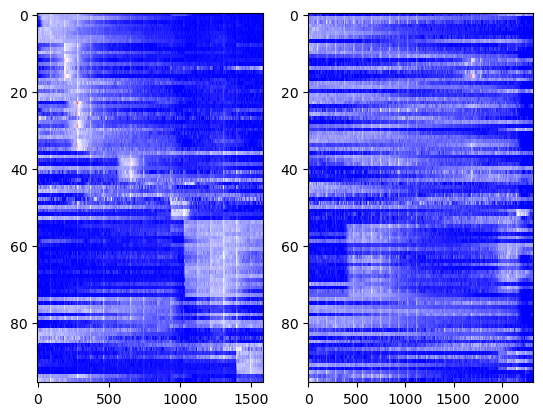

In [1446]:
# looks like 0,1 are bad
# 2,4,6,9,10 are ok
# 5 is great
# 7,8 are questionable - good ID, worse dose response (8 better but still poor)
# 3 needs reverse match code - or reclicking to 201 reference? need to decide on 0,1,3 - should go back and code up reverse match!
# for mixed mixtures - good ones seem to be 6 (weaker: 2,8,9,10, ?0)
l = 9
plt.subplot(1, 2, 1)
plt.imshow(cnmf_dicts_id[l]['CY_matched_raw_norm1'][np.argsort(cnmf_dicts_id[l]['rises']),...], interpolation='nearest', aspect='auto',cmap='bwr',vmin=0)
plt.subplot(1, 2, 2)
plt.imshow(cnmf_dicts_doses[l]['CY_matched_raw_norm1'][np.argsort(cnmf_dicts_id[l]['rises']),...], interpolation='nearest', aspect='auto',cmap='bwr',vmin=0)

In [426]:
# for now deal mainly with movies 2 and 4:... (fix matches for 0,1,3)

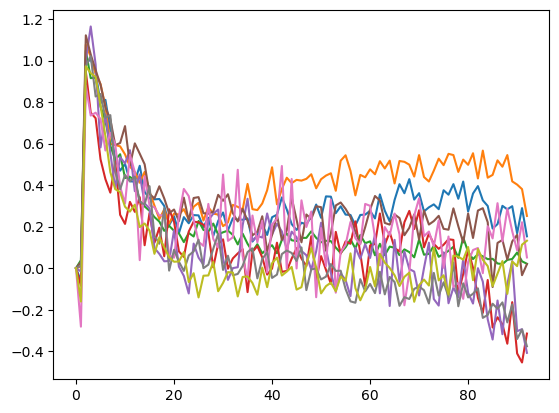

In [427]:
jump = 3*mean_factor_id[l]
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([0,1,2,4,8,11,12,13,15])
for k in list(jump-2+fit_range*jump):
    plt.plot(np.mean(((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k])/((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k-5:k],0)),1))

In [496]:
# shoot for 8 dips to average across (arbitrary value)
fit_ranges_id = [np.array([0,1,2,3,4,8,9,11]), # fix
             np.array([0,2,3,4,5,6,7,8,11,14]),# fix
             np.array([1,4,8,11,12,15]),
             np.array([0,1,2,6,7,14]), # fix
             np.array([1,4,8,11]),
             np.array([0,1,4,8,11,12,13,14,15]),
             np.array([3,6,7,11]),
             np.array([0,1,2,7,11,12,15]),
             np.array([0,1,2,4,7,8,13,15]),
             np.array([0,3,6,7]),
             np.array([0,1,2,4,8,11,12,13,15])]

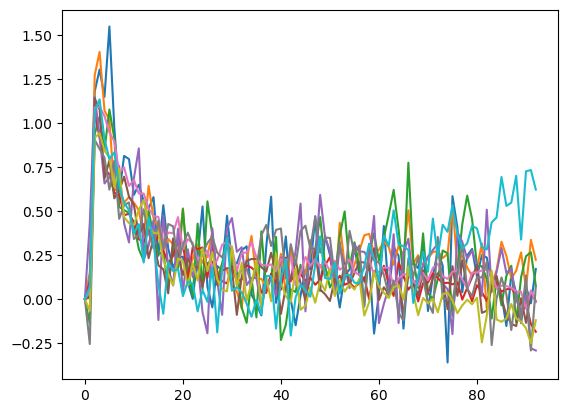

In [1473]:
jump = 3*mean_factor_doses[l]
#for k in range(jump-2,jump*2,jump):
fit_range = np.array([2,4,5,9,12,13,17,20,21,23])
for k in list(jump-2+fit_range*jump):
    plt.plot(np.mean(((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k])/((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k-5:k],0)),1))

In [27]:
# shoot for 8 dips to average across (arbitrary value)
fit_ranges_doses = [np.array([0,1,2,3,4,8,9,11]), # fix
             np.array([0,1,2,3,4,6,7,8,9]), # fix
             np.array([1,2,3,5,9,13,17,18,20,21,22,23]),
             np.array([1,2,4,5,6,7,8,9]), # fix
             np.array([1,2,7,8]),
             np.array([0,1,2,6,7,11]),
             np.array([0,1,2,4,6,7,9,11,12,17,21]),
             np.array([0,2,3,4,5,6,7,8,9,10,11,13,14,15,16,17,18,19,20,21]),
             np.array([2,4,6,7,8,10,11,15,16,17,19,21]),
             np.array([2,4,5,9,12,13,17,20,21,23]),
             np.array([0,1,6,8,9,14,15,18,19])]

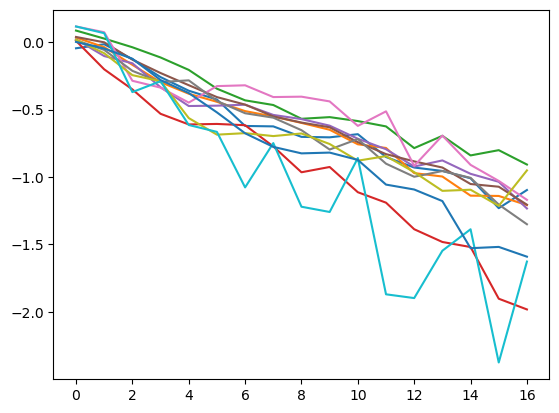

In [497]:
for l in range(len(movie_list_id)):
    a = []
    jump = 3*mean_factor_id[l]
    fit_range = fit_ranges_id[l]
    for k in list(jump-2+fit_range*jump):
        a.append(np.mean(((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k])/((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k-5:k],0)),1))
    plt.plot(np.log(np.mean(np.array(a)[:,2:19],0)))

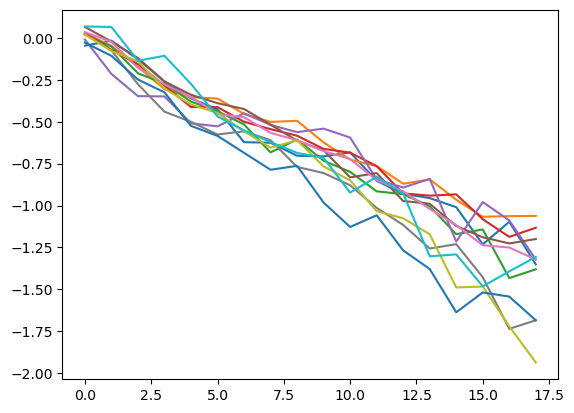

In [28]:
for l in range(len(movie_list_doses)):
    a = []
    jump = 3*mean_factor_doses[l]
    fit_range = fit_ranges_doses[l]
    for k in list(jump-2+fit_range*jump):
        a.append(np.mean(((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k])/((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k-5:k],0)),1))
    plt.plot(np.log(np.mean(np.array(a)[:,2:20],0)))

  0%|          | 0/11 [00:00<?, ?it/s]

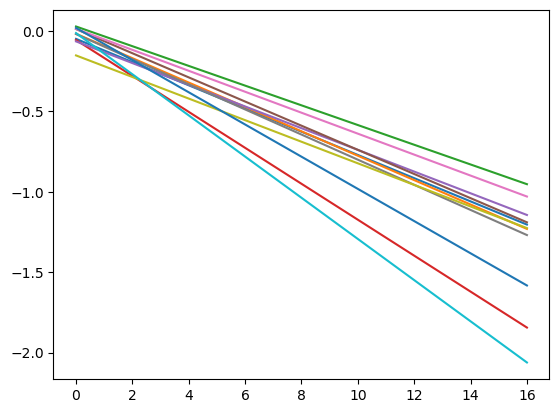

In [498]:
for l in trange(len(movie_list_id)):
    a = []
    jump = 3*mean_factor_id[l]
    fit_range = fit_ranges_id[l]
    for k in list(jump-2+fit_range*jump):
        a.append(np.mean(((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k])/((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_id[l]['CY_matched_raw'][np.argsort(cnmf_dicts_id[l]['rises']),...].T)[k-5:k],0)),1))
    xa = np.arange(2,19)
    ya = np.mean(np.array(a)[:,2:19],0)
    cnmf_dicts_id[l]['af'] = np.polyfit(xa, np.log(ya), 1)
    plt.plot(cnmf_dicts_id[l]['af'][0]*xa+cnmf_dicts_id[l]['af'][1])

  0%|          | 0/11 [00:00<?, ?it/s]

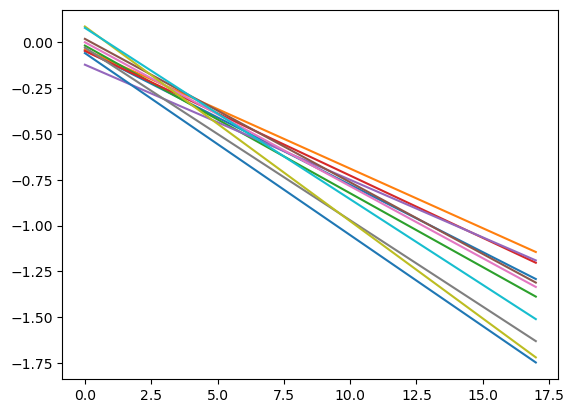

In [29]:
for l in trange(len(movie_list_doses)):
    a = []
    jump = 3*mean_factor_doses[l]
    fit_range = fit_ranges_doses[l]
    for k in list(jump-2+fit_range*jump):
        a.append(np.mean(((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k:k+jump]-(cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k])/((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k+2]-np.mean((cnmf_dicts_doses[l]['CY_matched_raw'][np.argsort(cnmf_dicts_doses[l]['rises']),...].T)[k-5:k],0)),1))
    xa = np.arange(2,20)
    ya = np.mean(np.array(a)[:,2:20],0)
    cnmf_dicts_doses[l]['af'] = np.polyfit(xa, np.log(ya), 1)
    plt.plot(cnmf_dicts_doses[l]['af'][0]*xa+cnmf_dicts_doses[l]['af'][1])

In [499]:
for l in trange(len(movie_list_id)):
    cnmf_dicts_id[l]['CY_matched_raw_dfs'] = []
    jump = 3*mean_factor_id[l]
    
    for k in range(jump-2,cnmf_dicts_id[l]['CY_matched_raw'].shape[1]-3,jump):
        cnmf_dicts_id[l]['CY_matched_raw_dfs'].append(cnmf_dicts_id[l]['CY_matched_raw'][:,k+2]-np.mean(cnmf_dicts_id[l]['CY_matched_raw'][:,k-5:k],1))

    cnmf_dicts_id[l]['corrbase'] = np.zeros(cnmf_dicts_id[l]['CY_matched_raw'].shape)
    for d in range(np.array(cnmf_dicts_id[l]['CY_matched_raw_dfs']).shape[0]):
        cnmf_dicts_id[l]['corrbase'][:,jump*(d+1):np.minimum(cnmf_dicts_id[l]['CY_matched_raw'].shape[1]-1,jump*(d+2)-1)] = cnmf_dicts_id[l]['corrbase'][:,jump*(d+1):np.minimum(cnmf_dicts_id[l]['CY_matched_raw'].shape[1]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(cnmf_dicts_id[l]['af'][0]*np.arange(0,np.minimum(cnmf_dicts_id[l]['CY_matched_raw'].shape[1]-1-jump*(d+1),jump-1))),(np.array(cnmf_dicts_id[l]['CY_matched_raw_dfs']).shape[1],) + (np.minimum(cnmf_dicts_id[l]['CY_matched_raw'].shape[1]-1-jump*(d+1),jump-1),))*np.array(cnmf_dicts_id[l]['CY_matched_raw_dfs'])[d,:][...,np.newaxis]

    cnmf_dicts_id[l]['CY_matched_raw_corr'] = cnmf_dicts_id[l]['CY_matched_raw']-cnmf_dicts_id[l]['corrbase']
    
    cnmf_dicts_id[l]['CY_matched_raw_corr_sort'] = np.sort(cnmf_dicts_id[l]['CY_matched_raw_corr'],axis=1)
    cnmf_dicts_id[l]['CY_matched_raw_corr_b10'] = np.mean(cnmf_dicts_id[l]['CY_matched_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_id[l]['CY_matched_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
    cnmf_dicts_id[l]['CY_matched_raw_corr_t10'] = np.mean(cnmf_dicts_id[l]['CY_matched_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_id[l]['CY_matched_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean
    
    cnmf_dicts_id[l]['CY_matched_raw_corr_dff'] = ((cnmf_dicts_id[l]['CY_matched_raw_corr'].T-cnmf_dicts_id[l]['CY_matched_raw_corr_b10'])/(cnmf_dicts_id[l]['CY_matched_raw_corr_b10'])).T
    cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'] = ((cnmf_dicts_id[l]['CY_matched_raw_corr'].T-cnmf_dicts_id[l]['CY_matched_raw_corr_b10'])/(cnmf_dicts_id[l]['CY_matched_raw_corr_t10']-cnmf_dicts_id[l]['CY_matched_raw_corr_b10'])).T

  0%|          | 0/11 [00:00<?, ?it/s]

In [30]:
for l in trange(len(movie_list_doses)):
    cnmf_dicts_doses[l]['CY_matched_raw_dfs'] = []
    jump = 3*mean_factor_doses[l]
    
    for k in range(jump-2,cnmf_dicts_doses[l]['CY_matched_raw'].shape[1]-3,jump):
        cnmf_dicts_doses[l]['CY_matched_raw_dfs'].append(cnmf_dicts_doses[l]['CY_matched_raw'][:,k+2]-np.mean(cnmf_dicts_doses[l]['CY_matched_raw'][:,k-5:k],1))

    cnmf_dicts_doses[l]['corrbase'] = np.zeros(cnmf_dicts_doses[l]['CY_matched_raw'].shape)
    for d in range(np.array(cnmf_dicts_doses[l]['CY_matched_raw_dfs']).shape[0]):
        cnmf_dicts_doses[l]['corrbase'][:,jump*(d+1):np.minimum(cnmf_dicts_doses[l]['CY_matched_raw'].shape[1]-1,jump*(d+2)-1)] = cnmf_dicts_doses[l]['corrbase'][:,jump*(d+1):np.minimum(cnmf_dicts_doses[l]['CY_matched_raw'].shape[1]-1,jump*(d+2)-1)]+np.broadcast_to(np.exp(cnmf_dicts_doses[l]['af'][0]*np.arange(0,np.minimum(cnmf_dicts_doses[l]['CY_matched_raw'].shape[1]-1-jump*(d+1),jump-1))),(np.array(cnmf_dicts_doses[l]['CY_matched_raw_dfs']).shape[1],) + (np.minimum(cnmf_dicts_doses[l]['CY_matched_raw'].shape[1]-1-jump*(d+1),jump-1),))*np.array(cnmf_dicts_doses[l]['CY_matched_raw_dfs'])[d,:][...,np.newaxis]

    cnmf_dicts_doses[l]['CY_matched_raw_corr'] = cnmf_dicts_doses[l]['CY_matched_raw']-cnmf_dicts_doses[l]['corrbase']
    
    cnmf_dicts_doses[l]['CY_matched_raw_corr_sort'] = np.sort(cnmf_dicts_doses[l]['CY_matched_raw_corr'],axis=1)
    cnmf_dicts_doses[l]['CY_matched_raw_corr_b10'] = np.mean(cnmf_dicts_doses[l]['CY_matched_raw_corr_sort'][:,:int(np.ceil(cnmf_dicts_doses[l]['CY_matched_raw_corr_sort'].shape[1]/10))],axis=1) # bottom 10% mean
    cnmf_dicts_doses[l]['CY_matched_raw_corr_t10'] = np.mean(cnmf_dicts_doses[l]['CY_matched_raw_corr_sort'][:,-int(np.ceil(cnmf_dicts_doses[l]['CY_matched_raw_corr_sort'].shape[1]/10)):],axis=1) # top 10% mean
    
    cnmf_dicts_doses[l]['CY_matched_raw_corr_dff'] = ((cnmf_dicts_doses[l]['CY_matched_raw_corr'].T-cnmf_dicts_doses[l]['CY_matched_raw_corr_b10'])/(cnmf_dicts_doses[l]['CY_matched_raw_corr_b10'])).T
    cnmf_dicts_doses[l]['CY_matched_raw_corr_norm1'] = ((cnmf_dicts_doses[l]['CY_matched_raw_corr'].T-cnmf_dicts_doses[l]['CY_matched_raw_corr_b10'])/(cnmf_dicts_doses[l]['CY_matched_raw_corr_t10']-cnmf_dicts_doses[l]['CY_matched_raw_corr_b10'])).T

  0%|          | 0/11 [00:00<?, ?it/s]

In [500]:
for l in trange(len(movie_list_id)):
    cnmf_dicts_id[l]['savs_nc'] = list()
    for id in range(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0]):
        sig_r = cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][id,...].T
        cnmf_dicts_id[l]['savs_nc'].append(sg.savgol_filter(sig_r,30,1,deriv=1))
        #rises.append(np.min(np.where(sav_test_m[:30,] == np.max(sav_test_m[:30,]))))
       #np.min(np.where(sav_test_r == np.max(sav_test_r))))
    cnmf_dicts_id[l]['savs_nc'] = np.array(cnmf_dicts_id[l]['savs_nc'])

  0%|          | 0/11 [00:00<?, ?it/s]

In [31]:
for l in trange(len(movie_list_doses)):
    cnmf_dicts_doses[l]['savs_nc'] = list()
    for id in range(cnmf_dicts_doses[l]['CY_matched_raw_corr_norm1'].shape[0]):
        sig_r = cnmf_dicts_doses[l]['CY_matched_raw_corr_norm1'][id,...].T
        cnmf_dicts_doses[l]['savs_nc'].append(sg.savgol_filter(sig_r,30,1,deriv=1))
        #rises.append(np.min(np.where(sav_test_m[:30,] == np.max(sav_test_m[:30,]))))
       #np.min(np.where(sav_test_r == np.max(sav_test_r))))
    cnmf_dicts_doses[l]['savs_nc'] = np.array(cnmf_dicts_doses[l]['savs_nc'])

  0%|          | 0/11 [00:00<?, ?it/s]

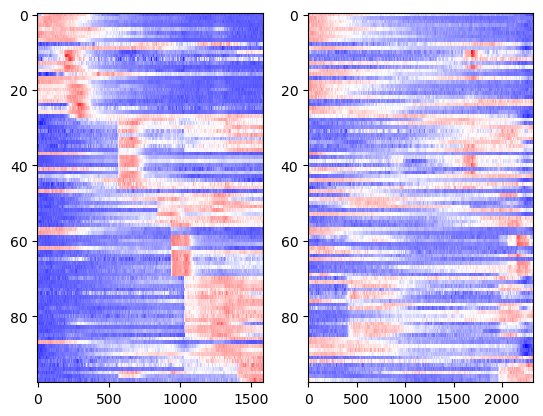

In [501]:
l = 10
plt.subplot(1, 2, 1)
plt.imshow(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][np.argsort(cnmf_dicts_id[l]['rises']),...], interpolation='nearest', aspect='auto',cmap='bwr')
plt.subplot(1, 2, 2)
plt.imshow(cnmf_dicts_doses[l]['CY_matched_raw_corr_norm1'][np.argsort(cnmf_dicts_id[l]['rises']),...], interpolation='nearest', aspect='auto',cmap='bwr')

In [510]:
# goals: peak dF/F for each sensor (from IDs), Kd for each sensor (doses), tau on/off for each sensor (doses)
# good enough IDs for dF/F: 2,4,5,6,8,9,10 (3,7,1?),(0??)
# good enough doses for Kd/taus: 4,5 (2,6,9,10?),(8??)
# clearly the pipeline should be to define sensor identities on the IDs, then apply to dose-responses and other dips
# probably it's better to quickly but carefully cluster each movie individually - and save the IDs for future use so they don't need to be recalculated!
## however - in this case e.g. movie 1 shows no clusters at all (too few real cells)
## so - the complete way is to get identities on all traces, then go back and cluster each one and define cluster by presence of rows from group cluster
# then always inherit these IDs for further analyses - and subset further as needed, e.g. if quality deteriorates

In [1485]:
# fusing the good enough IDs all together - maybe just use this approach for fig 1, and order individual traces color-coded by movie?
# fusing all traces is more convincing on low AVP/OXT crosstalk, more places where AVP sensor got hit with OXT - even with better washout!
# mov_group is movie/probe identity, and mov_ids is row number within that probe
CY_matched_raw_corr_norm1_sum_id = np.zeros((0,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[1]))
savs_nc_sum_id = np.zeros((0,cnmf_dicts_id[l]['savs_nc'].shape[1]))
mov_group = []
mov_ids = []
for l in np.arange(1,11):
    CY_matched_raw_corr_norm1_sum_id = np.vstack((CY_matched_raw_corr_norm1_sum_id,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1']))
    savs_nc_sum_id = np.vstack((savs_nc_sum_id,cnmf_dicts_id[l]['savs_nc']))
    mov_group += [l]*cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0]
    mov_ids += np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0]).tolist()

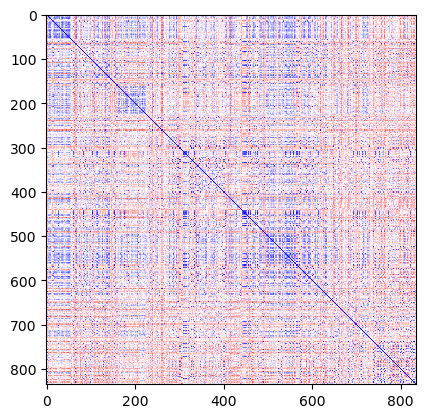

In [1486]:
plt.imshow(squareform(pdist(savs_nc_sum_id,'correlation')), interpolation='nearest',cmap='bwr')

In [1487]:
hdbs_id = HDBSCAN(min_cluster_size = 3,metric='precomputed')
hdbs_id.fit(squareform(pdist(savs_nc_sum_id,'correlation')))
#hdbs.fit(savs_nc)
lcounts_id = np.array(np.unique(hdbs_id.labels_, return_counts=True))
hdbs_id.labels_

array([-1, 12, -1,  3, -1, -1, -1, 10, 10, -1, 10, -1, -1, 15, -1, -1, 12,
       -1, -1, 10, -1, -1, 10, -1, -1, -1, -1, 10, 14, -1, -1, -1, -1, -1,
       -1, -1, -1, 10, -1, -1, 10, -1, 10, -1, -1, 10, -1, -1, -1, 10, 10,
       -1, -1, 10, 14, -1,  1,  6, 12, -1, -1, 14, 14, -1, -1, -1,  3,  9,
       -1, -1, -1, -1, -1,  1,  1, 12, -1, -1, 14, -1, -1, -1,  6, 14, 14,
       -1, -1,  9, 14,  9,  1, -1, -1, -1, -1, -1, -1, -1, -1,  8,  3,  6,
       -1, -1, 14, -1, -1, -1, 10,  8, -1, -1,  1, -1, -1, -1, 14, -1, -1,
        3, -1,  3, -1, -1, 14, -1, 14, -1, 14,  9, -1, 12, -1, -1,  8, -1,
       -1, 10, 10, 14, -1, -1, -1, -1, 14, -1, -1, -1, -1, -1,  3, -1,  9,
       -1, 14, -1, -1,  6, -1,  4, -1,  4, 12, -1,  0,  0, -1, 14, -1, -1,
       -1, -1, -1, 13,  0, -1, 13, 14, -1,  0, -1,  0, -1,  0,  0, -1, 12,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, 13,  0,  0, -1, -1,  0, 12, -1,
       -1, -1, -1, 13, 12, -1, -1, -1, -1, -1, -1, -1,  0,  0, -1, -1, -1,
       -1, -1, -1, -1, 12

In [1488]:
lcounts_id

array([[ -1,   0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,
         12,  13,  14,  15],
       [454,  12,  12,   3,  39,   6,   3,   9,   6,  20,  69,  28,   9,
         28,   4, 106,  27]], dtype=int64)

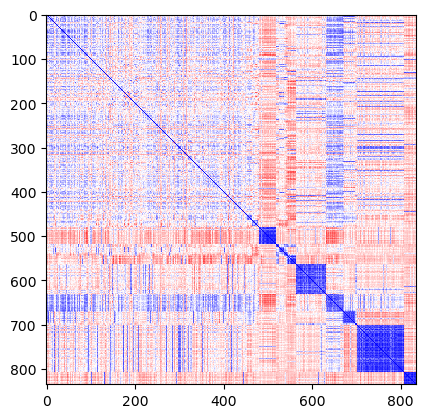

In [1489]:
plt.imshow(squareform(pdist(savs_nc_sum_id[np.argsort(hdbs_id.labels_),...],'correlation')), interpolation='nearest',cmap='bwr')

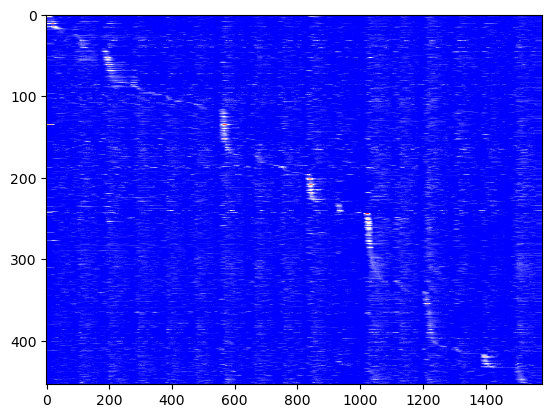

In [1490]:
plt.imshow(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[0:lcounts_id[1,0]],...][np.argsort([np.min(np.where(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[0:lcounts_id[1,0]],...][i,...] == np.max(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[0:lcounts_id[1,0]],...][i,...]))) for i in range(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[0:lcounts_id[1,0]],...].shape[0])]),...], interpolation='nearest',aspect='auto',cmap='bwr',vmin=0,vmax=0.05)

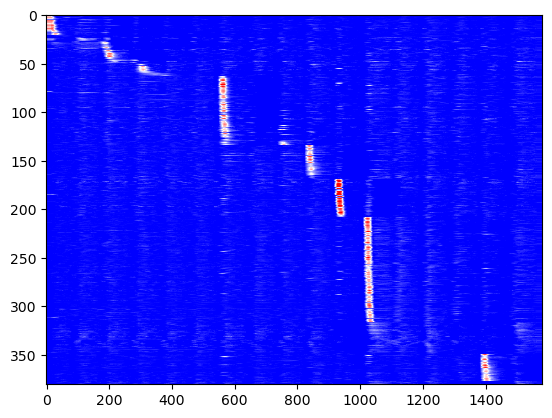

In [1491]:
plt.imshow(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[lcounts_id[1,0]:],...][np.argsort([np.min(np.where(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[lcounts_id[1,0]:],...][i,...] == np.max(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[lcounts_id[1,0]:],...][i,...]))) for i in range(savs_nc_sum_id[np.argsort(hdbs_id.labels_)[lcounts_id[1,0]:],...].shape[0])]),...], interpolation='nearest',aspect='auto',cmap='bwr',vmin=0,vmax=0.05)

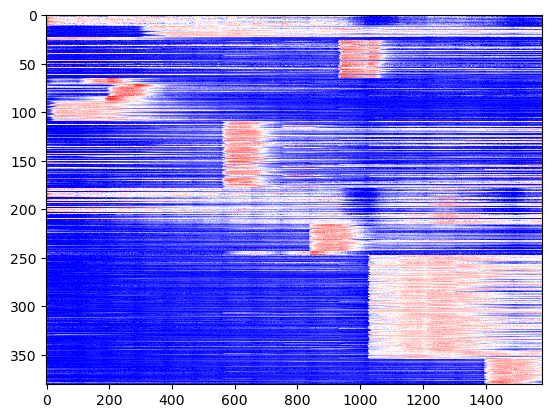

In [1492]:
plt.imshow(CY_matched_raw_corr_norm1_sum_id[np.argsort(hdbs_id.labels_)[lcounts_id[1,0]:],...], interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)

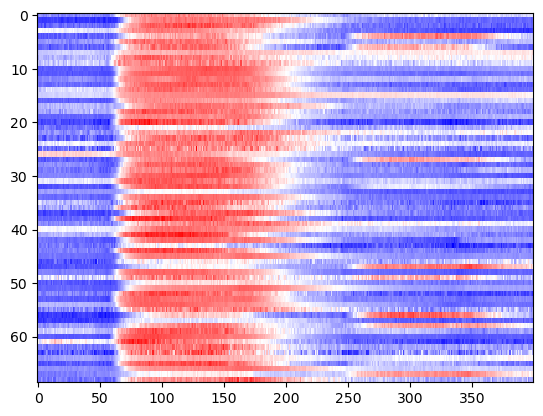

In [1494]:
plt.imshow(CY_matched_raw_corr_norm1_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],500:900], interpolation='nearest',aspect='auto',cmap='bwr')

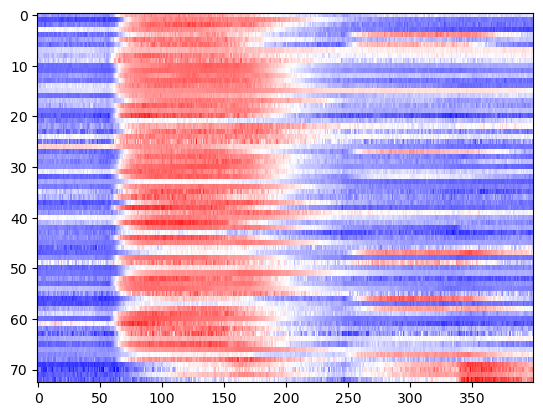

In [1497]:
plt.imshow(np.vstack((CY_matched_raw_corr_norm1_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],500:900],CY_matched_raw_corr_norm1_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:14]):np.sum(lcounts_id[1,0:15])],500:900])), interpolation='nearest',aspect='auto',cmap='bwr')

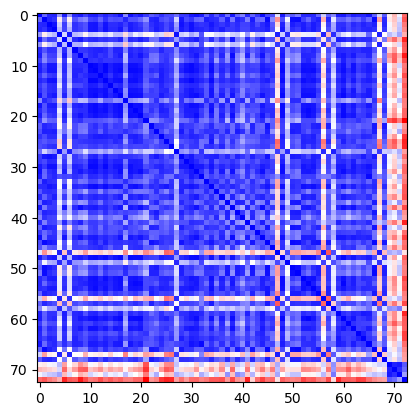

In [1498]:
plt.imshow(squareform(pdist(np.vstack((savs_nc_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],500:900],savs_nc_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:14]):np.sum(lcounts_id[1,0:15])],500:900])),'correlation')), interpolation='nearest',cmap='bwr')

In [1502]:
hdbs_id_neda = HDBSCAN(min_cluster_size = 3,metric='precomputed')
hdbs_id_neda.fit(squareform(pdist(np.vstack((savs_nc_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],500:900],savs_nc_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:14]):np.sum(lcounts_id[1,0:15])],500:900])),'correlation')))
#hdbs.fit(savs_nc)
lcounts_id_neda = np.array(np.unique(hdbs_id_neda.labels_, return_counts=True))
hdbs_id_neda.labels_

array([1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1,
       1, 2, 1, 0, 0, 0, 0], dtype=int64)

In [1503]:
lcounts_id_neda

array([[ 0,  1,  2],
       [ 4, 61,  8]], dtype=int64)

C:\ProgramData\miniconda3\envs\caiman_curation\lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\ProgramData\miniconda3\envs\caiman_curation\lib\site-packages\numpy\core\_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


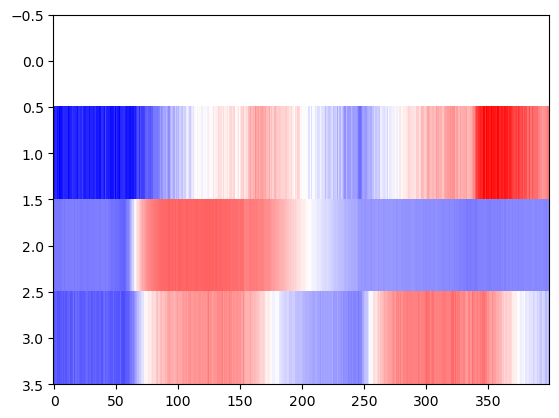

In [1501]:
subcluster_timecourses_neda = np.zeros((np.max(hdbs_id_neda.labels_)+2,CY_matched_raw_corr_norm1_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:9]):np.sum(lcounts_id[1,0:10])],500:900].shape[1]))
for clu in range(0,np.max(hdbs_id_neda.labels_)+2):
    subcluster_timecourses_neda[clu,:] = np.mean(np.vstack((CY_matched_raw_corr_norm1_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],500:900],CY_matched_raw_corr_norm1_sum_id[np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:14]):np.sum(lcounts_id[1,0:15])],500:900]))[hdbs_id_neda.labels_==clu-1,...],axis=0)
plt.imshow(subcluster_timecourses_neda, interpolation='nearest',aspect='auto',cmap='bwr')

In [1564]:
# DA sensor rows
da_rows = np.hstack((np.hstack((np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:14]):np.sum(lcounts_id[1,0:15])]))[hdbs_id_neda.labels_==0,...],
np.hstack((np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:14]):np.sum(lcounts_id[1,0:15])]))[hdbs_id_neda.labels_==2,...]))

In [1565]:
# NE sensor rows
ne_rows = np.setdiff1d(np.hstack((np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:10]):np.sum(lcounts_id[1,0:11])],np.argsort(hdbs_id.labels_)[np.sum(lcounts_id[1,0:14]):np.sum(lcounts_id[1,0:15])])),da_rows)

In [1566]:
# all other sensor rows - each type of row present in at least 4 movies (up to 9)
cck_rows = np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==1,...]
atp_rows = np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==3,...]
oxt_rows = np.hstack((np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==4,...],np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==7,...],np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==8,...][[1,14,18]]))
ht5_rows =  np.hstack((np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==5,...],np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==6,...]))
avp_rows = np.delete(np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==8,...],[1,14,18])
ach_rows = np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==12,...]
mt_rows = np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==14,...]
ha_rows = np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==15,...]

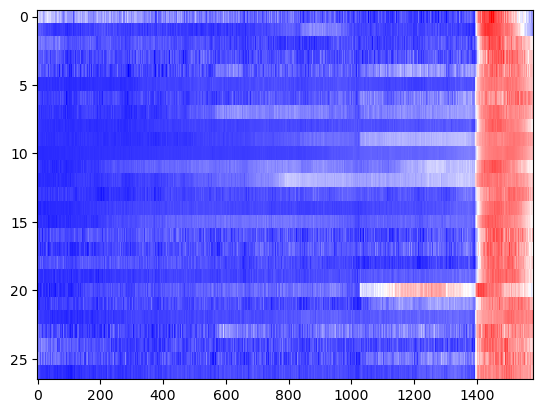

In [1561]:
c=15
plt.imshow(CY_matched_raw_corr_norm1_sum_id[np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==c],...], interpolation='nearest',aspect='auto',cmap='bwr')

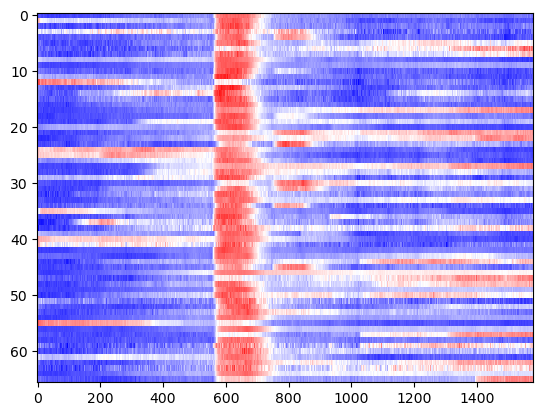

In [1551]:
c=9
plt.imshow(CY_matched_raw_corr_norm1_sum_id[np.delete(np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==c],[1,14,18]),...], interpolation='nearest',aspect='auto',cmap='bwr')

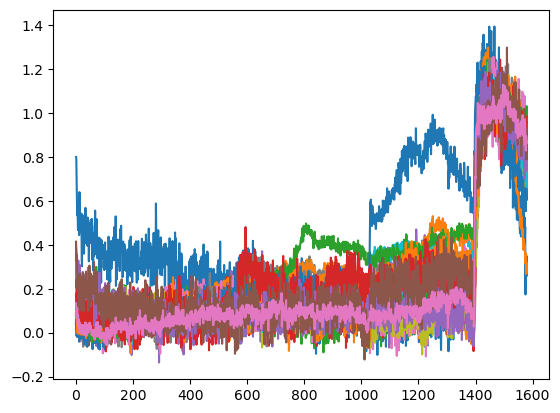

In [1562]:
plt.plot(CY_matched_raw_corr_norm1_sum_id[np.arange(CY_matched_raw_corr_norm1_sum_id.shape[0])[hdbs_id.labels_==c],...].T)

In [1576]:
np.unique([mov_group[i] for i in avp_rows.tolist()]).shape[0]

6

In [2349]:
[mov_group[i] for i in ht5_rows.tolist()]

[9, 9, 10, 2, 2, 2, 2, 4, 6, 8, 8, 8]

In [1569]:
[mov_ids[i] for i in cck_rows.tolist() if mov_group[i]==l]

[]

In [2284]:
#keeping l=1-10
l=6
da_rows_l = [mov_ids[i] for i in da_rows.tolist() if mov_group[i]==l]
ne_rows_l = [mov_ids[i] for i in ne_rows.tolist() if mov_group[i]==l]
cck_rows_l = [mov_ids[i] for i in cck_rows.tolist() if mov_group[i]==l]
atp_rows_l = [mov_ids[i] for i in atp_rows.tolist() if mov_group[i]==l]
ht5_rows_l = [mov_ids[i] for i in ht5_rows.tolist() if mov_group[i]==l]
oxt_rows_l = [mov_ids[i] for i in oxt_rows.tolist() if mov_group[i]==l]
avp_rows_l = [mov_ids[i] for i in avp_rows.tolist() if mov_group[i]==l]
ach_rows_l = [mov_ids[i] for i in ach_rows.tolist() if mov_group[i]==l]
mt_rows_l = [mov_ids[i] for i in mt_rows.tolist() if mov_group[i]==l]
ha_rows_l = [mov_ids[i] for i in ha_rows.tolist() if mov_group[i]==l]

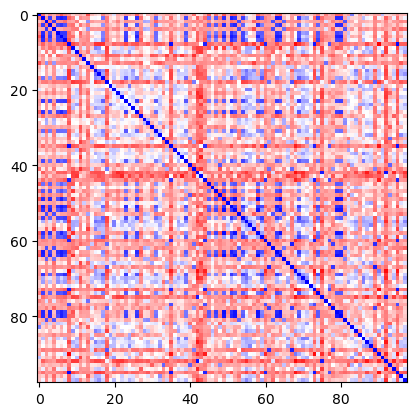

In [2285]:
plt.imshow(squareform(pdist(cnmf_dicts_id[l]['savs_nc'],'correlation')), interpolation='nearest',cmap='bwr')

[[-1  0  1  2  3  4  5]
 [24  3  8  7  7 44  5]]


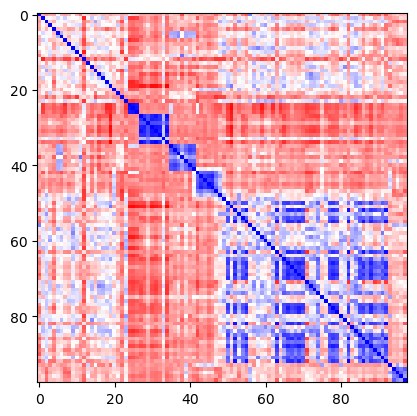

In [2286]:
hdbs_id_l = HDBSCAN(min_cluster_size = 3,metric='precomputed')
hdbs_id_l.fit(squareform(pdist(cnmf_dicts_id[l]['savs_nc'],'correlation')))
#hdbs.fit(savs_nc)
lcounts_id_l = np.array(np.unique(hdbs_id_l.labels_, return_counts=True))
print(lcounts_id_l)
plt.imshow(squareform(pdist(cnmf_dicts_id[l]['savs_nc'][np.argsort(hdbs_id_l.labels_),...],'correlation')), interpolation='nearest',cmap='bwr')

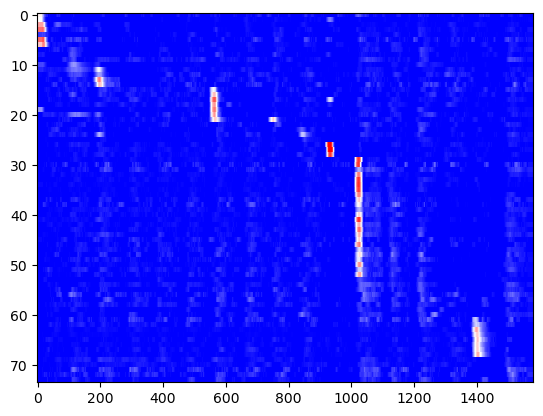

In [2287]:
plt.imshow(cnmf_dicts_id[l]['savs_nc'][np.argsort(hdbs_id_l.labels_)[lcounts_id_l[1,0]:],...][np.argsort([np.min(np.where(cnmf_dicts_id[l]['savs_nc'][np.argsort(hdbs_id_l.labels_)[lcounts_id_l[1,0]:],...][i,...] == np.max(cnmf_dicts_id[l]['savs_nc'][np.argsort(hdbs_id_l.labels_)[lcounts_id_l[1,0]:],...][i,...]))) for i in range(cnmf_dicts_id[l]['savs_nc'][np.argsort(hdbs_id_l.labels_)[lcounts_id_l[1,0]:],...].shape[0])]),...], interpolation='nearest',aspect='auto',cmap='bwr',vmin=0,vmax=0.05)

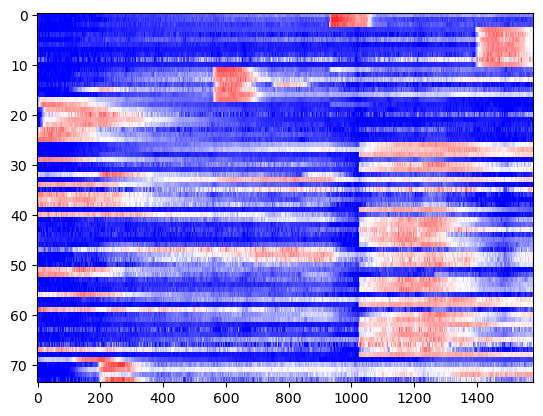

In [2288]:
plt.imshow(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][np.argsort(hdbs_id_l.labels_)[lcounts_id_l[1,0]:],...], interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)

[[ 0.  0.  0.  0.  5.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  1.]
 [ 0.  0.  0.  0.  0.  0.  1.]
 [ 0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  6.  0.  0.  0.]
 [ 0.  0.  0.  1.  0.  0.  0.]
 [ 1.  0.  0.  0.  0.  0.  0.]
 [ 0.  3.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0. 20.  0.]
 [ 0.  0.  6.  0.  0.  0.  0.]]


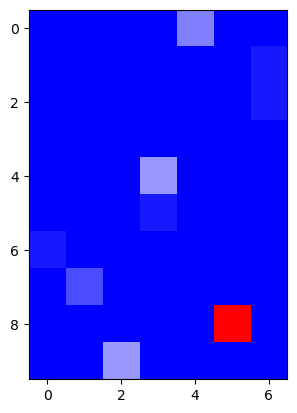

In [2289]:
crosstabs = np.zeros((10,np.unique(hdbs_id_l.labels_).shape[0]))
for c in np.unique(hdbs_id_l.labels_):
    crosstabs[0,c+1] = np.intersect1d(avp_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[1,c+1] = np.intersect1d(oxt_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[2,c+1] = np.intersect1d(ht5_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[3,c+1] = np.intersect1d(cck_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[4,c+1] = np.intersect1d(ne_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[5,c+1] = np.intersect1d(da_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[6,c+1] = np.intersect1d(ach_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[7,c+1] = np.intersect1d(atp_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[8,c+1] = np.intersect1d(mt_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[9,c+1] = np.intersect1d(ha_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
plt.imshow(crosstabs,interpolation='nearest',cmap='bwr')
print(crosstabs)

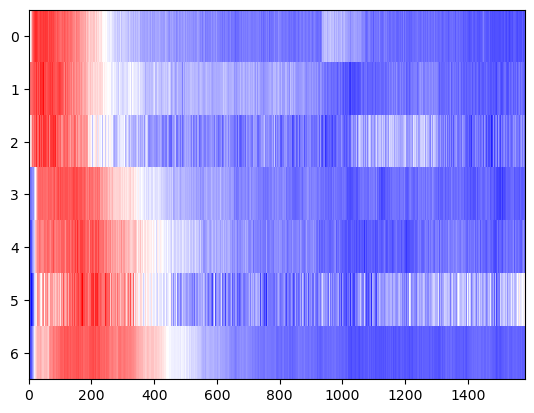

In [2290]:
c = 4-1
cargs = np.argwhere(hdbs_id_l.labels_==c)
plt.imshow(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...],...],interpolation='nearest',aspect='auto',cmap='bwr')

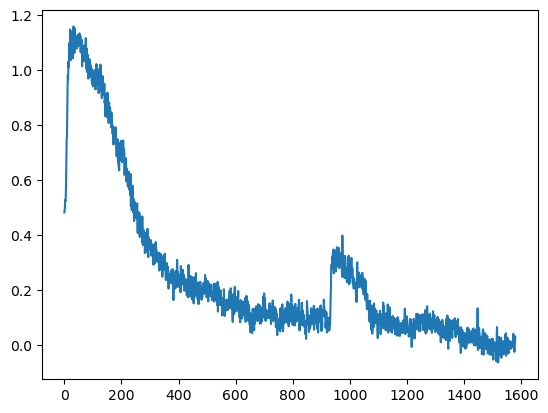

In [2292]:
j = 0
plt.plot(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[cargs,...],...][j].T)

In [1787]:
np.max(hdbs_id_l.labels_)

6

In [1702]:
hdbs_id_l.labels_[cargs[j]]

array([1], dtype=int64)

In [1824]:
hdbs_id_l.labels_[cargs[j]] = 5
hdbs_id_l.labels_[cargs[j]]

array([5], dtype=int64)

In [1370]:
ht5_rows_l += [cargs[j][0]]

In [1371]:
ht5_rows_l

[87]

[[ 0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  2.  0.  0.  0.]
 [ 0.  0.  0.  0.  1.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.]
 [ 0. 12.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.]
 [ 1.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0. 13.]
 [ 0.  0. 13.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.]]


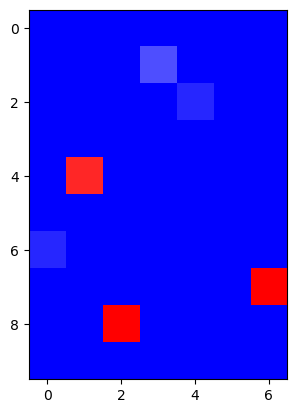

In [1825]:
crosstabs = np.zeros((10,np.unique(hdbs_id_l.labels_).shape[0]))
for c in np.unique(hdbs_id_l.labels_):
    crosstabs[0,c+1] = np.intersect1d(avp_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[1,c+1] = np.intersect1d(oxt_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[2,c+1] = np.intersect1d(ht5_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[3,c+1] = np.intersect1d(cck_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[4,c+1] = np.intersect1d(ne_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[5,c+1] = np.intersect1d(da_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[6,c+1] = np.intersect1d(ach_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[7,c+1] = np.intersect1d(atp_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[8,c+1] = np.intersect1d(mt_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
    crosstabs[9,c+1] = np.intersect1d(ha_rows_l,np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==c,...]).shape[0]
plt.imshow(crosstabs,interpolation='nearest',cmap='bwr')
print(crosstabs)

In [1826]:
cnmf_dicts_id[l]['avp_rows'] = list(set(avp_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[0,1:]==np.max(crosstabs[0,1:]))[0][0],...] if np.max(crosstabs[0,1:]) != 0]))
cnmf_dicts_id[l]['oxt_rows'] = list(set(oxt_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[1,1:]==np.max(crosstabs[1,1:]))[0][0],...] if np.max(crosstabs[1,1:]) != 0]))
cnmf_dicts_id[l]['5ht_rows'] = list(set(ht5_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[2,1:]==np.max(crosstabs[2,1:]))[0][0],...] if np.max(crosstabs[2,1:]) != 0]))
cnmf_dicts_id[l]['cck_rows'] = list(set(cck_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[3,1:]==np.max(crosstabs[3,1:]))[0][0],...] if np.max(crosstabs[3,1:]) != 0]))
cnmf_dicts_id[l]['ne_rows'] = list(set(ne_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[4,1:]==np.max(crosstabs[4,1:]))[0][0],...] if np.max(crosstabs[4,1:]) != 0]))
cnmf_dicts_id[l]['da_rows'] = list(set(da_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[5,1:]==np.max(crosstabs[5,1:]))[0][0],...] if np.max(crosstabs[5,1:]) != 0]))
cnmf_dicts_id[l]['ach_rows'] = list(set(ach_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[6,1:]==np.max(crosstabs[6,1:]))[0][0],...] if np.max(crosstabs[6,1:]) != 0]))
cnmf_dicts_id[l]['atp_rows'] = list(set(atp_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[7,1:]==np.max(crosstabs[7,1:]))[0][0],...] if np.max(crosstabs[7,1:]) != 0]))
cnmf_dicts_id[l]['mt_rows'] = list(set(mt_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[8,1:]==np.max(crosstabs[8,1:]))[0][0],...] if np.max(crosstabs[8,1:]) != 0]))
cnmf_dicts_id[l]['ha_rows'] = list(set(ha_rows_l + [x for x in np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id_l.labels_==np.where(crosstabs[9,1:]==np.max(crosstabs[9,1:]))[0][0],...] if np.max(crosstabs[9,1:]) != 0]))

In [1622]:
# if no clusters (l=1):
cnmf_dicts_id[l]['avp_rows'] = avp_rows_l
cnmf_dicts_id[l]['oxt_rows'] = oxt_rows_l
cnmf_dicts_id[l]['5ht_rows'] = ht5_rows_l
cnmf_dicts_id[l]['cck_rows'] = cck_rows_l
cnmf_dicts_id[l]['ne_rows'] = ne_rows_l
cnmf_dicts_id[l]['da_rows'] = da_rows_l
cnmf_dicts_id[l]['ach_rows'] = ach_rows_l
cnmf_dicts_id[l]['atp_rows'] = atp_rows_l
cnmf_dicts_id[l]['mt_rows'] = mt_rows_l
cnmf_dicts_id[l]['ha_rows'] = ha_rows_l

In [1718]:
# fix 5ht cluster (l=5):
cnmf_dicts_id[l]['5ht_rows'] = np.argwhere(hdbs_id_l.labels_==9).tolist()[0]

In [1827]:
print(cnmf_dicts_id[l]['avp_rows'])
print(cnmf_dicts_id[l]['oxt_rows'])
print(cnmf_dicts_id[l]['5ht_rows'])
print(cnmf_dicts_id[l]['cck_rows'])
print(cnmf_dicts_id[l]['ne_rows'])
print(cnmf_dicts_id[l]['da_rows'])
print(cnmf_dicts_id[l]['ach_rows'])
print(cnmf_dicts_id[l]['atp_rows'])
print(cnmf_dicts_id[l]['mt_rows'])
print(cnmf_dicts_id[l]['ha_rows'])

[]
[8, 16, 51, 21, 30]
[96, 67, 37, 70, 40, 46, 83]
[]
[0, 32, 65, 90, 39, 10, 11, 76, 13, 47, 81, 17, 19, 82, 53, 24, 58]
[]
[1]
[2, 36, 69, 41, 42, 92, 20, 87, 25, 26, 28, 94, 63]
[6, 9, 15, 22, 23, 27, 34, 35, 43, 48, 50, 52, 61, 62, 77, 79, 85, 88, 91, 93]
[]


In [492]:
plt.imshow(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['avp_rows']+cnmf_dicts_id[l]['oxt_rows']+cnmf_dicts_id[l]['5ht_rows']+cnmf_dicts_id[l]['cck_rows']+cnmf_dicts_id[l]['ne_rows']+cnmf_dicts_id[l]['da_rows']+cnmf_dicts_id[l]['ach_rows']+cnmf_dicts_id[l]['atp_rows']+cnmf_dicts_id[l]['mt_rows']+cnmf_dicts_id[l]['ha_rows'],...],interpolation='nearest',aspect='auto',cmap='bwr')

KeyError: 'CY_matched_raw_corr_norm1'

In [1035]:
cell_tally = 0
for l in range(1,len(movie_list_id)):
    cell_tally += (len(cnmf_dicts_id[l]['avp_rows'])+len(cnmf_dicts_id[l]['oxt_rows'])+len(cnmf_dicts_id[l]['5ht_rows'])+len(cnmf_dicts_id[l]['cck_rows'])+len(cnmf_dicts_id[l]['ne_rows'])+len(cnmf_dicts_id[l]['da_rows'])+len(cnmf_dicts_id[l]['ach_rows'])+len(cnmf_dicts_id[l]['atp_rows'])+len(cnmf_dicts_id[l]['mt_rows'])+len(cnmf_dicts_id[l]['ha_rows']))
    print(len(cnmf_dicts_id[l]['avp_rows'])+len(cnmf_dicts_id[l]['oxt_rows'])+len(cnmf_dicts_id[l]['5ht_rows'])+len(cnmf_dicts_id[l]['cck_rows'])+len(cnmf_dicts_id[l]['ne_rows'])+len(cnmf_dicts_id[l]['da_rows'])+len(cnmf_dicts_id[l]['ach_rows'])+len(cnmf_dicts_id[l]['atp_rows'])+len(cnmf_dicts_id[l]['mt_rows'])+len(cnmf_dicts_id[l]['ha_rows']))
cell_tally

5
62
15
38
69
63
19
44
62
62


439

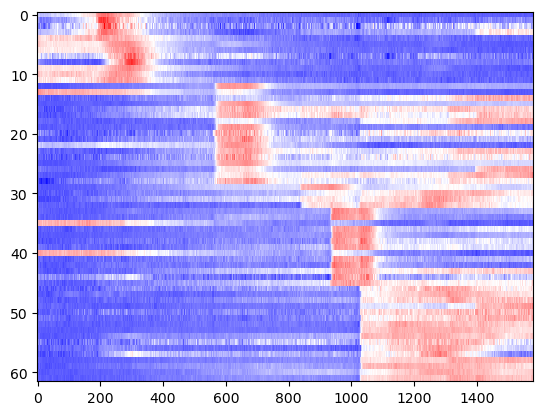

In [1033]:
# double check here that identities are correct - important to backpropagate any cleanup done during bg corrections!
l=10 # review ls: 3 (mt 3-trash?y), 4 (ne 6-da?y), 5 (5ht 0-avp?n, ne 3-da?y, atp 5-trashy), 6 (5ht 0,4-oxt?y, mt 15,16,18-trash?n)
#7 (ach 1-da?y, ha 0-mt?y), 8 (atp 3-trash?n), 9 (5ht 9-avp?y, mt 0,7,18-trash?n), 10 (ach 1,2-trash?n, mt 1-achy,5-trash?y)
plt.imshow(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['avp_rows']+cnmf_dicts_id[l]['oxt_rows']+cnmf_dicts_id[l]['5ht_rows']+cnmf_dicts_id[l]['cck_rows']+cnmf_dicts_id[l]['ne_rows']+cnmf_dicts_id[l]['da_rows']+cnmf_dicts_id[l]['ach_rows']+cnmf_dicts_id[l]['atp_rows']+cnmf_dicts_id[l]['mt_rows']+cnmf_dicts_id[l]['ha_rows'],...],interpolation='nearest',aspect='auto',cmap='bwr')

In [1034]:
print('avp',cnmf_dicts_id[l]['avp_rows'])
print('oxt',cnmf_dicts_id[l]['oxt_rows'])
print('5ht',cnmf_dicts_id[l]['5ht_rows'])
print('cck',cnmf_dicts_id[l]['cck_rows'])
print('ne',cnmf_dicts_id[l]['ne_rows'])
print('da',cnmf_dicts_id[l]['da_rows'])
print('ach',cnmf_dicts_id[l]['ach_rows'])
print('atp',cnmf_dicts_id[l]['atp_rows'])
print('mt',cnmf_dicts_id[l]['mt_rows'])
print('ha',cnmf_dicts_id[l]['ha_rows'])

avp []
oxt [8, 16, 21, 30, 51]
5ht [37, 40, 46, 67, 70, 83, 96]
cck []
ne [0, 10, 11, 13, 17, 19, 24, 32, 39, 47, 53, 58, 65, 76, 81, 82, 90]
da []
ach [1, 22, 43, 9]
atp [2, 20, 25, 26, 28, 36, 41, 42, 63, 69, 87, 92, 94]
mt [6, 15, 23, 27, 35, 48, 50, 52, 61, 62, 77, 79, 85, 88, 91, 93]
ha []


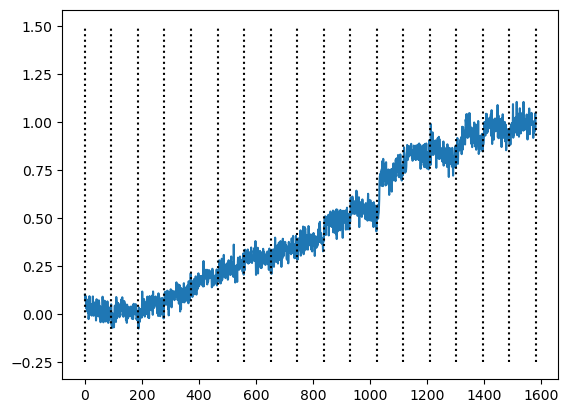

In [1030]:
plt.plot(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['mt_rows'],...][4,...].T)
plt.vlines(x = 93*np.arange(18),ymin=-0.25, ymax=1.5,color='black',linestyle='dotted')

In [1002]:
cnmf_dicts_id[l]['da_rows'] = cnmf_dicts_id[l]['da_rows'] + [cnmf_dicts_id[l]['ach_rows'][1]]
cnmf_dicts_id[l]['ach_rows'] = [cnmf_dicts_id[l]['ach_rows'][i] for i in range(len(cnmf_dicts_id[l]['ach_rows'])) if i !=1]

In [1032]:
cnmf_dicts_id[l]['mt_rows'] = [cnmf_dicts_id[l]['mt_rows'][i] for i in range(len(cnmf_dicts_id[l]['mt_rows'])) if i !=4]

In [972]:
cnmf_dicts_id[l]['atp_rows'] = [cnmf_dicts_id[l]['atp_rows'][i] for i in range(len(cnmf_dicts_id[l]['atp_rows'])) if i !=5]

In [1014]:
cnmf_dicts_id[l]['avp_rows'] = cnmf_dicts_id[l]['avp_rows'] + [cnmf_dicts_id[l]['5ht_rows'][9]]
cnmf_dicts_id[l]['5ht_rows'] = [cnmf_dicts_id[l]['5ht_rows'][i] for i in range(len(cnmf_dicts_id[l]['5ht_rows'])) if i !=9]

In [1006]:
cnmf_dicts_id[l]['mt_rows'] = cnmf_dicts_id[l]['mt_rows'] + [cnmf_dicts_id[l]['ha_rows'][0]]
cnmf_dicts_id[l]['ha_rows'] = [cnmf_dicts_id[l]['ha_rows'][i] for i in range(len(cnmf_dicts_id[l]['ha_rows'])) if i !=0]

In [1028]:
cnmf_dicts_id[l]['ach_rows'] = cnmf_dicts_id[l]['ach_rows'] + [cnmf_dicts_id[l]['mt_rows'][1]]
cnmf_dicts_id[l]['mt_rows'] = [cnmf_dicts_id[l]['mt_rows'][i] for i in range(len(cnmf_dicts_id[l]['mt_rows'])) if i !=1]

In [ ]:
# strategy for matching masks/identities across multiple movies:
# 1. load compmatch files for the whole set of movies for a probe - mask numbers are from merged_refit
# 2. Assign identities to masks in ID movie using ligand_row information determined as below from the clustering
# 3. Propagate these identities to every other movie based on respective compmatch information
# 4. 20230823_PL28,20230915_PL52,20230916_PL54 need propagation back to ref 001 movie, then from there to all other movies
# 5. Use this information for all subsequent movies - e.g. don't even mess with dose movies until IDs are firmly established and saved

In [1036]:
comp_ids = [[]]*len(movie_list_id)
row_ids = [[]]*len(movie_list_id)

In [1037]:
for l in trange(1,len(movie_list_id)):
    warp_dir = os.path.join(cnmf_dicts_id[l]['base_dir'],os.path.split(os.path.dirname(movie_list_id[l]))[1].split('_')[0] + '_' + os.path.split(os.path.dirname(movie_list_id[l]))[1].split('_')[1] + '_rwd')
    compmatches = []
    for path in [x for x in os.listdir(warp_dir) if 'compmatch' in x]:
        compmatches.append(np.load(os.path.join(warp_dir, path),allow_pickle=True)[()])
        
    comps = list(set(chain.from_iterable([x['Mrefs_c'] for x in compmatches])))
    comp_id = np.array([0]*len(comps))
    
    # call ligand id by the following numbers:
    # 1. avp
    # 2. oxt
    # 3. 5ht
    # 4. cck
    # 5. ne
    # 6. da
    # 7. ach
    # 8. atp
    # 9. mt
    # 10. ha
    
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['avp_rows']] for x in y]] = 1
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['oxt_rows']] for x in y]] = 2
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['5ht_rows']] for x in y]] = 3
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['cck_rows']] for x in y]] = 4
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['ne_rows']] for x in y]] = 5
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['da_rows']] for x in y]] = 6
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['ach_rows']] for x in y]] = 7
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['atp_rows']] for x in y]] = 8
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['mt_rows']] for x in y]] = 9
    comp_id[[comps.index(x) for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['ha_rows']] for x in y]] = 10
    comp_ids[l] = list(comp_id)

    # at this point the ids are assigned to each component of the id movie - in all but 0,1,3 this is 001 ref movie for all other clicks

    # to do - dictionary matching rows (i.e. components) across movies and propagating ids - in 0,1,3 additional step of transferring to 001 movie
    
    # issue - components may be matched slightly differently in ref movie when clicked against different mov movies
    ## one solution - keep the union (e.g. trust all matches), another solution - keep the intersection (e.g. only matches that are confirmed every time)
    ## maybe best is to keep the mode! or - maybe the best is to trust the id-dose responses clicking since it probably had best driven mov components?
    ## how much of a problem is this? can it be assessed? what if a component is matched to different partners in different clicks?
    ## in case of different partners in different clicks, there is the possibility of mismatched ids also
    ## or - if components are merged in one clicking but kept apart in another - merge them in that one? would need to recalculate CNMF raw...
    ## does matching cell-by-cell really matter much beyond inheriting ids? any analyses ever where exact same cell has to be compared?
    
    # how about - each compmatch has comp_ids for ref and mov comps - mov comp_ids inherit from ref via matches - then only issue is off-id matches
    ## how to negotiate these? probably core match is most trustworthy (also traces cleaned by clustering)
    ## then these matches must be wrong and id cannot be reliably propagated - unless one component clearly dominant??
    ## best measure of dominance is correlation with merged signal - e.g. component's signal from ['CY'] correlated with group's ['CY_matched']!
    
    # so the logical flow goes:
    # 1. propagate ids from cells 'CY_matched_raw' to their subcomponents 'CY'
    # 2. (0,1,3 only) if ids are in mov - propagate them from mov's 'CY' to ref(001)'s 'CY' and 'CY_matched_raw' (unambiguous) - already done
    # 3. propagate ids from ref subcomponents 'CY' to each ref/mov's 'CY_matched_raw' - and if off-id ref subcomponents are ever merged, pick id of 
        # subcomponent in ref 'CY' that is most correlated with corresponding ref 'CY_matched'
    
    # as far as keeping track of all of these across movies - keep careful dictionaries:
    ## in the end - want the ids of the 'CY_matched_raw' rows - but for the ref movie, also need to keep subcomponent ids
    ## so basically, just need to make one list of subcomponent ids for 001 movie on 'CY' plus two lists of ref/mov component ids on 'CY_matched_raw' for every match
    ### don't worry about "chain matches" for now (e.g. matching cell-by-cell from mov 2 to mov 4 via ref 001) - although they're possible

    row_id_l = []
    for i in range(len(compmatches)):
        row_id = np.array([0]*len(compmatches[i]['Mrefs']))
        if i == pythonic_list_id[l]: # take directly from clustering
            row_id[cnmf_dicts_id[l]['avp_rows']] = 1
            row_id[cnmf_dicts_id[l]['oxt_rows']] = 2
            row_id[cnmf_dicts_id[l]['5ht_rows']] = 3
            row_id[cnmf_dicts_id[l]['cck_rows']] = 4
            row_id[cnmf_dicts_id[l]['ne_rows']] = 5
            row_id[cnmf_dicts_id[l]['da_rows']] = 6
            row_id[cnmf_dicts_id[l]['ach_rows']] = 7
            row_id[cnmf_dicts_id[l]['atp_rows']] = 8
            row_id[cnmf_dicts_id[l]['mt_rows']] = 9
            row_id[cnmf_dicts_id[l]['ha_rows']] = 10
        else: # propagate from 001 subcomps
            # first need to load the necessary cnmf stuff!
            cnmf_dict_i = {
                'base_dir': cnmf_dicts_id[l]['base_dir'],
                'cnmf_path': cnmf_dicts_id[l]['cnmf_path'],
                'cnmf': list(),
                'spcomps': list(),
                'CY': list(),
                'cnmf_matched_path': list(),
                'cnmf_matched': list(),
                'spcomps_matched': list(),
                'CY_matched': list(),
                'cnmf_matched_path_raw': list(),
                'cnmf_matched_raw': list(),
                'spcomps_matched_raw': list(),
                'CY_matched_raw': list()
            }
        
            if i==0:
                cnmf_dict_i['cnmf_matched_path'] = os.path.join(movie_list_full[l][0], f'ch0_means_movie_nobg_cnmf_merged_refit_matched.hdf5')
            else:
                cnmf_dict_i['cnmf_matched_path'] = os.path.join(movie_list_full[l][0], f'ch0_means_movie_nobg_cnmf_merged_refit_matched{i:01}.hdf5')
                        
            # CNMFE model
            cnmf_dict_i['cnmf_matched'] = cnmf.load_CNMF(cnmf_dict_i['cnmf_matched_path'], 
                                        n_processes=1,
                                        dview=None)
            
            cnmf_dict_i['CY_matched'] = cnmf_dict_i['cnmf_matched'].estimates.C + cnmf_dict_i['cnmf_matched'].estimates.YrA # temporal loadings
    
            row_id = np.array([0]*len(compmatches[i]['Mrefs']))
            for j in range(len(compmatches[i]['Mrefs'])):
                ids = [comp_id[comps.index(x)] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]
                if len(ids) !=0:
                    if np.unique(ids).shape[0] == 1:
                        row_id[j] = ids[0]
                    else:
                        CY_subs = [cnmf_dicts_id[l]['CY'][comps.index(x),:] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]
                        CY_cell = cnmf_dict_i['CY_matched'][j]
                        pear_vals = np.array([scipy.stats.pearsonr(x,CY_cell) for x in CY_subs])
                        row_id[j] = ids[np.where(pear_vals==np.max(pear_vals))[0][0]]
            
        row_id_l.append(list(row_id))
    row_ids[l] = row_id_l

  0%|          | 0/10 [00:00<?, ?it/s]

In [1038]:
# save all the outputs for easy use! FINALIZED 9/10/2024
save_path_m = r'H:\CNMFoutputs\peter\mask_matching\movie_list_full_dipping.pickle'
save_path_c = r'H:\CNMFoutputs\peter\mask_matching\comp_ids_dipping.pickle'
save_path_r = r'H:\CNMFoutputs\peter\mask_matching\row_ids_dipping.pickle'

with open(save_path_m, 'wb') as f:
    pickle.dump(movie_list_full, f)
    
with open(save_path_c, 'wb') as f:
    pickle.dump(comp_ids, f)

with open(save_path_r, 'wb') as f:
    pickle.dump(row_ids, f)

In [1633]:
os.path.dirname(cnmf_dicts_id[l]['cnmf_path'])

'H:\\CNMFoutputs\\peter\\mask_matching\\20230927_PL58_done\\20230927_PL58_wells001_david_done_qc_doneqc'

In [1039]:
# FINALIZED 9/10/2024
for l in trange(1,len(movie_list_full)):
    save_dir = os.path.split(os.path.dirname(cnmf_dicts_id[l]['cnmf_path']))[0]
    save_dict = {k: cnmf_dicts_id[l][k] for k in ('avp_rows', 'oxt_rows', '5ht_rows', 'cck_rows', 'ne_rows', 'da_rows', 'ach_rows', 'atp_rows', 'mt_rows', 'ha_rows')}
    save_path = os.path.join(save_dir, 'id_movie_row_ids.pickle')
    with open(save_path, 'wb') as f:
        pickle.dump(save_dict, f)

  0%|          | 0/10 [00:00<?, ?it/s]

In [222]:
# load back
save_path_m = r'H:\CNMFoutputs\peter\mask_matching\movie_list_full_dipping.pickle'
save_path_c = r'H:\CNMFoutputs\peter\mask_matching\comp_ids_dipping.pickle'
save_path_r = r'H:\CNMFoutputs\peter\mask_matching\row_ids_dipping.pickle'

movie_list_full = load_pickle(save_path_m)
comp_ids = load_pickle(save_path_c)
row_ids = load_pickle(save_path_r)

In [166]:
for l in trange(1,len(movie_list_full)):
    save_dir = os.path.split(os.path.dirname(cnmf_dicts_id[l]['cnmf_path']))[0]
    save_path = os.path.join(save_dir, 'id_movie_row_ids.pickle')
    load_dict = load_pickle(save_path)
    cnmf_dicts_id[l].update(load_dict)

  0%|          | 0/10 [00:00<?, ?it/s]

In [226]:
row_id = np.array([0]*len(compmatches[i]['Mrefs']))
        if i == pythonic_list_id[l]: # take directly from clustering
            row_id[cnmf_dicts_id[l]['avp_rows']] = 1
            row_id[cnmf_dicts_id[l]['oxt_rows']] = 2
            row_id[cnmf_dicts_id[l]['5ht_rows']] = 3
            row_id[cnmf_dicts_id[l]['cck_rows']] = 4
            row_id[cnmf_dicts_id[l]['ne_rows']] = 5
            row_id[cnmf_dicts_id[l]['da_rows']] = 6
            row_id[cnmf_dicts_id[l]['ach_rows']] = 7
            row_id[cnmf_dicts_id[l]['atp_rows']] = 8
            row_id[cnmf_dicts_id[l]['mt_rows']] = 9
            row_id[cnmf_dicts_id[l]['ha_rows']] = 10

[[9,
  0,
  4,
  3,
  7,
  0,
  5,
  9,
  9,
  0,
  1,
  1,
  8,
  5,
  0,
  0,
  0,
  0,
  0,
  4,
  4,
  7,
  9,
  5,
  9,
  5,
  0,
  0,
  3,
  9,
  9,
  0,
  7,
  5,
  9,
  5,
  4,
  3,
  0,
  7,
  9,
  0,
  0,
  0,
  0,
  1,
  8,
  3,
  5,
  0,
  9,
  5,
  0,
  7,
  0,
  2,
  0,
  0,
  4,
  0,
  0,
  0,
  9,
  9,
  0,
  8,
  1,
  8,
  0,
  7,
  9,
  0,
  9,
  0,
  9,
  5,
  0,
  7,
  0,
  9,
  1,
  0,
  0,
  0,
  0,
  9,
  0,
  9,
  0,
  9,
  9,
  0,
  7,
  0,
  0,
  0,
  8,
  0,
  6,
  0,
  9,
  0,
  0,
  3,
  0,
  2,
  0,
  2]]

In [230]:
np.where(np.array(row_ids[1][pythonic_list_id[1]])==7)

(array([ 1, 16], dtype=int64),)

In [232]:
for l in trange(1,len(movie_list_full)):
    cnmf_dicts_id[l]['avp_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==1)[0].tolist()
    cnmf_dicts_id[l]['oxt_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==2)[0].tolist()
    cnmf_dicts_id[l]['5ht_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==3)[0].tolist()
    cnmf_dicts_id[l]['cck_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==4)[0].tolist()
    cnmf_dicts_id[l]['ne_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==5)[0].tolist()
    cnmf_dicts_id[l]['da_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==6)[0].tolist()
    cnmf_dicts_id[l]['ach_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==7)[0].tolist()
    cnmf_dicts_id[l]['atp_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==8)[0].tolist()
    cnmf_dicts_id[l]['mt_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==9)[0].tolist()
    cnmf_dicts_id[l]['ha_rows'] = np.where(np.array(row_ids[l][pythonic_list_id[l]])==10)[0].tolist()

  0%|          | 0/10 [00:00<?, ?it/s]

In [ ]:
# summary figures and dose response deep dive

In [1044]:
all_ids_norm1 = np.zeros((0,cnmf_dicts_id[1]['CY_matched_raw'].shape[1]))
all_ids_savs = np.zeros((0,cnmf_dicts_id[1]['savs_nc'].shape[1]))
prob_nums = []
id_nums = []
for l in trange(1,len(movie_list_full)):
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['avp_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['oxt_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['5ht_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['cck_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['ne_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['da_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['ach_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['atp_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['mt_rows'],...]))
    all_ids_norm1 = np.vstack((all_ids_norm1,cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['ha_rows'],...]))
    
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['avp_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['oxt_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['5ht_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['cck_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['ne_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['da_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['ach_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['atp_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['mt_rows'],...]))
    all_ids_savs = np.vstack((all_ids_savs,cnmf_dicts_id[l]['savs_nc'][cnmf_dicts_id[l]['ha_rows'],...]))
    
    prob_nums += [l]*(len(cnmf_dicts_id[l]['avp_rows'])+
                     len(cnmf_dicts_id[l]['oxt_rows'])+
                     len(cnmf_dicts_id[l]['5ht_rows'])+
                     len(cnmf_dicts_id[l]['cck_rows'])+
                     len(cnmf_dicts_id[l]['ne_rows'])+
                     len(cnmf_dicts_id[l]['da_rows'])+
                     len(cnmf_dicts_id[l]['ach_rows'])+
                     len(cnmf_dicts_id[l]['atp_rows'])+
                     len(cnmf_dicts_id[l]['mt_rows'])+
                     len(cnmf_dicts_id[l]['ha_rows']))
    id_nums += [1]*len(cnmf_dicts_id[l]['avp_rows'])+[2]*len(cnmf_dicts_id[l]['oxt_rows'])+[3]*len(cnmf_dicts_id[l]['5ht_rows'])+[4]*len(cnmf_dicts_id[l]['cck_rows'])+[5]*len(cnmf_dicts_id[l]['ne_rows'])+[6]*len(cnmf_dicts_id[l]['da_rows'])+[7]*len(cnmf_dicts_id[l]['ach_rows'])+[8]*len(cnmf_dicts_id[l]['atp_rows'])+[9]*len(cnmf_dicts_id[l]['mt_rows'])+[10]*len(cnmf_dicts_id[l]['ha_rows'])

print(all_ids.shape)
print(all_ids_savs.shape)

  0%|          | 0/10 [00:00<?, ?it/s]

(439, 1581)
(439, 1581)


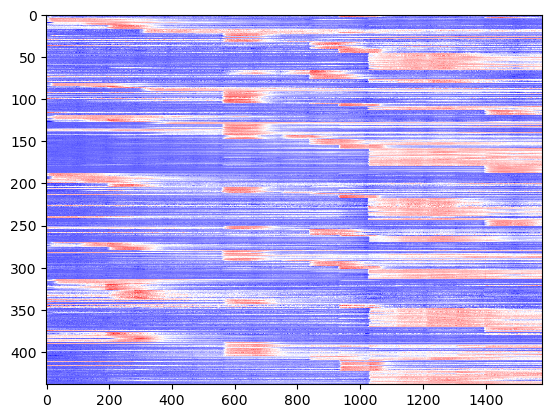

In [1041]:
plt.imshow(all_ids_norm1,interpolation='nearest',aspect='auto',cmap='bwr')

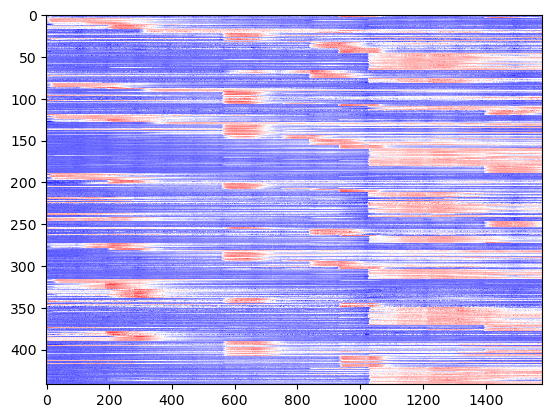

In [749]:
plt.imshow(all_ids_norm1_c,interpolation='nearest',aspect='auto',cmap='bwr')

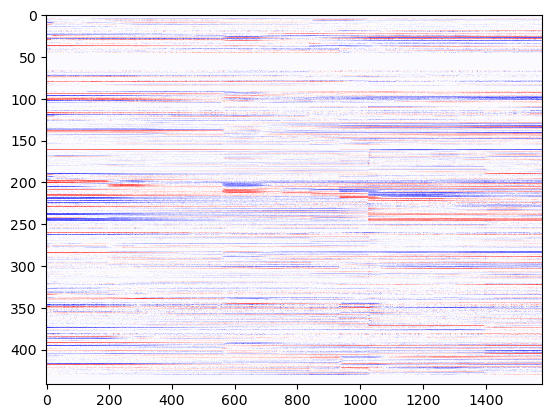

In [755]:
plt.imshow(all_ids_norm1-all_ids_norm1_c,interpolation='nearest',aspect='auto',cmap='bwr')

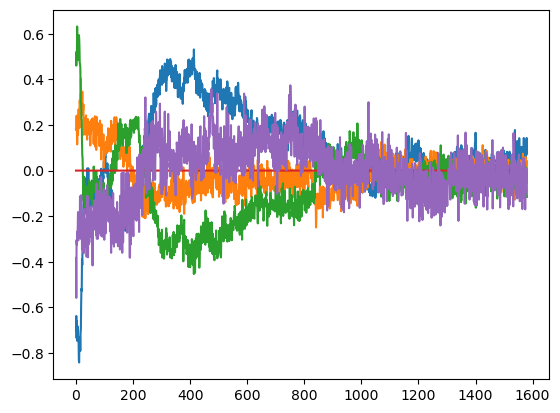

In [760]:
plt.plot((all_ids_norm1-all_ids_norm1_c)[10:15,...].T)

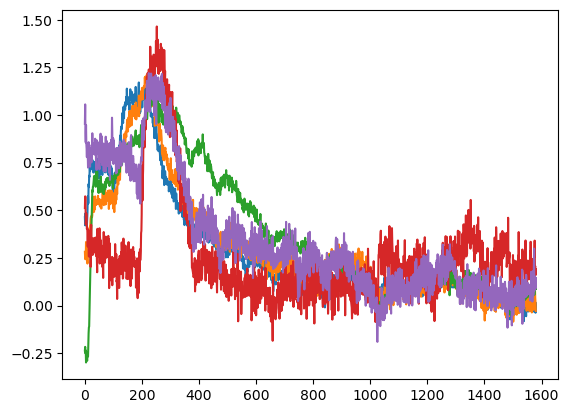

In [761]:
plt.plot(all_ids_norm1_c[10:15,...].T)

In [763]:
prob_nums = []
id_nums = []
for l in trange(1,len(movie_list_full)):    
    prob_nums += [l]*(len(cnmf_dicts_id[l]['avp_rows'])+
                     len(cnmf_dicts_id[l]['oxt_rows'])+
                     len(cnmf_dicts_id[l]['5ht_rows'])+
                     len(cnmf_dicts_id[l]['cck_rows'])+
                     len(cnmf_dicts_id[l]['ne_rows'])+
                     len(cnmf_dicts_id[l]['da_rows'])+
                     len(cnmf_dicts_id[l]['ach_rows'])+
                     len(cnmf_dicts_id[l]['atp_rows'])+
                     len(cnmf_dicts_id[l]['mt_rows'])+
                     len(cnmf_dicts_id[l]['ha_rows']))
    id_nums += [1]*len(cnmf_dicts_id[l]['avp_rows'])+[2]*len(cnmf_dicts_id[l]['oxt_rows'])+[3]*len(cnmf_dicts_id[l]['5ht_rows'])+[4]*len(cnmf_dicts_id[l]['cck_rows'])+[5]*len(cnmf_dicts_id[l]['ne_rows'])+[6]*len(cnmf_dicts_id[l]['da_rows'])+[7]*len(cnmf_dicts_id[l]['ach_rows'])+[8]*len(cnmf_dicts_id[l]['atp_rows'])+[9]*len(cnmf_dicts_id[l]['mt_rows'])+[10]*len(cnmf_dicts_id[l]['ha_rows'])


  0%|          | 0/10 [00:00<?, ?it/s]

In [1043]:
all_ids = np.zeros((0,cnmf_dicts_id[1]['CY_matched_raw'].shape[1]))
for l in trange(1,len(movie_list_full)):
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['avp_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['oxt_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['5ht_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['cck_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['ne_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['da_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['ach_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['atp_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['mt_rows'],...]))
    all_ids = np.vstack((all_ids,cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['ha_rows'],...]))

  0%|          | 0/10 [00:00<?, ?it/s]

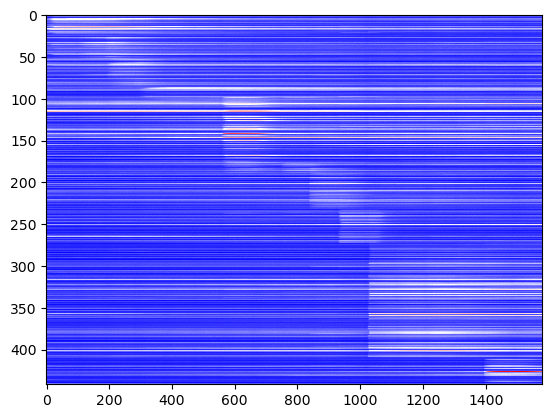

In [787]:
plt.imshow(all_ids[np.argsort(np.array(id_nums)),...],interpolation='nearest',aspect='auto',cmap='bwr')

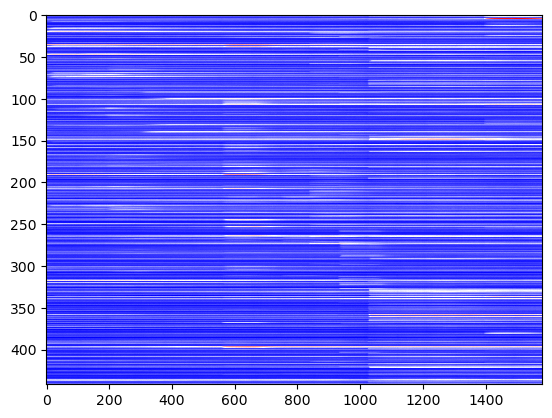

In [237]:
plt.imshow(all_ids[np.argsort(np.array(id_nums)),...],interpolation='nearest',aspect='auto',cmap='bwr')

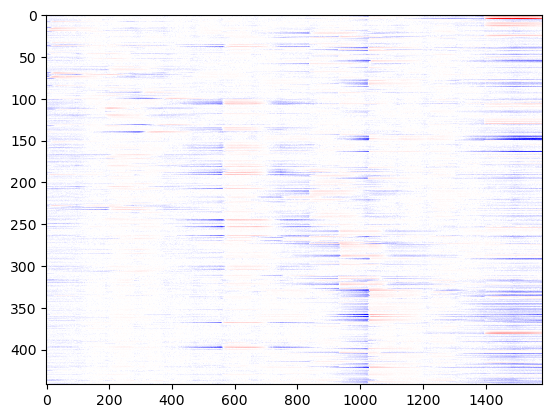

In [478]:
sample_rate = 31/60
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(all_ids.shape[1])/sample_rate

# Apply a 20 Hz high-pass filter to the original data
filtered = all_ids-lowpass(all_ids, 0.001, sample_rate)

from matplotlib import colors
divnorm=colors.TwoSlopeNorm(vcenter=0)
plt.imshow(filtered[np.argsort(np.array(id_nums)),...],interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

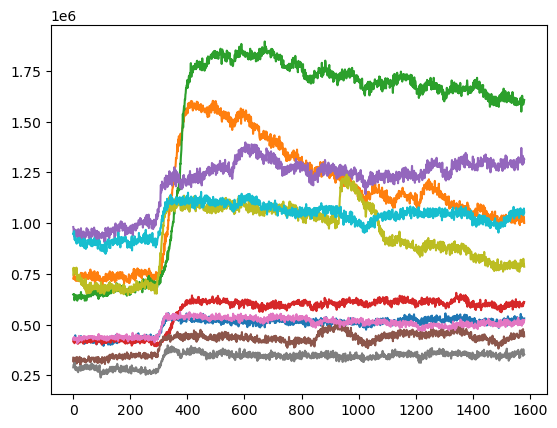

In [3417]:
plt.plot(all_ids[np.argsort(np.array(id_nums)),...][85:95,:].T)

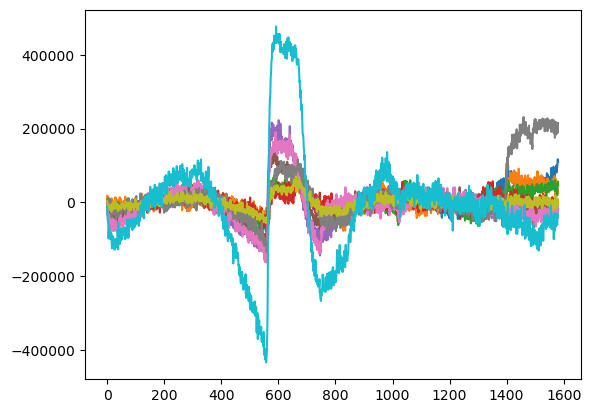

In [3418]:
plt.plot(filtered[np.argsort(np.array(id_nums)),...][160:170,:].T)

In [ ]:
# fit bg subtraction to each individual raw curve - then peak-normalize
# need to save parameters

In [3530]:
all_ids_clean = np.zeros(all_ids.shape)
bg_clean = np.zeros(all_ids.shape)
params_clean = np.zeros((all_ids.shape[0],9)) # 5 fit parameters plus start/end and blstart/blend

In [3531]:
from scipy.optimize import curve_fit
def func(x, a, b, c, d, e):
    return a * np.exp(-b * (x**c)) + d*x + e

In [6011]:
r=462
plt.plot(all_ids[r,...].T)

IndexError: index 462 is out of bounds for axis 0 with size 462

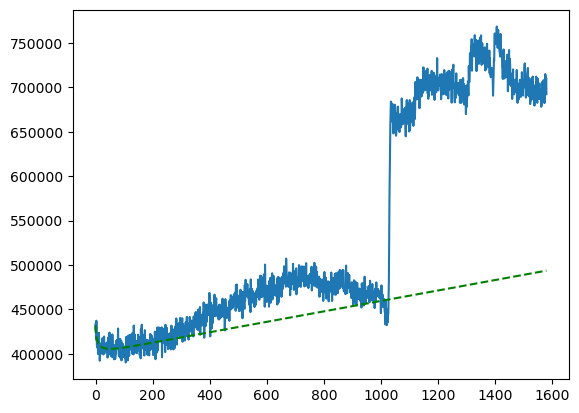

In [6009]:
start = 0
end = 1025#all_ids.shape[1]
blstart = 200#None
blend = 975#None
if blstart is not None:
    xdata = np.hstack((np.arange(start,blstart),np.arange(blend,end)))
else:
    xdata = np.arange(start,end)
popt, pcov = curve_fit(func, xdata, all_ids[r,xdata].T, bounds=([0,0,0,-np.inf,-np.inf], [np.inf,np.inf,1,np.inf,np.inf]), max_nfev = all_ids.shape[1]*10000)
plt.plot(all_ids[r,...].T)
plt.plot(np.arange(all_ids.shape[1]), func(np.arange(all_ids.shape[1]), *popt), 'g--',
         label='fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f, e=%5.3f' % tuple(popt))

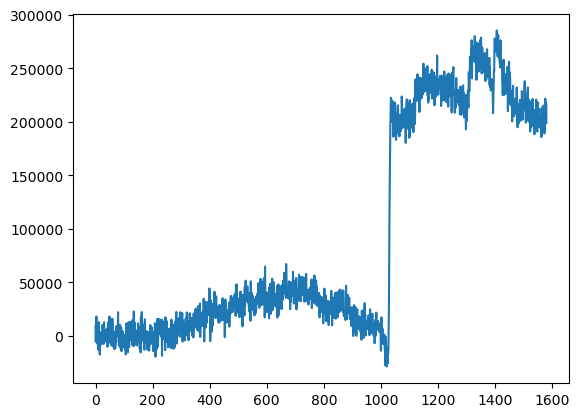

In [6010]:
trash = False
if not trash:
    all_ids_clean[r,...] = all_ids[r,...].T-func(np.arange(all_ids.shape[1]), *popt)
    bg_clean[r,...] = func(np.arange(all_ids.shape[1]), *popt)
    params_clean[r,...] = np.hstack((popt,start,end,blstart,blend))
else:
    all_ids_clean[r,...] = all_ids_clean[r+1,...]
    bg_clean[r,...] = bg_clean[r+1,...]
    params_clean[r,...] = params_clean[r+1,...]
plt.plot(all_ids_clean[r,...].T)

In [6012]:
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids.npy',all_ids)
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids_norm1.npy',all_ids_norm1)
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids_savs.npy',all_ids_savs)
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids_clean.npy',all_ids_clean)
np.save(r'H:\CNMFoutputs\peter\mask_matching\bg_clean.npy',bg_clean)
np.save(r'H:\CNMFoutputs\peter\mask_matching\params_clean.npy',params_clean)

In [1067]:
all_ids_l = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids.npy',allow_pickle=True)
all_ids_norm1 = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids_norm1.npy',allow_pickle=True)
all_ids_savs = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids_savs.npy',allow_pickle=True)
all_ids_clean = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids_clean.npy',allow_pickle=True)
bg_clean = np.load(r'H:\CNMFoutputs\peter\mask_matching\bg_clean.npy',allow_pickle=True)
params_clean = np.load(r'H:\CNMFoutputs\peter\mask_matching\params_clean.npy',allow_pickle=True)

In [7]:
all_ids_norm1.shape

NameError: name 'all_ids_norm1' is not defined

In [179]:
#OLD
all_ids_clean_o = all_ids_clean[np.argsort(np.array(id_nums)),...]
all_ids_clean_c = all_ids_clean[np.mean(all_ids_clean,axis=1)!=0]
all_ids_clean_o_c = all_ids_clean_o[np.mean(all_ids_clean_o,axis=1)!=0]
id_nums_o = np.array(id_nums)[np.argsort(np.array(id_nums))].tolist()
prob_nums_o = np.array(prob_nums)[np.argsort(np.array(id_nums))].tolist()
id_nums_o_c = np.array(id_nums_o)[np.mean(all_ids_clean_o,axis=1)!=0].tolist()
prob_nums_o_c = np.array(prob_nums_o)[np.mean(all_ids_clean_o,axis=1)!=0].tolist()
all_ids_clean_o_c.shape

(422, 1581)

In [746]:
all_ids_clean_c = all_ids_clean[np.mean(all_ids_clean,axis=1)!=0]
all_ids_clean_o_c = all_ids_clean_c[np.argsort(np.array(id_nums)),...]
id_nums_o_c = np.array(id_nums)[np.argsort(np.array(id_nums))].tolist()
prob_nums_o_c = np.array(prob_nums)[np.argsort(np.array(id_nums))].tolist()
all_ids_clean_o_c.shape

(442, 1581)

In [748]:
all_ids_norm1_c = all_ids_norm1[np.mean(all_ids_clean,axis=1)!=0]
all_ids_norm1_c.shape

(442, 1581)

In [479]:
len(id_nums_o_c)

442

In [480]:
all_ids_clean_c.shape

(442, 1581)

(439, 1581)

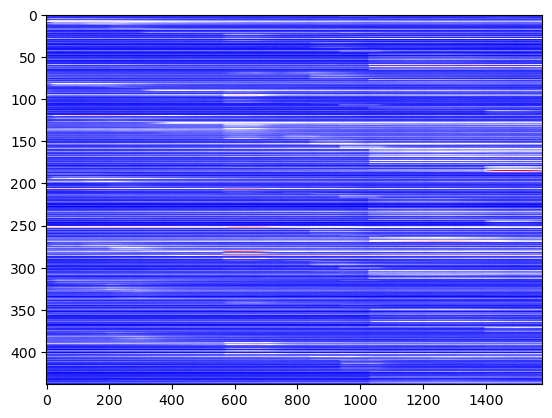

In [1085]:
plt.imshow(all_ids,interpolation='nearest',aspect='auto',cmap='bwr')
all_ids.shape

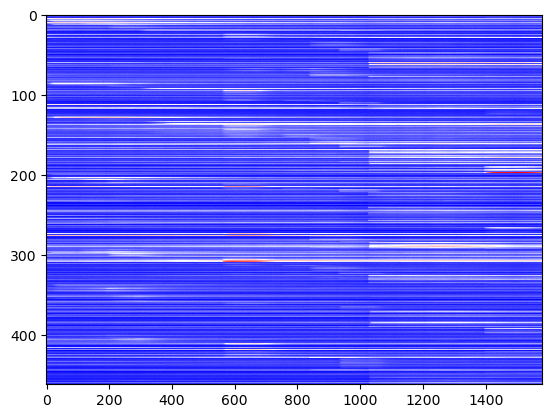

In [1046]:
plt.imshow(all_ids_l,interpolation='nearest',aspect='auto',cmap='bwr')

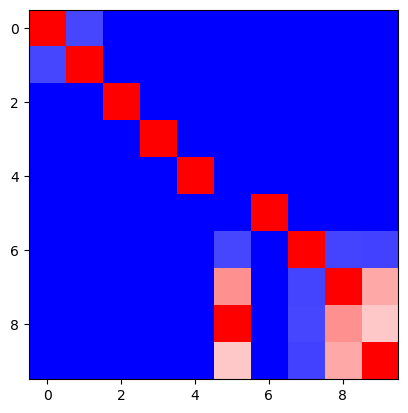

In [1047]:
plt.imshow(cdist(all_ids,all_ids_l,'correlation')[:10,:10], interpolation='nearest',cmap='bwr_r',vmax=0.1)#,norm=divnorm)#,vmax=0.6)

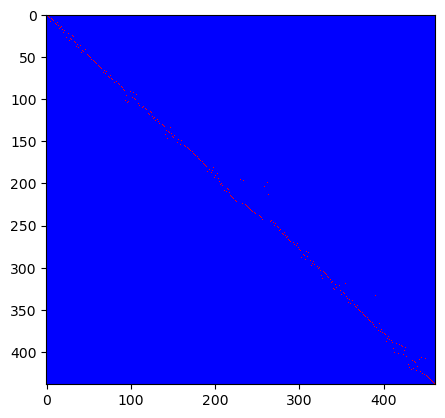

In [1049]:
plt.imshow(cdist(all_ids,all_ids_l,'correlation')<0.001, interpolation='nearest',cmap='bwr')#,vmax=0.1)#,norm=divnorm)#,vmax=0.6)

In [1050]:
cmins = np.min(cdist(all_ids,all_ids_l,'correlation'),axis=0)
cmins.shape

(462,)

In [1051]:
cdists = cdist(all_ids,all_ids_l,'correlation')

In [1052]:
cminargs = []
for i in trange(cmins.shape[0]):
    cminargs += np.where(cdists[:,i]==cmins[i])[0].tolist()

  0%|          | 0/462 [00:00<?, ?it/s]

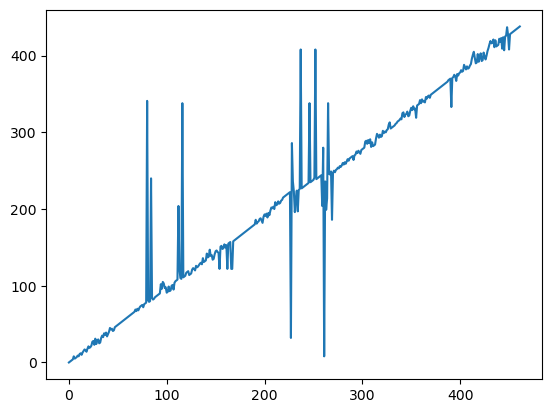

In [1053]:
plt.plot(np.array(cminargs))

In [834]:
cmins[261]

0.023758641095701916

In [1054]:
np.where(cmins>0.00001)[0]

array([ 10,  80,  84, 112, 113, 116, 154, 162, 166, 167, 227, 228, 229,
       237, 246, 251, 252, 260, 261, 262, 265, 269, 448], dtype=int64)

In [1055]:
np.where(np.mean(all_ids_clean,axis=1)==0)[0]

array([ 10,  80, 112, 113, 116, 154, 162, 166, 167, 227, 228, 229, 237,
       246, 251, 252, 260, 262, 265, 269], dtype=int64)

In [1056]:
cutargs = np.union1d(np.where(cmins>0.00001)[0],np.where(np.mean(all_ids_clean,axis=1)==0)[0])
cutargs.shape

(23,)

439

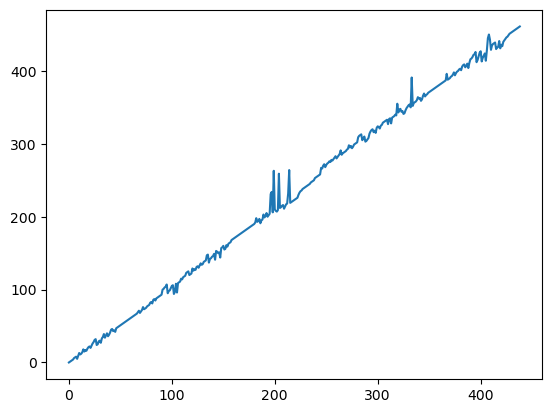

In [1057]:
plt.plot(np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))])
len([i for i in range(len(cminargs)) if i not in cutargs])

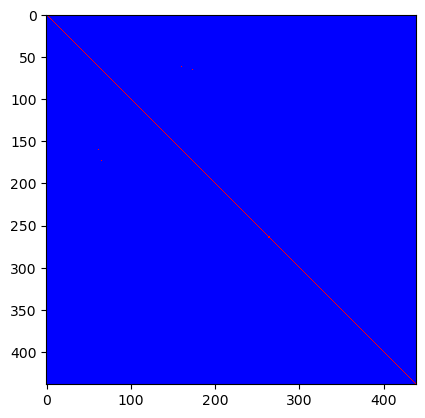

In [1058]:
plt.imshow(cdist(all_ids[[cminargs[i] for i in range(len(cminargs)) if i not in cutargs],...],all_ids_l[[i for i in range(len(cminargs)) if i not in cutargs],...],'correlation')<0.00614472, interpolation='nearest',cmap='bwr')#,vmax=0.1)#,norm=divnorm)#,vmax=0.6)

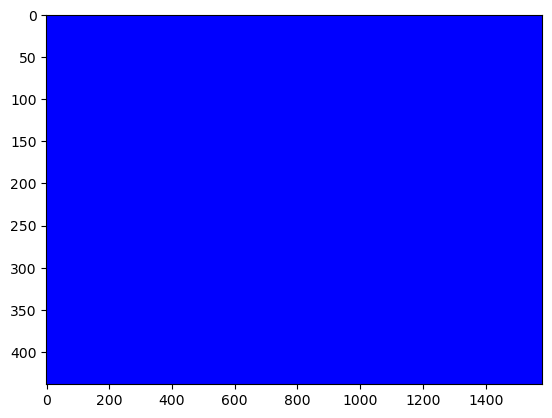

In [1059]:
plt.imshow((all_ids[[cminargs[i] for i in range(len(cminargs)) if i not in cutargs],...]-all_ids_l[[i for i in range(len(cminargs)) if i not in cutargs],...])!=0,interpolation='nearest',aspect='auto',cmap='bwr')

In [1060]:
cdist(all_ids,all_ids_l[[i for i in range(len(cminargs)) if i not in cutargs],...],'correlation').shape

(439, 439)

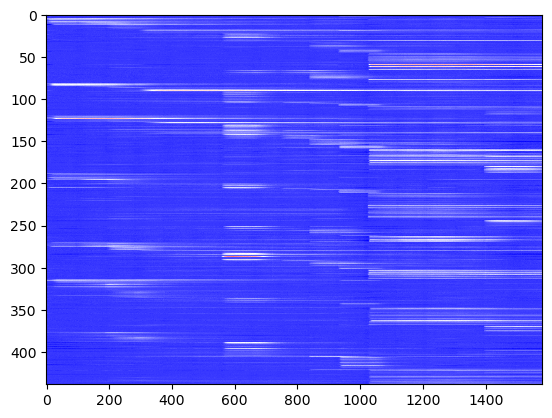

In [1061]:
plt.imshow(all_ids_clean[[i for i in range(len(cminargs)) if i not in cutargs],...],interpolation='nearest',aspect='auto',cmap='bwr')

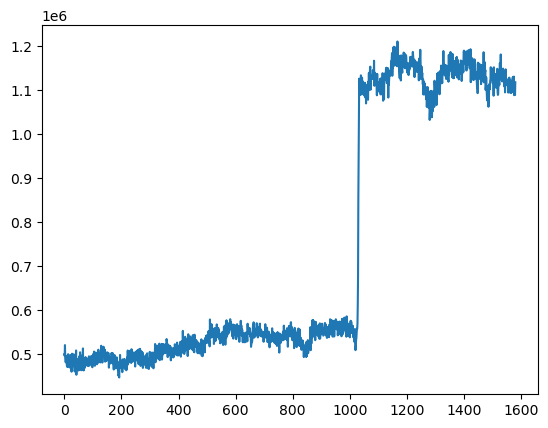

In [823]:
plt.plot(all_ids[162,...].T)

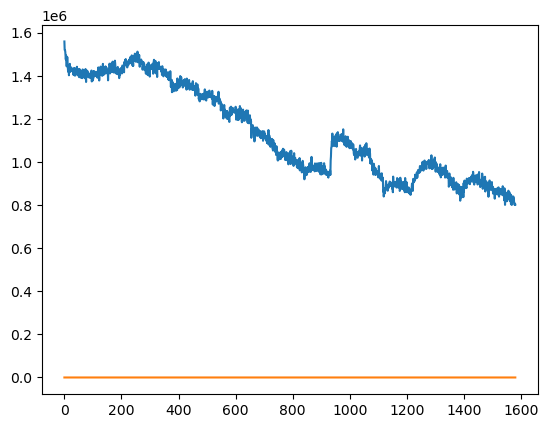

In [830]:
plt.plot(all_ids_l[162,...].T)
plt.plot(all_ids_clean[162,...].T)

In [1065]:
len(cminargs)

462

In [871]:
print(id_nums[cminargs[162]])
print(prob_nums[cminargs[162]])

8
5


In [1063]:
print(len([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))
np.unique(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs])).shape

439


(439,)

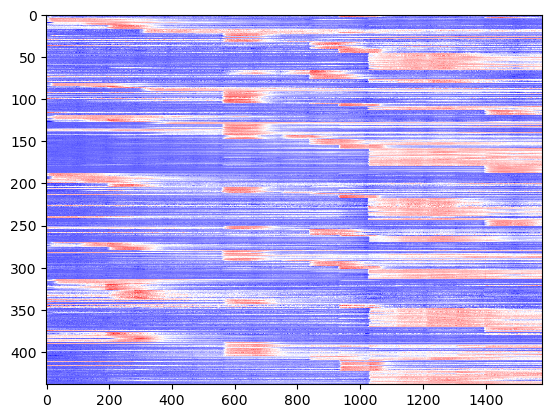

In [1069]:
plt.imshow(all_ids_norm1[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...],interpolation='nearest',aspect='auto',cmap='bwr')

In [892]:
len([id_nums[i] for i in range(len(id_nums)) if i != cminargs[162]]

441

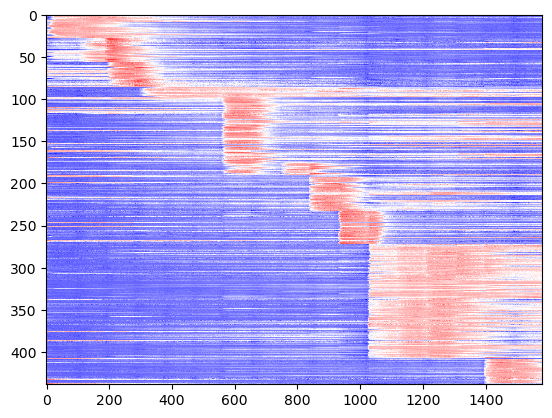

In [1070]:
plt.imshow(all_ids_norm1[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...][np.argsort(np.array(id_nums)),...],interpolation='nearest',aspect='auto',cmap='bwr')

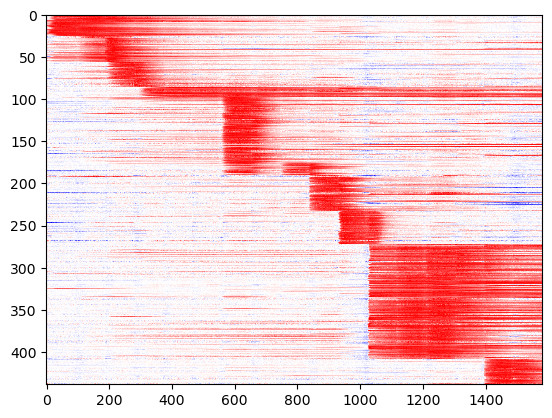

In [1071]:
all_ids_clean_o_c_f_i = all_ids_clean[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...][np.argsort(np.array(id_nums)),...]
plt.imshow((all_ids_clean_o_c_f_i.T/np.max(all_ids_clean_o_c_f_i,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

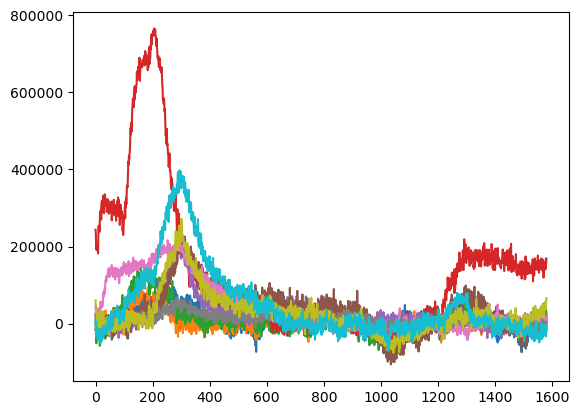

In [946]:
plt.plot(all_ids_clean_o_c_f_i[50:60,...].T)

In [897]:
[i for i in range(len(cminargs)) if i not in cutargs]

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 114,
 115,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 163,
 164,
 165,
 168,
 169,
 170,
 171,
 172,
 173,
 174,
 175,
 176,
 177,
 178,
 179,
 180,
 181,
 182,
 183,
 184,
 185,
 186,
 187,
 188,
 189,
 190,
 191,
 192,
 193

In [ ]:
# at this point, need to finish updating row identities, inherit bg-corrections on ids from first pass of corrs
# also - need to propagate these finalized identities to all the other dipping movies
# finally - incorporate into dose-response dippings while retaining those bg-corrections!
# then - save everything in one confirmed place so there's no more ambiguity!!

# after all this - look into SNR cutoffs on dose-responses, and also repeat all this with the slice dippings
## for slice - careful bg corrections on doses, maybe not as necessary on identities (bandpass seems to have gone ok)

In [ ]:
# first - do the identity swaps and propagate/save them correctly - done
# second - properly save bg-corrected identity dippings with correct probe/sensor identities - done
# third - make sure bg-corrected dose-responses look right
# fourth - play around with SNR cutoffs
# fifth - repeat all from scratch for the slice dippings, get identities from clustering on bandpassed id traces then bg correct doses

In [1087]:
all_ids_l_trim = all_ids_l[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...]
all_ids_norm1_trim = all_ids_norm1[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...]
all_ids_savs_trim = all_ids_savs[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...]
all_ids_clean_trim = all_ids_clean[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...]
bg_clean_trim = bg_clean[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...]
params_clean_trim = params_clean[np.array([i for i in range(len(cminargs)) if i not in cutargs])[np.argsort(np.array([cminargs[i] for i in range(len(cminargs)) if i not in cutargs]))].tolist(),...]

In [1090]:
all_ids_l_trim-all_ids
np.sum(all_ids_l_trim-all_ids)

0.0

In [1092]:
params_clean_trim.shape

(439, 9)

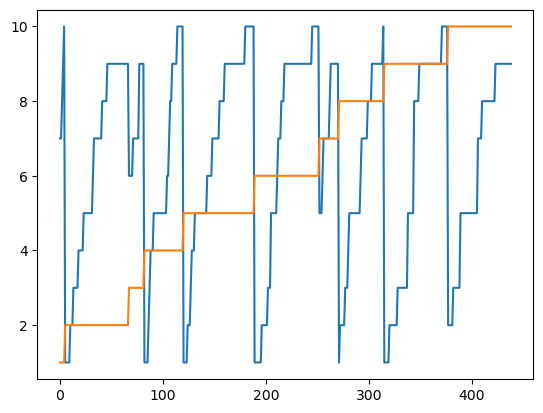

In [1080]:
plt.plot(id_nums)
plt.plot(prob_nums)

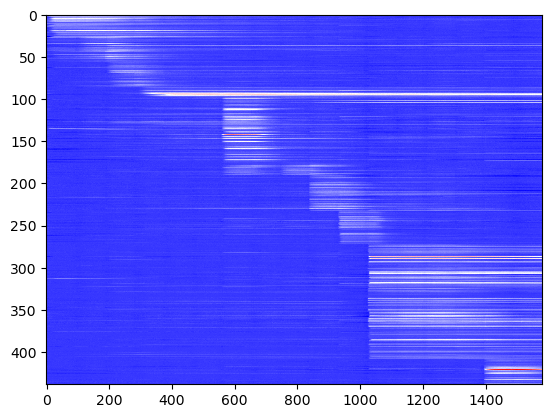

In [1095]:
plt.imshow(all_ids_clean_trim[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')

In [1096]:
# FINALIZED 9/10/2024 - use these for 10-probe 16-sensor ID plots! this is bg-corrected on raw traces - so peak-normalization hasn't been done
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids_trim.npy',all_ids) #all_ids_l_trim is identical
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids_norm1_trim.npy',all_ids_norm1_trim)
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids_savs_trim.npy',all_ids_savs_trim)
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_ids_clean_trim.npy',all_ids_clean_trim)
np.save(r'H:\CNMFoutputs\peter\mask_matching\bg_clean_trim.npy',bg_clean_trim)
np.save(r'H:\CNMFoutputs\peter\mask_matching\params_clean_trim.npy',params_clean_trim)

save_path_i = r'H:\CNMFoutputs\peter\mask_matching\id_nums_trim.pickle'
save_path_p = r'H:\CNMFoutputs\peter\mask_matching\prob_nums_trim.pickle'
    
with open(save_path_i, 'wb') as f:
    pickle.dump(id_nums, f)

with open(save_path_p, 'wb') as f:
    pickle.dump(prob_nums, f)

In [6]:
all_ids = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids_trim.npy',allow_pickle=True)
all_ids_norm1_trim = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids_norm1_trim.npy',allow_pickle=True)
all_ids_savs_trim = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids_savs_trim.npy',allow_pickle=True)
all_ids_clean_trim = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_ids_clean_trim.npy',allow_pickle=True)
bg_clean_trim = np.load(r'H:\CNMFoutputs\peter\mask_matching\bg_clean_trim.npy',allow_pickle=True)
params_clean_trim = np.load(r'H:\CNMFoutputs\peter\mask_matching\params_clean_trim.npy',allow_pickle=True)

save_path_i = r'H:\CNMFoutputs\peter\mask_matching\id_nums_trim.pickle'
save_path_p = r'H:\CNMFoutputs\peter\mask_matching\prob_nums_trim.pickle'

id_nums = load_pickle(save_path_i)
prob_nums = load_pickle(save_path_p)

In [7]:
all_ids_clean_trim_sort = np.sort(all_ids_clean_trim,axis=1)
#all_ids_clean_trim_b10 = np.mean(all_ids_clean_trim_sort[:,:int(np.ceil(all_ids_clean_trim_sort.shape[1]/10))],axis=1) # bottom 10% mean
#all_ids_clean_trim_t10 = np.mean(all_ids_clean_trim_sort[:,-int(np.ceil(all_ids_clean_trim_sort.shape[1]/10)):],axis=1) # top 10% mean
all_ids_clean_trim_b10 = np.mean(all_ids_clean_trim_sort[:,:62],axis=1) # bottom 2 min mean
all_ids_clean_trim_t10 = np.mean(all_ids_clean_trim_sort[:,-62:],axis=1) # top 2 min mean
    
all_ids_clean_trim_norm1 = ((all_ids_clean_trim.T-all_ids_clean_trim_b10)/(all_ids_clean_trim_t10-all_ids_clean_trim_b10)).T

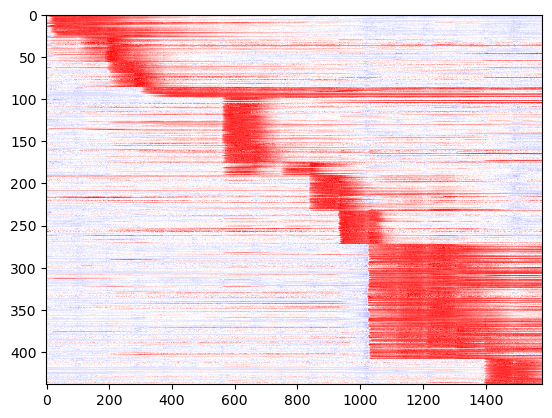

In [8]:
plt.imshow(all_ids_clean_trim_norm1[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr',vmin=-0.9,vmax=1.2)

NameError: name 'all_ids_clean_trim2' is not defined

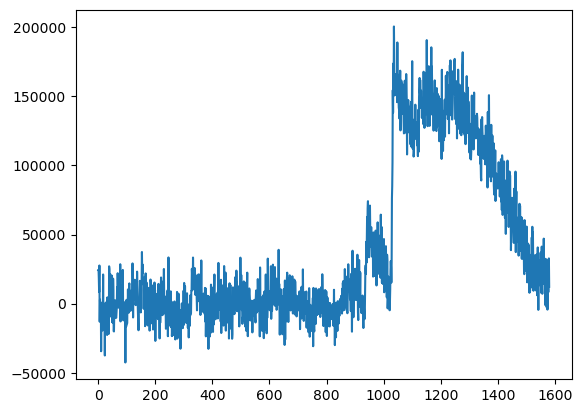

In [9]:
plt.plot(all_ids_clean_trim[355,...])
plt.plot(all_ids_clean_trim2[355,...])

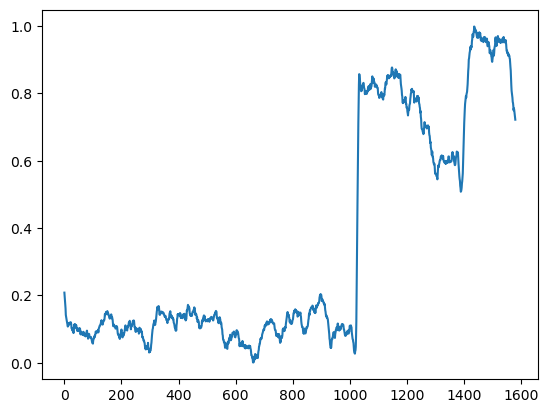

In [10]:
plt.plot(sg.savgol_filter(all_ids_clean_trim_norm1[np.lexsort((prob_nums,id_nums))][310,...],10,1))

In [ ]:
# these ID dippings have already been baseline corrected - so they are the dF as they are
# F0 can be estimated from the bg fit - some kind of mean (decide on specifics - for now just did mean across entire timeline)
# peak normalization just needs to calculate the top 10% (+ median filter to avoid noise issues) - no need for bottom 10%
# finally, for dF/F0 quantifications, think smart about picking the right window (probably just 3rd minute of well as previously)
# as far as savgol derivative calculations - use peak-normalized (properly)
# same for group traces - redo those with correct normalizations

In [11]:
bg_clean_trim.shape

(439, 1581)

In [12]:
all_ids_clean_trim2 = sg.medfilt2d(all_ids_clean_trim,kernel_size=[1,15])
all_ids_clean_trim_sort2 = np.sort(all_ids_clean_trim2,axis=1)
#all_ids_clean_trim_b10 = np.mean(all_ids_clean_trim_sort[:,:int(np.ceil(all_ids_clean_trim_sort.shape[1]/10))],axis=1) # bottom 10% mean
#all_ids_clean_trim_t102 = np.mean(all_ids_clean_trim_sort2[:,-int(np.ceil(all_ids_clean_trim_sort2.shape[1]/10)):],axis=1) # top 10% mean
all_ids_clean_trim_t102 = np.mean(all_ids_clean_trim_sort2[:,-62:],axis=1) # top 2 min mean
    
all_ids_clean_trim_dff = ((all_ids_clean_trim.T)/(np.mean(bg_clean_trim,axis=1))).T
all_ids_clean_trim_norm2 = ((all_ids_clean_trim.T)/(all_ids_clean_trim_t102)).T

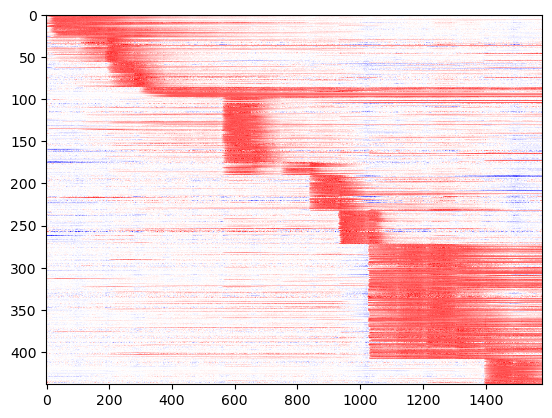

In [13]:
plt.imshow(all_ids_clean_trim_norm2[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1.5,vmax=1.5)

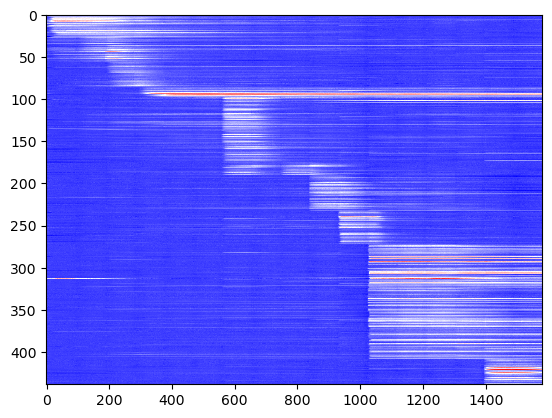

In [14]:
plt.imshow(all_ids_clean_trim_dff[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-1,vmax=1)

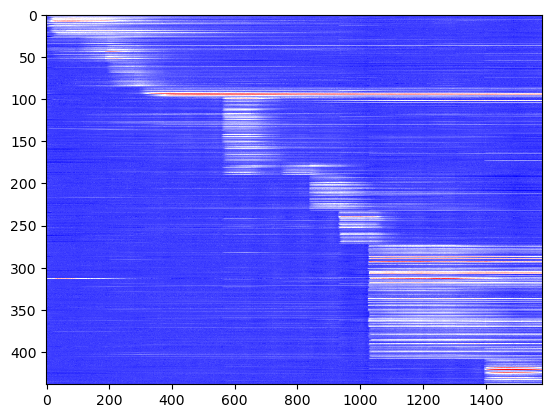

In [15]:
# PCA no good at cleaning up bumps in savgol derivative - try bandpass
sample_rate = 31/60
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(all_ids_clean_trim_dff.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
filtered =  bandpass(all_ids_clean_trim_dff, [1/190,1/170], sample_rate,1)
filtered2 = bandpass(all_ids_clean_trim_norm2, [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filtered3 = bandpass(all_ids_clean_trim_dff, [1/95,1/85], sample_rate,1)

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
filtered_sort = np.sort(filtered,axis=1)
filtered_b10 = np.mean(filtered_sort[:,:int(np.ceil(filtered_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
filtered_t10 = np.mean(filtered_sort[:,-int(np.ceil(filtered_sort.shape[1]/10)):],axis=1)
filtered_norm1 = ((filtered.T-filtered_b10)/(filtered_t10-filtered_b10)).T
plt.imshow((all_ids_clean_trim_dff-filtered)[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmax=1)

filtered2_sort = np.sort(filtered2,axis=1)
filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

In [16]:
all_ids_clean_trim_dff_f = all_ids_clean_trim_dff-filtered

In [138]:
%matplotlib qt
plt.rcParams['svg.fonttype'] = 'none'

In [140]:
%matplotlib inline

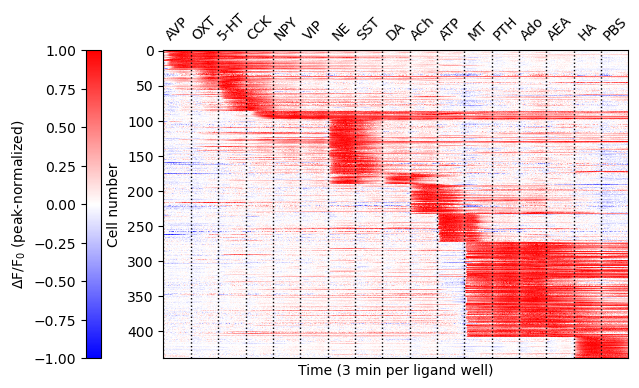

In [141]:
fig,ax=plt.subplots(figsize=(8,4))
f = ax.imshow(((all_ids_clean_trim_norm2-filtered2).T/np.max((all_ids_clean_trim_norm2-filtered2).T,axis=0)).T[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=1)#,vmax=1)
ax.set_xticks(93*np.arange(17), np.arange(17))
ax.set_xticks(93*(np.arange(17)+0.5), ['AVP','OXT','5-HT','CCK','NPY','VIP','NE','SST','DA','ACh','ATP','MT','PTH','Ado','AEA','HA','PBS'],rotation=45,minor=True)
ax.tick_params(labeltop=True,bottom=False,labelbottom=False,which='minor')
ax.tick_params(bottom=False,labelbottom=False)
ax.vlines(x=93*np.arange(17),ymin=0,ymax=len(prob_nums)-1,color='black',linewidth=1,linestyle='dotted')
ax.set_xlabel('Time (3 min per ligand well)')
ax.set_ylabel('Cell number')
fig.colorbar(f,ax=ax,location='left',label='$\Delta$F/F$_0$ (peak-normalized)')

#fig,ax=plt.subplots(figsize=(8,4))
#f = ax.imshow(1-squareform(pdist(all_ids_cg_n,'correlation')), interpolation='nearest',cmap='bwr',vmin=0.15)#,norm=divnorm)#,vmax=0.6)
#ax.set_xlabel('Sensor')
#ax.set_ylabel('Sensor')
#ax.set_xticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'],rotation=45)
#ax.set_yticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'])
#ax.tick_params(top=True,labeltop=True,bottom=False,labelbottom=False)
#fig.colorbar(f,ax=ax,location='left')

In [337]:
prob_id_map = np.zeros((all_ids_clean_trim_norm2.shape[0],10))
for i in range(len(prob_nums)):
    prob_id_map[i,prob_nums[i]-1] = 1

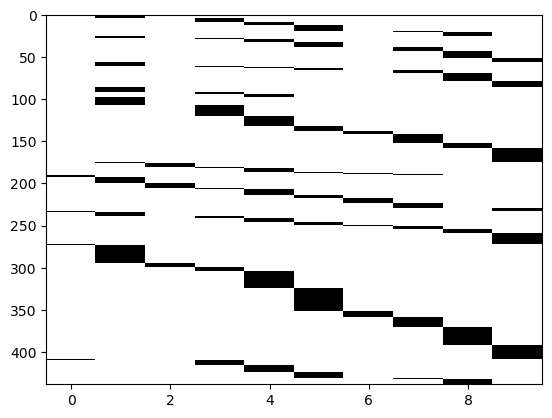

In [338]:
plt.imshow(prob_id_map[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='gray_r')

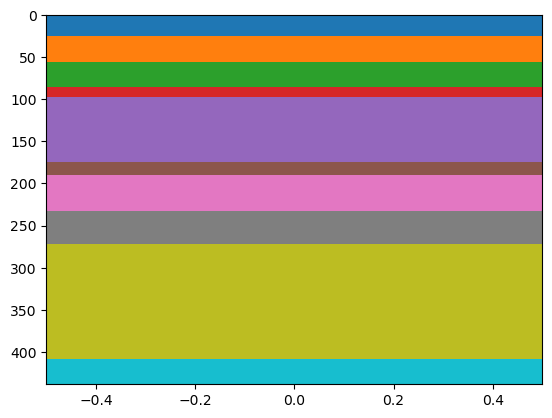

In [339]:
plt.imshow(np.array(id_nums)[np.lexsort((prob_nums,id_nums))][...,np.newaxis],cmap='tab10',interpolation='nearest',aspect='auto')

In [350]:
np.unique(np.array(prob_nums)[np.array(id_nums)==9],return_counts=True)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 array([ 1, 21,  5,  5, 20, 27,  8, 11, 22, 16], dtype=int64))

In [347]:
id_nums

[7,
 7,
 8,
 9,
 10,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 3,
 3,
 3,
 3,
 3,
 4,
 4,
 4,
 4,
 4,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 6,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 8,
 8,
 8,
 8,
 8,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 6,
 6,
 6,
 6,
 7,
 7,
 7,
 7,
 7,
 7,
 9,
 9,
 9,
 9,
 9,
 1,
 1,
 1,
 1,
 2,
 3,
 4,
 4,
 4,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 6,
 6,
 7,
 8,
 8,
 9,
 9,
 9,
 9,
 9,
 10,
 10,
 10,
 10,
 10,
 10,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 3,
 4,
 4,
 4,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 5,
 6,
 6,
 6,
 6,
 6,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 8,
 8,
 8,
 8,
 8,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 10,
 10,
 10,
 10,
 10,
 10,
 10,
 10,
 10,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 2,
 2,
 2,
 2,
 2,
 3,
 3,
 3,
 5,
 5,
 5,
 5,
 5,
 5,
 6,
 7,
 7,
 7,
 8,
 8,
 8,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 9,
 10,

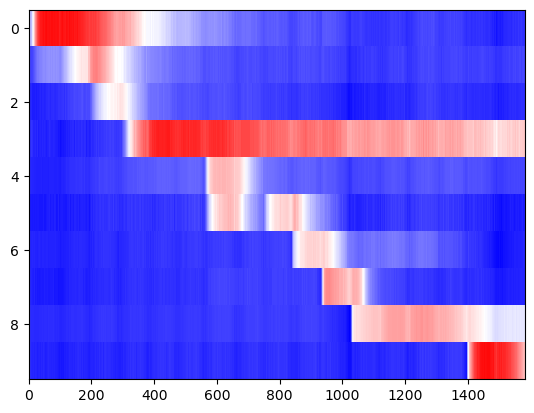

In [17]:
all_ids_c_dff = np.zeros((10,all_ids_clean_trim_dff.shape[1]))
for c in range(1,11):
    all_ids_c_dff[c-1,:] = np.mean(all_ids_clean_trim_dff[np.array(id_nums)==c,...],axis=0).T
plt.imshow(all_ids_c_dff,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.9,vmax=1.2)

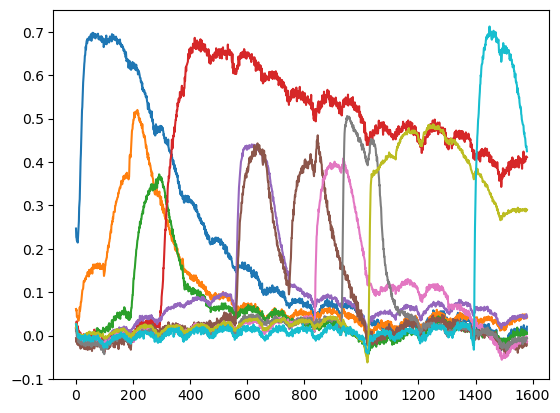

In [18]:
plt.plot(all_ids_c_dff.T)

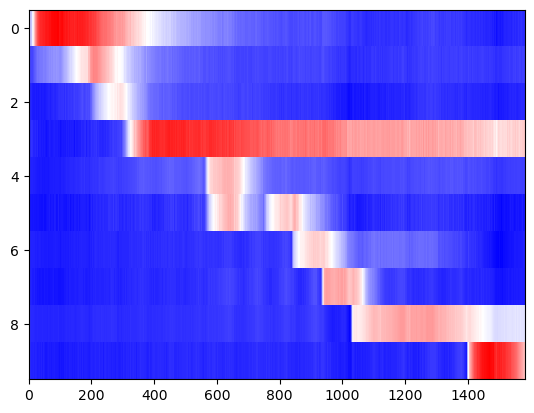

In [21]:
all_ids_c_dff_f = np.zeros((10,all_ids_clean_trim_dff.shape[1]))
for c in range(1,11):
    all_ids_c_dff_f[c-1,:] = np.mean((all_ids_clean_trim_dff-filtered)[np.array(id_nums)==c,...],axis=0).T
plt.imshow(all_ids_c_dff_f,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.9,vmax=1.2)

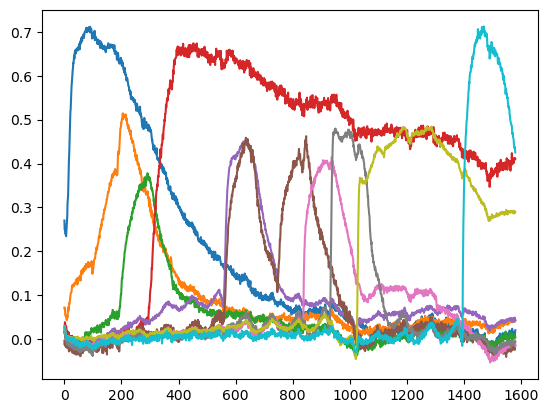

In [22]:
plt.plot(all_ids_c_dff_f.T)

In [23]:
all_ids_savs2 = list()
for id in range(all_ids_clean_trim_norm2.shape[0]):
    sig_r = all_ids_clean_trim_norm2[id,...].T
    all_ids_savs2.append(sg.savgol_filter(sig_r,10,1,deriv=1))
    #rises.append(np.min(np.where(sav_test_m[:30,] == np.max(sav_test_m[:30,]))))
   #np.min(np.where(sav_test_r == np.max(sav_test_r))))
all_ids_savs2 = np.array(all_ids_savs2)

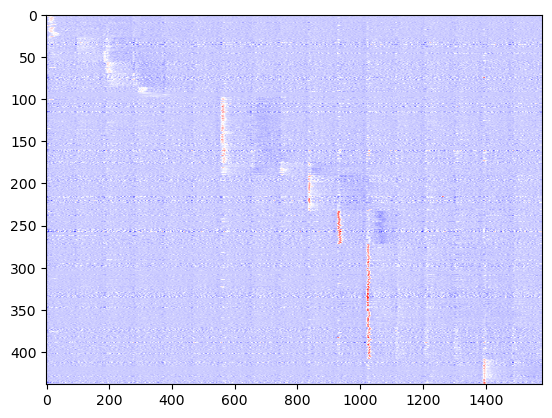

In [24]:
plt.imshow(all_ids_savs2[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)

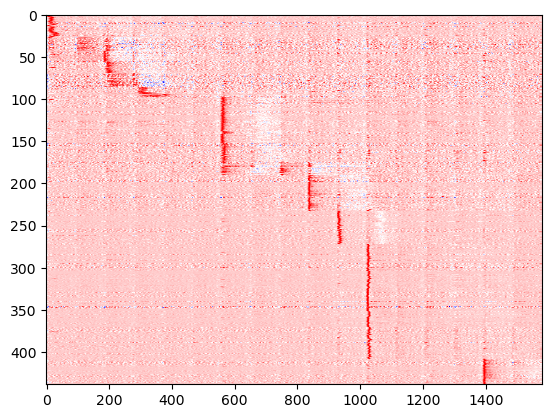

In [25]:
all_ids_savs2_norm1 = (all_ids_savs2.T/np.max(all_ids_savs2,axis=1)).T
plt.imshow(all_ids_savs2_norm1[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)

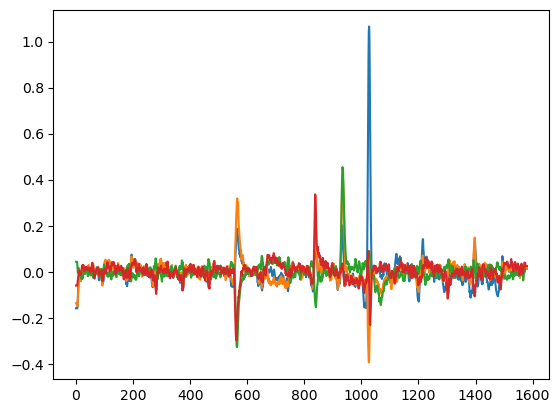

In [26]:
from sklearn.decomposition import PCA
pca = PCA(n_components=4)
pca.fit(all_ids_savs2.T)
plt.plot(pca.transform(all_ids_savs2.T))#.T, interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=2)

In [27]:
print(pca.components_.shape)
print(pca.transform(all_ids_savs2.T).shape)

(4, 439)
(1581, 4)


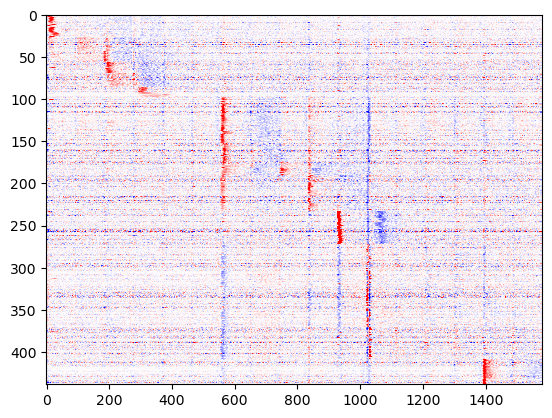

In [28]:
plt.imshow((all_ids_savs2-np.matmul(pca.components_[0,...][np.newaxis,...].T,pca.transform(all_ids_savs2.T)[...,0][...,np.newaxis].T)-np.matmul(pca.components_[3,...][np.newaxis,...].T,pca.transform(all_ids_savs2.T)[...,3][...,np.newaxis].T))[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr',vmin=-0.05,vmax=0.05)

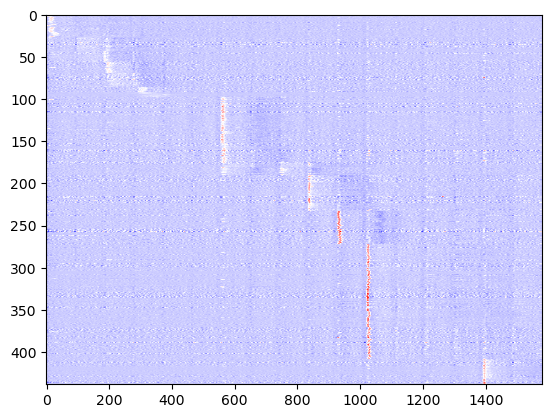

In [29]:
# PCA no good at cleaning up bumps in savgol derivative - try bandpass
sample_rate = 31/60
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(all_ids_savs2.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
filtered =  bandpass(all_ids_savs2, [1/190,1/170], sample_rate,1)
filtered2 = bandpass(all_ids_savs2_norm1, [1/190,1/170], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]
filtered3 = bandpass(all_ids_savs2, [1/95,1/85], sample_rate,1)

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
filtered_sort = np.sort(filtered,axis=1)
filtered_b10 = np.mean(filtered_sort[:,:int(np.ceil(filtered_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
filtered_t10 = np.mean(filtered_sort[:,-int(np.ceil(filtered_sort.shape[1]/10)):],axis=1)
filtered_norm1 = ((filtered.T-filtered_b10)/(filtered_t10-filtered_b10)).T
plt.imshow((all_ids_savs2-filtered)[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmax=1)

filtered2_sort = np.sort(filtered2,axis=1)
filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
#plt.imshow(filtered2_norm1[np.argsort(hdbs_slice_w.labels_),...],interpolation='nearest',aspect='auto',cmap='bwr',vmax=1)

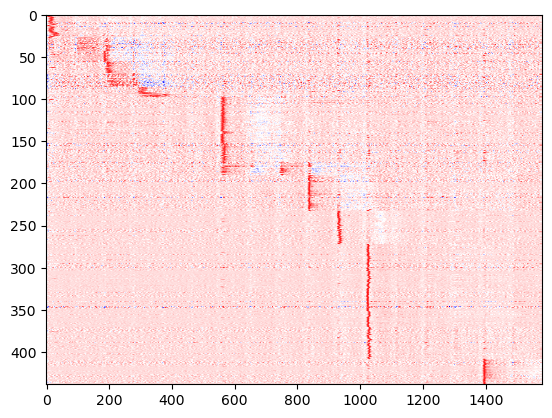

In [30]:
plt.imshow((all_ids_savs2_norm1-filtered2)[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-1.2,vmax=1.2)#,vmax=1)

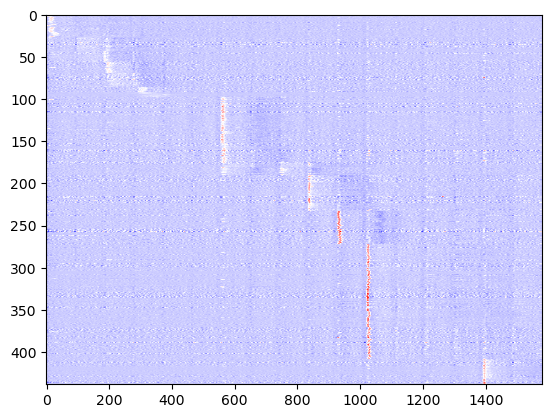

In [31]:
plt.imshow(((all_ids_savs2_norm1-filtered2).T*np.max(all_ids_savs2,axis=1)).T[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')

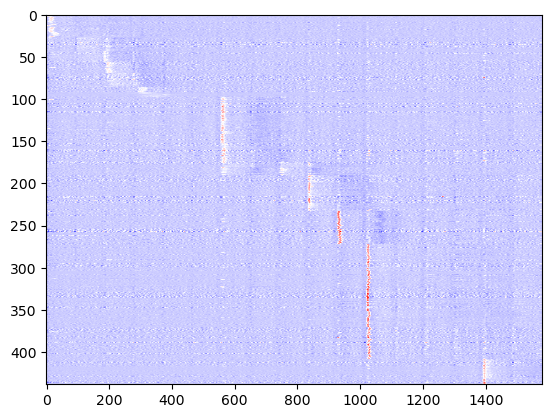

In [32]:
plt.imshow(((all_ids_savs2-filtered))[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')

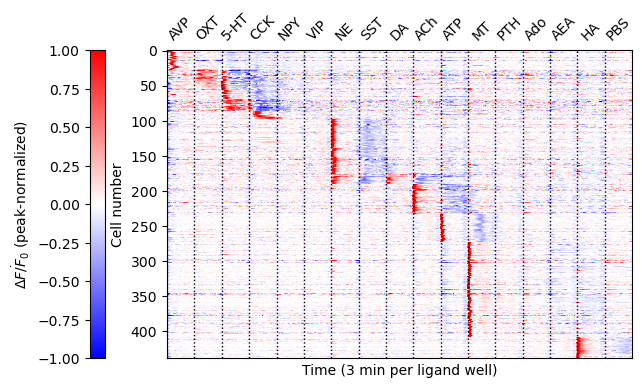

In [155]:
%matplotlib inline
fig,ax=plt.subplots(figsize=(8,4))
f = ax.imshow((sg.medfilt2d((all_ids_savs2-filtered).T,kernel_size=[15,1])/np.max(sg.medfilt2d((all_ids_savs2-filtered).T,kernel_size=[15,1]).T,axis=1)).T[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=1)
ax.set_xticks(93*np.arange(17), np.arange(17))
#fig.colorbar(f,ax=ax,location='left')

#fig,ax=plt.subplots(figsize=(8,4))
#f = ax.imshow(((all_ids_clean_trim_norm2-filtered2).T/np.max((all_ids_clean_trim_norm2-filtered2).T,axis=0)).T[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=1)#,vmax=1)
ax.set_xticks(93*np.arange(17), np.arange(17))
ax.set_xticks(93*(np.arange(17)+0.5), ['AVP','OXT','5-HT','CCK','NPY','VIP','NE','SST','DA','ACh','ATP','MT','PTH','Ado','AEA','HA','PBS'],rotation=45,minor=True)
ax.tick_params(labeltop=True,bottom=False,labelbottom=False,which='minor')
ax.tick_params(bottom=False,labelbottom=False)
ax.vlines(x=93*np.arange(17),ymin=0,ymax=len(prob_nums)-1,color='black',linewidth=1,linestyle='dotted')
ax.set_xlabel('Time (3 min per ligand well)')
ax.set_ylabel('Cell number')
fig.colorbar(f,ax=ax,location='left',label='$\dot{\Delta F/F _0}$ (peak-normalized)')

#fig,ax=plt.subplots(figsize=(8,4))
#f = ax.imshow(1-squareform(pdist(all_ids_cg_n,'correlation')), interpolation='nearest',cmap='bwr',vmin=0.15)#,norm=divnorm)#,vmax=0.6)
#ax.set_xlabel('Sensor')
#ax.set_ylabel('Sensor')
#ax.set_xticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'],rotation=45)
#ax.set_yticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'])
#ax.tick_params(top=True,labeltop=True,bottom=False,labelbottom=False)
#fig.colorbar(f,ax=ax,location='left')

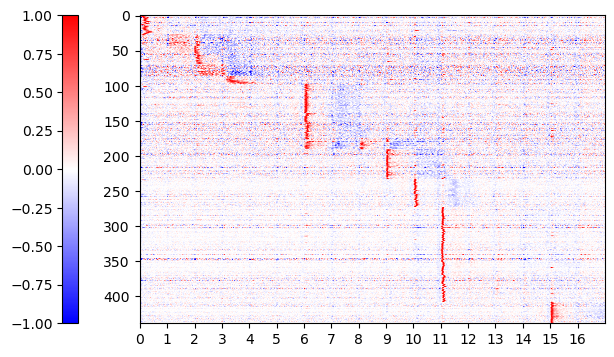

In [34]:
fig,ax=plt.subplots(figsize=(8,4))
f = ax.imshow((sg.medfilt2d((all_ids_savs2-filtered).T,kernel_size=[1,1])/np.max(sg.medfilt2d((all_ids_savs2-filtered).T,kernel_size=[1,1]).T,axis=1)).T[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=1)
ax.set_xticks(93*np.arange(17), np.arange(17))
fig.colorbar(f,ax=ax,location='left')

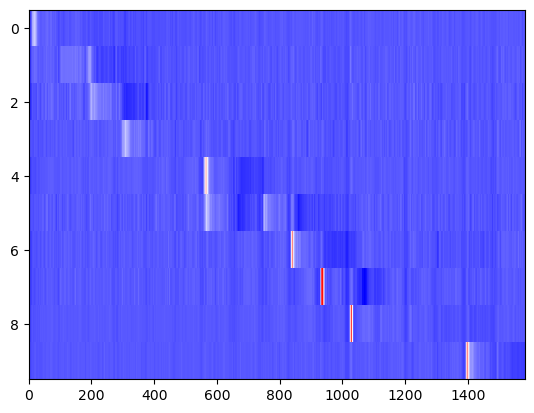

In [35]:
all_ids_cg = np.zeros((10,all_ids_savs2.shape[1]))
for c in range(1,11):
    all_ids_cg[c-1,:] = np.median((all_ids_savs2-filtered)[np.array(id_nums)==c,...],axis=0).T
plt.imshow(all_ids_cg,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmin=-0.9,vmax=1.2)

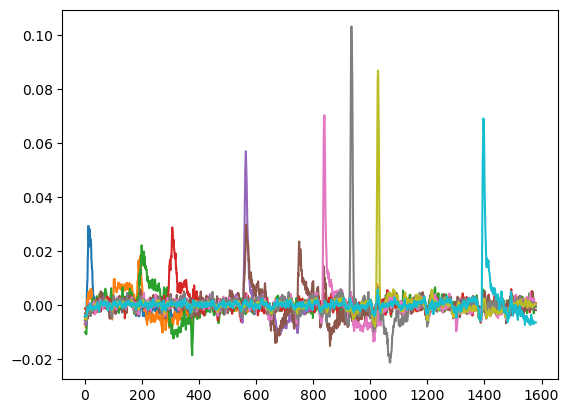

In [36]:
plt.plot(all_ids_cg.T)
# bandpass looks pretty good, gentle cleanup of frequency around 3 min exactly (93 fr)

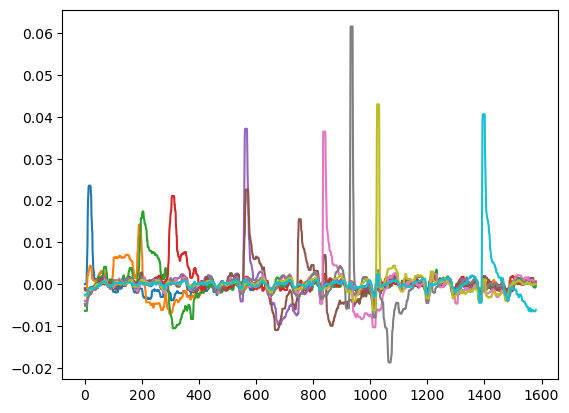

In [37]:
plt.plot(sg.medfilt2d(all_ids_cg.T,kernel_size=[15,1]))
# bandpass looks pretty good, gentle cleanup of frequency around 3 min exactly (93 fr)

In [225]:
all_ids_cg.shape

(10, 1581)

(-0.025, 0.105)

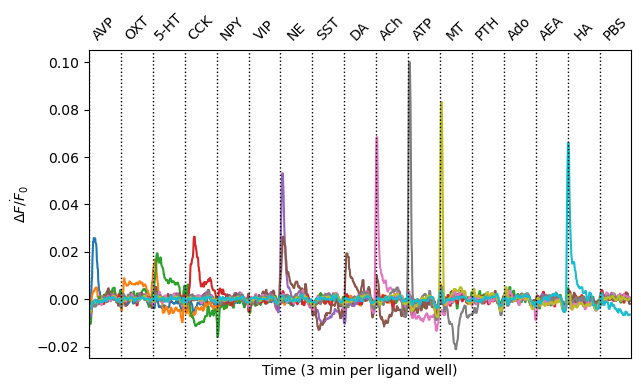

In [235]:
%matplotlib inline
fig,ax=plt.subplots(figsize=(7,4))
f = ax.plot((sg.medfilt2d(all_ids_cg.T,kernel_size=[5,1])))
ax.set_xticks(93*np.arange(17), np.arange(17))
ax.set_xticks(93*(np.arange(17)+0.5), ['AVP','OXT','5-HT','CCK','NPY','VIP','NE','SST','DA','ACh','ATP','MT','PTH','Ado','AEA','HA','PBS'],rotation=45,minor=True)
#ax.set_yticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'])
ax.tick_params(labeltop=True,bottom=False,labelbottom=False,which='minor')
ax.tick_params(bottom=False,labelbottom=False)
ax.vlines(x=93*np.arange(17),ymin=-1,ymax=1,color='black',linewidth=1,linestyle='dotted')
ax.set_xlabel('Time (3 min per ligand well)')
ax.set_ylabel('$\dot{\Delta F/F _0}$')
ax.set_xlim(0,all_ids_cg.shape[1])
ax.set_ylim(-0.025,0.105)
#fig.colorbar(f,ax=ax,location='left',label='$\dot{\Delta F/F _0}$ (peak-normalized)')

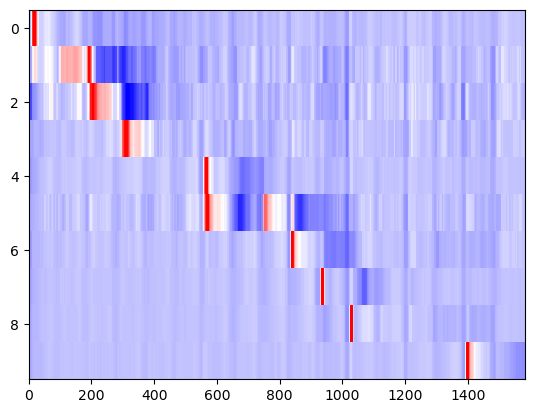

In [39]:
plt.imshow((sg.medfilt2d(all_ids_cg.T,kernel_size=[15,1])/np.max(sg.medfilt2d(all_ids_cg.T,kernel_size=[15,1]).T,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmin=-0.9,vmax=1.2)

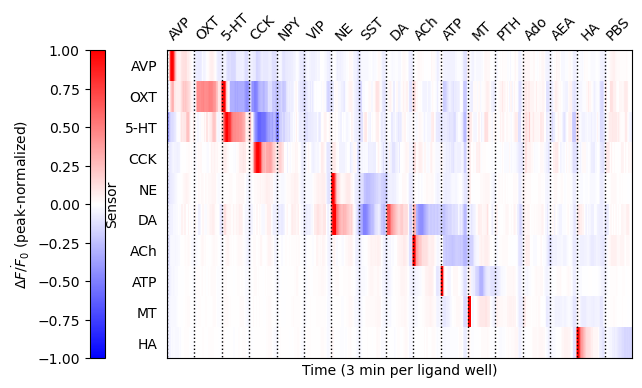

In [165]:
%matplotlib inline
fig,ax=plt.subplots(figsize=(8,4))
f = ax.imshow((sg.medfilt2d(all_ids_cg.T,kernel_size=[15,1])/np.max(sg.medfilt2d(all_ids_cg.T,kernel_size=[15,1]).T,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=1)#,vmin=-0.9,vmax=1.2)
ax.set_xticks(93*np.arange(17), np.arange(17))
ax.set_xticks(93*(np.arange(17)+0.5), ['AVP','OXT','5-HT','CCK','NPY','VIP','NE','SST','DA','ACh','ATP','MT','PTH','Ado','AEA','HA','PBS'],rotation=45,minor=True)
ax.set_yticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'])
ax.tick_params(labeltop=True,bottom=False,labelbottom=False,which='minor')
ax.tick_params(bottom=False,labelbottom=False,left=False)
ax.vlines(x=93*np.arange(17),ymin=-0.5,ymax=9.5,color='black',linewidth=1,linestyle='dotted')
ax.set_xlabel('Time (3 min per ligand well)')
ax.set_ylabel('Sensor')
fig.colorbar(f,ax=ax,location='left',label='$\dot{\Delta F/F _0}$ (peak-normalized)')

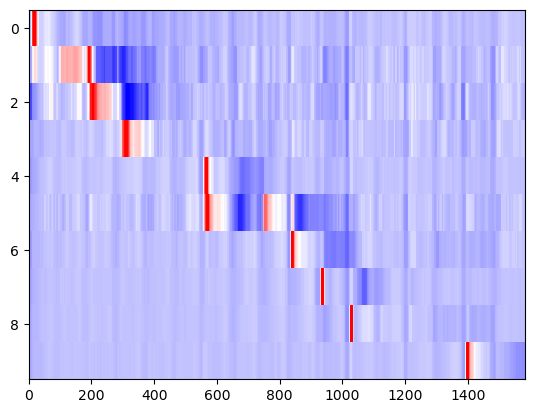

In [41]:
plt.imshow((sg.medfilt2d(all_ids_cg.T,kernel_size=[15,1])/np.max(sg.medfilt2d(all_ids_cg.T,kernel_size=[15,1]).T,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmin=-0.9,vmax=1.2)

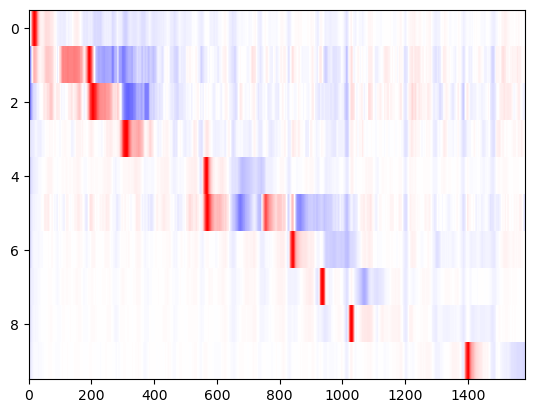

In [42]:
plt.imshow((sg.savgol_filter(all_ids_cg.T,15,1,axis=0)/np.max(sg.savgol_filter(all_ids_cg.T,15,1,axis=0).T,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=1)#,vmin=-0.9,vmax=1.2)

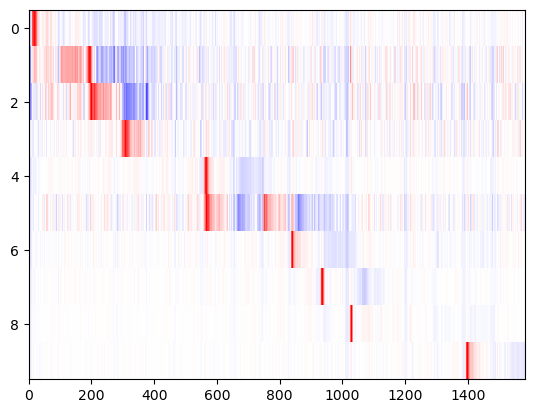

In [43]:
plt.imshow((all_ids_cg.T/np.max(all_ids_cg,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',vmin=-1,vmax=1)#,vmin=-0.9,vmax=1.2)

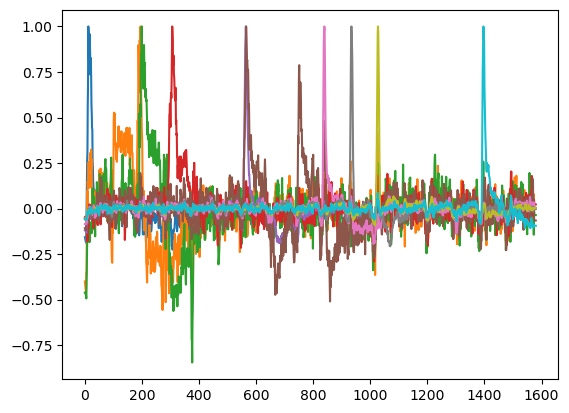

In [44]:
plt.plot((all_ids_cg.T/np.max(all_ids_cg,axis=1)))

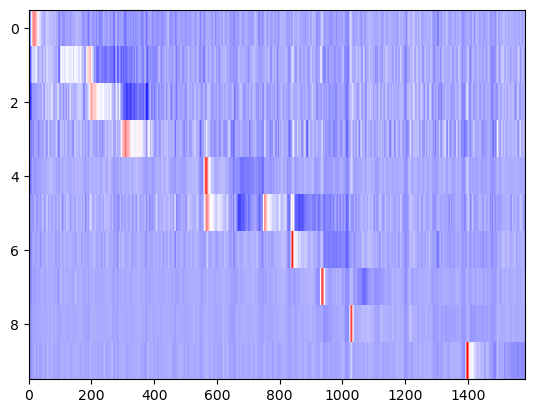

In [45]:
all_ids_cg_n = np.zeros((10,all_ids_savs2_norm1.shape[1]))
for c in range(1,11):
    all_ids_cg_n[c-1,:] = np.mean((all_ids_savs2_norm1-filtered2)[np.array(id_nums)==c,...],axis=0).T
plt.imshow(all_ids_cg_n,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmin=-0.9,vmax=1.2)

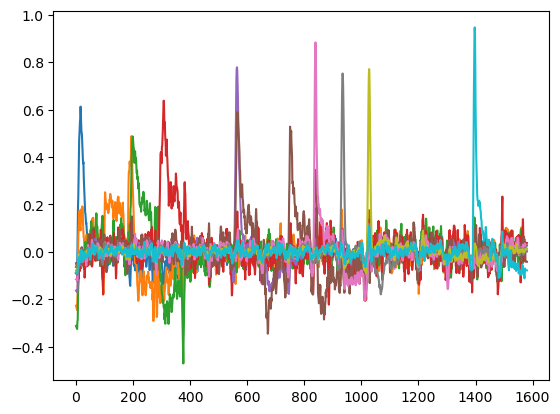

In [46]:
plt.plot(all_ids_cg_n.T)

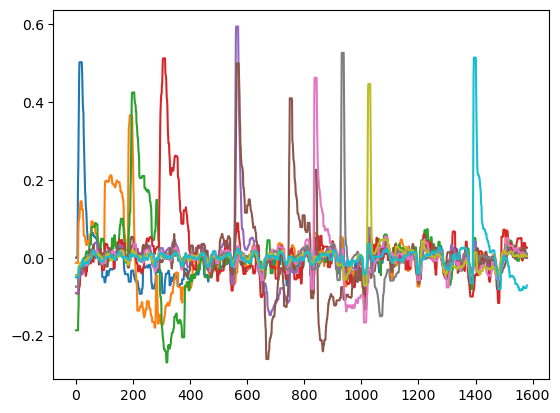

In [47]:
plt.plot(sg.medfilt2d(all_ids_cg_n.T,kernel_size=[15,1]))
# bandpass looks pretty good, gentle cleanup of frequency around 3 min exactly (93 fr)

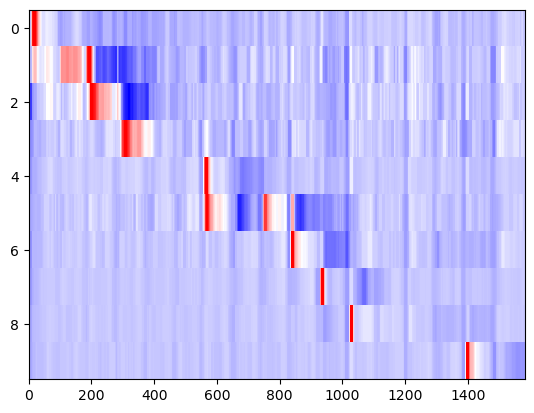

In [48]:
plt.imshow((sg.medfilt2d(all_ids_cg_n.T,kernel_size=[15,1])/np.max(sg.medfilt2d(all_ids_cg_n.T,kernel_size=[15,1]).T,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmin=-0.9,vmax=1.2)

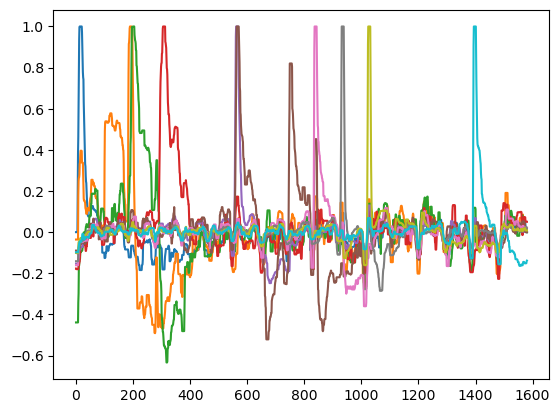

In [49]:
plt.plot((sg.medfilt2d(all_ids_cg_n.T,kernel_size=[15,1])/np.max(sg.medfilt2d(all_ids_cg_n.T,kernel_size=[15,1]).T,axis=1)))

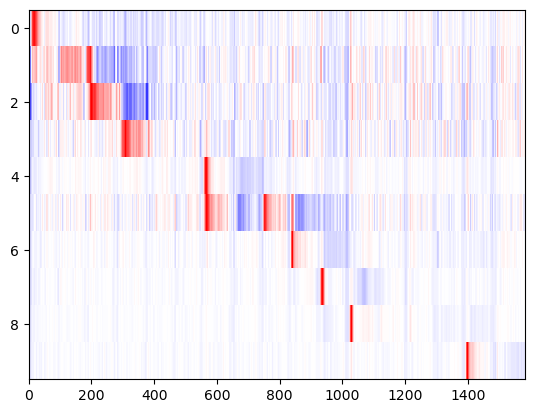

In [50]:
plt.imshow((all_ids_cg_n.T/np.max(all_ids_cg_n,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.05,vmax=0.05)#,vmin=-0.9,vmax=1.2)

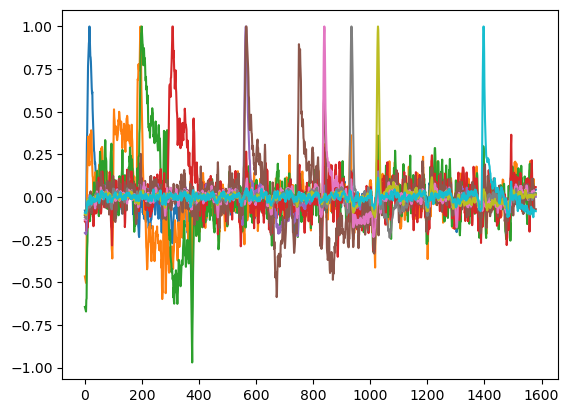

In [51]:
plt.plot((all_ids_cg_n.T/np.max(all_ids_cg_n,axis=1)))

In [52]:
np.max(all_ids_cg_n,axis=1)

array([0.61231259, 0.48843245, 0.48583772, 0.63725293, 0.77815002,
       0.58897674, 0.88329381, 0.75211682, 0.77069628, 0.94620995])

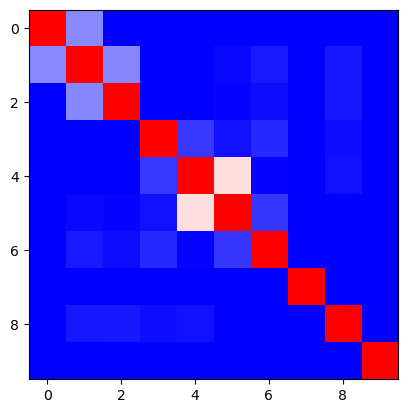

In [53]:
plt.imshow(squareform(pdist(all_ids_cg,'correlation')), interpolation='nearest',cmap='bwr_r',vmax=0.9)#,norm=divnorm)#,vmax=0.6)

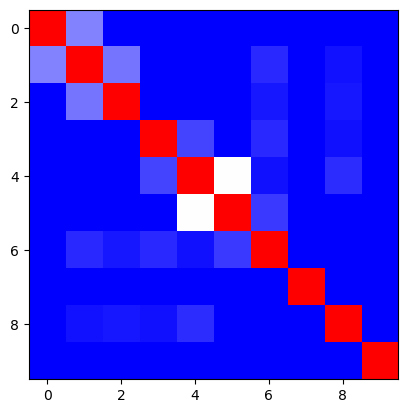

In [54]:
plt.imshow(squareform(pdist(all_ids_cg_n,'correlation')), interpolation='nearest',cmap='bwr_r',vmax=0.85)#,norm=divnorm)#,vmax=0.6)

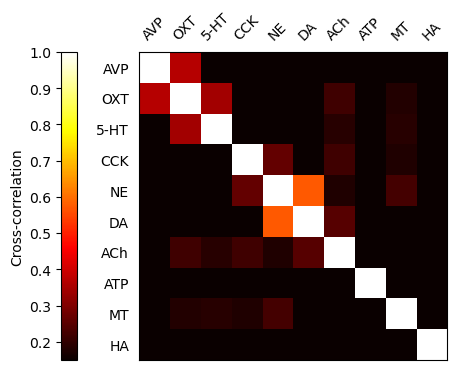

In [335]:
%matplotlib inline
fig,ax=plt.subplots(figsize=(8,4))
f = ax.imshow(1-squareform(pdist(all_ids_cg_n,'correlation')), interpolation='nearest',cmap='hot',vmin=0.15)#,norm=divnorm)#,vmax=0.6)
#ax.set_xlabel('Sensor')
#ax.set_ylabel('Sensor')
ax.set_xticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'],rotation=45)
ax.set_yticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'])
ax.tick_params(labeltop=True,bottom=False,labelbottom=False,left=False)
fig.colorbar(f,ax=ax,location='left',label='Cross-correlation')

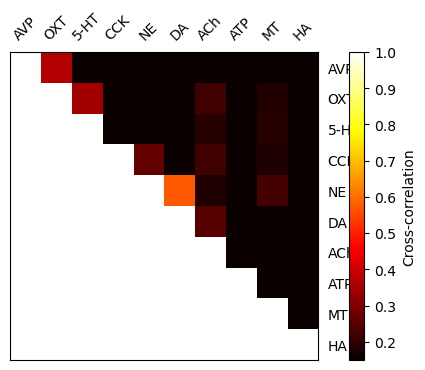

In [333]:
%matplotlib inline
fig,ax=plt.subplots(figsize=(8,4))
f = ax.imshow(np.triu(-squareform(pdist(all_ids_cg_n,'correlation')),k=0)+1, interpolation='nearest',cmap='hot',vmin=0.15)#,norm=divnorm)#,vmax=0.6)
#ax.set_xlabel('Sensor')
#ax.set_ylabel('Sensor')
ax.set_xticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'],rotation=45)
ax.set_yticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'])
ax.tick_params(labeltop=True,bottom=False,labelbottom=False,left=False,labelleft=False,labelright=True)
fig.colorbar(f,ax=ax,location='right',label='Cross-correlation')

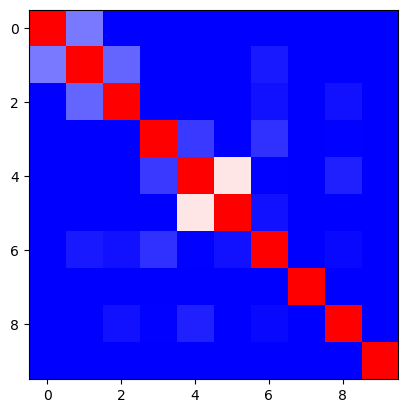

In [56]:
plt.imshow(squareform(pdist(sg.medfilt2d(all_ids_cg_n.T,kernel_size=[15,1]).T,'correlation')), interpolation='nearest',cmap='bwr_r',vmax=0.85)#,norm=divnorm)#,vmax=0.6)

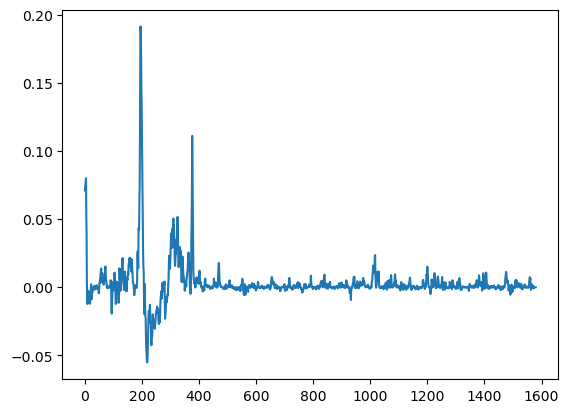

In [57]:
plt.plot(all_ids_cg_n[1,...]*all_ids_cg_n[2,...])

In [569]:
# peak dF/F summary
# crosstalk terms to demonstrate: AVP at OXT sensor, NE at DA sensor
# then use 7x slice dipping to confirm that these two are the most promiment and consistent crosstalk terms - and that the others aren't replicated
## in case of DA-ACh, point out directionality of relationship isn't consistent - in general to be consistent, correlation and directionality must match
%matplotlib inline
#%matplotlib qt

In [58]:
all_ids_clean_trim_dff_f_wbw = np.zeros((all_ids_clean_trim_dff_f.shape[0],17))
for j in trange(17):
    vals = all_ids_clean_trim_dff_f[...,j*93:(j+1)*93]
    vals_wbw = np.median(vals[...,62:93],axis=1)
    all_ids_clean_trim_dff_f_wbw[...,j] = vals_wbw

  0%|          | 0/17 [00:00<?, ?it/s]

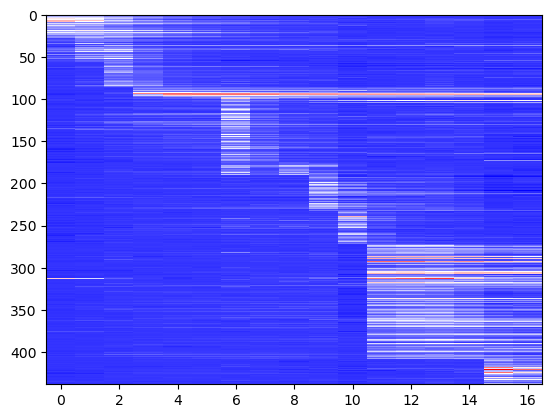

In [59]:
plt.imshow(all_ids_clean_trim_dff_f_wbw[np.lexsort((prob_nums,id_nums))],interpolation='nearest',aspect='auto',cmap='bwr')

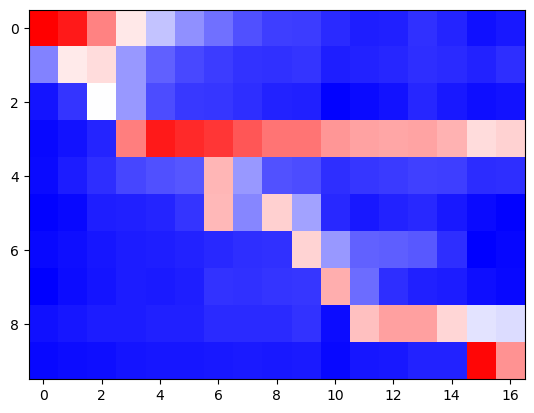

In [60]:
all_ids_c_dff_f_wbw = np.zeros((10,all_ids_clean_trim_dff_f_wbw.shape[1]))
for c in range(1,11):
    all_ids_c_dff_f_wbw[c-1,:] = np.mean(all_ids_clean_trim_dff_f_wbw[np.array(id_nums)==c,...],axis=0).T
plt.imshow(all_ids_c_dff_f_wbw,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.9,vmax=1.2)

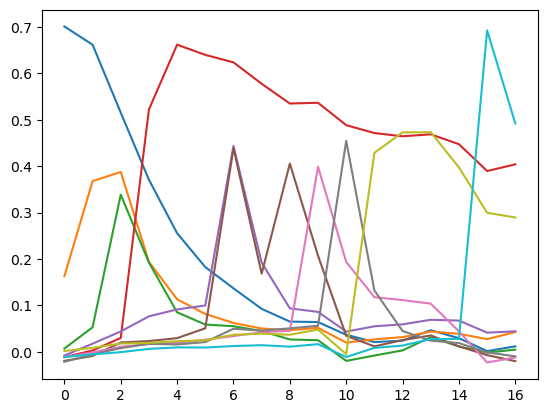

In [61]:
plt.plot(all_ids_c_dff_f_wbw.T)

In [62]:
all_ids_c_dff_f_wbw_p = []
for c in range(1,11):
    all_ids_c_dff_f_wbw_p.append(all_ids_clean_trim_dff_f_wbw[np.array(id_nums)==c,...])

In [63]:
vkeep = [[0],[0,2],[2],[4],[6],[6,8],[9],[10],[12],[15]]
vals_keep = []
for j in range(10):
    valadd = []
    for c in vkeep[j]:
        val = all_ids_c_dff_f_wbw_p[j][...,c]
        valadd.append(val[val>0])
    vals_keep.append(valadd)

In [86]:
vals_keep_unwrap = [y[j] for y in vals_keep for j in range(len(y))]

In [87]:
len(vals_keep_unwrap)

12

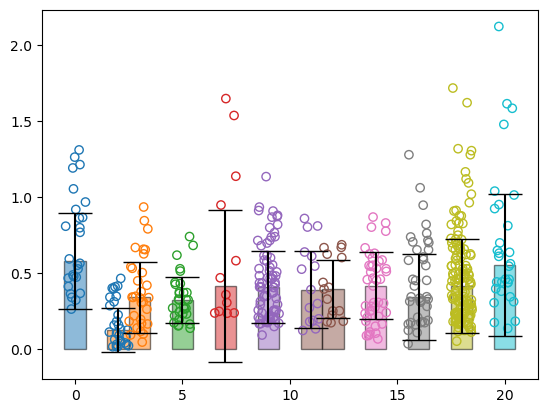

In [88]:
np.random.seed(123)

w = 1    # bar width
x = [0,2,3,5,7,9,11,12,14,16,18,20] # x-coordinates of your bars
js = [0,1,1,2,3,4,5,5,6,7,8,9]
jl = [0,0,1,2,3,4,4,5,6,7,8,9]
colorss = [sns.color_palette("tab10")[j] for j in js]    # corresponding colors
colorsl = [sns.color_palette("tab10")[j] for j in jl]
y = vals_keep_unwrap

fig, ax = plt.subplots()
ax.bar(x,
       height=[np.median(yi) for yi in y],
       yerr=[np.std(yi) for yi in y],    # error bars
       capsize=12, # error bar cap width in points
       width=w,    # bar width
       #tick_label=["NEs-5HT", "NEs-KCl", "5HTs-KCl", "5HTs-5HT"],
       edgecolor='black',  # face color transparent
       color=colorss,alpha=0.5,
       #ecolor=colors,    # error bar colors; setting this raises an error for whatever reason.
       )

for i in range(len(x)):
    # distribute scatter randomly across whole width of bar
    ax.scatter(x[i] + np.random.random(y[i].size) * w - w / 2, y[i],facecolors='none', edgecolors=colorsl[i])
#for i in range(ne_5ht_lgn_movs.shape[0]):
#    ax.plot(ne_5ht_lgn_movs[i,1:5],marker='o',linestyle='dotted',color='gray')
plt.show()

In [236]:
len(vals_keep_unwrap)

12

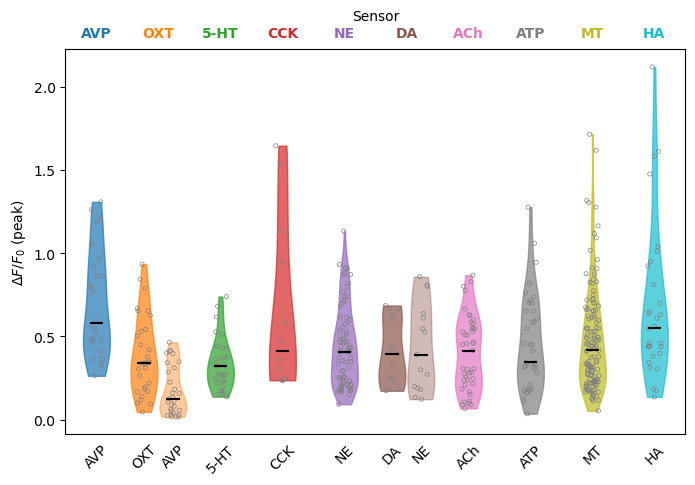

In [252]:
%matplotlib inline
np.random.seed(100)

#w = 0.9    # bar width
w = 1.3
alphas = [0.7]*2+[0.4]+[0.7]*4+[0.4]+[0.7]*4
#x = [0,2,3,5,7,9,11,12,14,16,18,20] # x-coordinates of your bars
x = [0.5,3-0.2,4+0.2,6.5,9.5,12.5,15-0.2,16+0.2,18.5,21.5,24.5,27.5]
js = [0,1,1,2,3,4,5,5,6,7,8,9]
jl = [0,0,1,2,3,4,4,5,6,7,8,9]
colorss = [sns.color_palette("tab10")[j] for j in js]    # corresponding colors
colorsl = [sns.color_palette("tab10")[j] for j in jl]
y = [vals_keep_unwrap[i] for i in [0,2,1,3,4,5,7,6,8,9,10,11]]

fig, ax = plt.subplots(figsize=(8,5))
parts = ax.violinplot(y,
       positions=x,
       #yerr=[np.std(yi) for yi in y],    # error bars
       #capsize=12, # error bar cap width in points
       widths=w,    # bar width
       #tick_label=["NEs-5HT", "NEs-KCl", "5HTs-KCl", "5HTs-5HT"],
       #edgecolor='black',  # face color transparent
       #color=colorss,alpha=0.5,
       #ecolor=colors,    # error bar colors; setting this raises an error for whatever reason.
       showextrema=False,
       showmedians=True,
       #bw_method='silverman'
       )
for p in range(len(parts['bodies'])):
    parts['bodies'][p].set_color(colorss[p])
    #parts['cmedians'].set_color(colorsl)
    parts['cmedians'].set_color('black')
    parts['bodies'][p].set_alpha(alphas[p])

for i in range(len(x)):
    # distribute scatter randomly across whole width of bar
    #ax.scatter(x[i] + np.random.random(y[i].size) * w - w / 2, y[i],facecolors='none', edgecolors=colorsl[i],marker='.')
    ax.scatter(x[i] + np.random.random(y[i].size) * w/2 - w/2 / 2, y[i],facecolors='none', edgecolors='gray',marker='.',linewidths=0.5)
    #ax.scatter(np.repeat(x[i],len(y[i])) , y[i],facecolors='none', edgecolors='gray',marker='.')
#for i in range(ne_5ht_lgn_movs.shape[0]):
#    ax.plot(ne_5ht_lgn_movs[i,1:5],marker='o',linestyle='dotted',color='gray')
#plt.show()


ax.set_xticks(3*np.arange(10)+0.5,['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'],fontweight='bold')
ax.set_xticks(np.array(x) + 0.01, ['AVP','OXT','AVP','5-HT','CCK','NE','DA','NE','ACh','ATP','MT','HA'],rotation=45,minor=True)

#ax.set_xticks(93*(np.arange(17)+0.5), ['AVP','OXT','5-HT','CCK','NPY','VIP','NE','SST','DA','ACh','ATP','MT','PTH','Ado','AEA','HA','PBS'],rotation=45,minor=True)
#ax.set_yticks(np.arange(10),labels=['AVP','OXT','5-HT','CCK','NE','DA','ACh','ATP','MT','HA'])
ax.tick_params(labeltop=True,bottom=False,labelbottom=False)
ax.tick_params(bottom=False,which='minor')
#ax.vlines(x=93*np.arange(17),ymin=-0.5,ymax=9.5,color='black',linewidth=1,linestyle='dotted')
#ax.set_xlabel('Ligand')
ax.set_xlabel('Sensor')
ax.xaxis.set_label_position('top')
ax.set_ylabel('$\Delta F/F _0$ (peak)')
ax.set_xlim([-1,29])
#ax.set_ylim(-0.2,2.2)
labels = ax.get_xticklabels()
for l, c in zip(labels, list(sns.color_palette("tab10"))):
    l.set_color(c)

In [83]:
# save consensus peak dF/Fs
save_path_v = r'H:\CNMFoutputs\peter\mask_matching\vals_keep_unwrap.pickle'

with open(save_path_v, 'wb') as f:
    pickle.dump(vals_keep_unwrap, f)

In [72]:
[np.median(yi) for yi in y]

[0.5789998891004446,
 0.12579237029520562,
 0.3403051873458667,
 0.3236814574952471,
 0.41395684996231513,
 0.40828162729516676,
 0.391415014238334,
 0.3957876041457522,
 0.41572856043463713,
 0.3447411423402485,
 0.41614961016607677,
 0.5535618931949822]

In [76]:
[0.7]+[0.5]+[0.7]*4+[0.5]+[0.7]*5

[0.7, 0.5, 0.7, 0.7, 0.7, 0.7, 0.5, 0.7, 0.7, 0.7, 0.7, 0.7]

In [68]:
import seaborn as sns

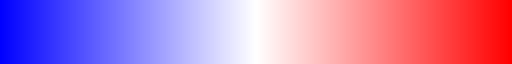

In [191]:
sns.color_palette("bwr", as_cmap=True)

In [482]:
sns.color_palette("tab10")

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

In [205]:
sns.color_palette("pastel")

[(0.6313725490196078, 0.788235294117647, 0.9568627450980393),
 (1.0, 0.7058823529411765, 0.5098039215686274),
 (0.5529411764705883, 0.8980392156862745, 0.6313725490196078),
 (1.0, 0.6235294117647059, 0.6078431372549019),
 (0.8156862745098039, 0.7333333333333333, 1.0),
 (0.8705882352941177, 0.7333333333333333, 0.6078431372549019),
 (0.9803921568627451, 0.6901960784313725, 0.8941176470588236),
 (0.8117647058823529, 0.8117647058823529, 0.8117647058823529),
 (1.0, 0.996078431372549, 0.6392156862745098),
 (0.7254901960784313, 0.9490196078431372, 0.9411764705882353)]

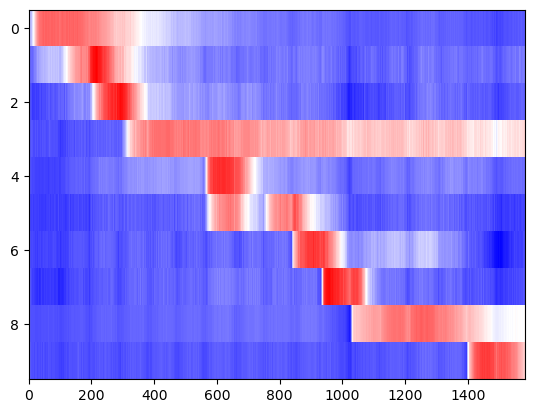

In [43]:
all_ids_c2 = np.zeros((10,all_ids_clean_trim_norm2.shape[1]))
for c in range(1,11):
    all_ids_c2[c-1,:] = np.mean(all_ids_clean_trim_norm2[np.array(id_nums)==c,...],axis=0).T
plt.imshow(all_ids_c2,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.9,vmax=1.2)

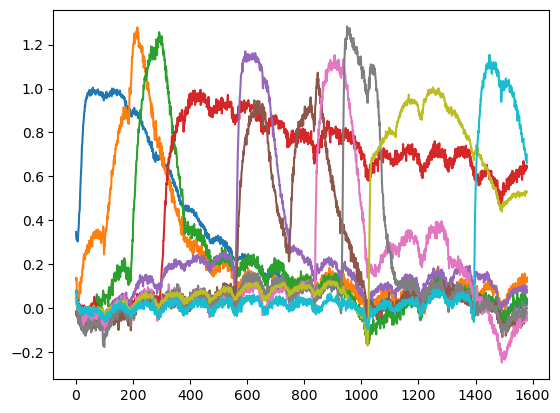

In [44]:
plt.plot(all_ids_c2.T)

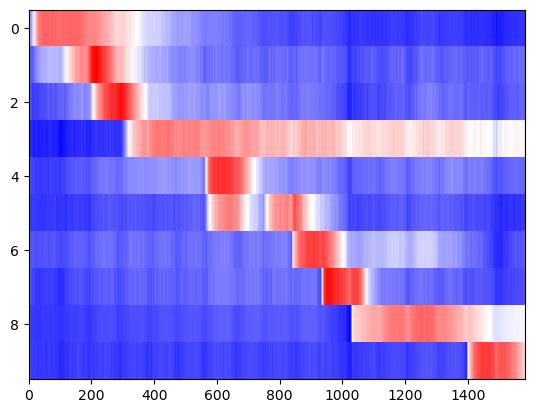

In [16]:
all_ids_c = np.zeros((10,all_ids_clean_trim_norm1.shape[1]))
for c in range(1,11):
    all_ids_c[c-1,:] = np.mean(all_ids_clean_trim_norm1[np.array(id_nums)==c,...],axis=0).T
plt.imshow(all_ids_c,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.9,vmax=1.2)

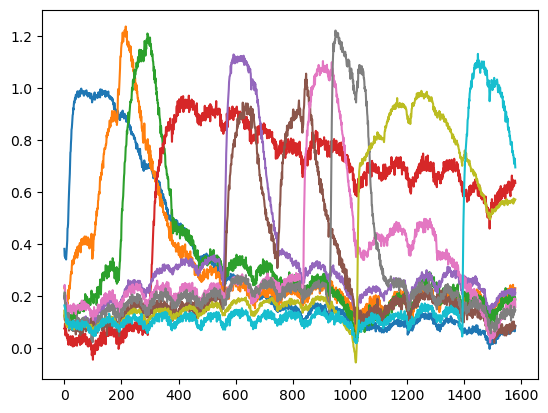

In [17]:
plt.plot(all_ids_c.T)

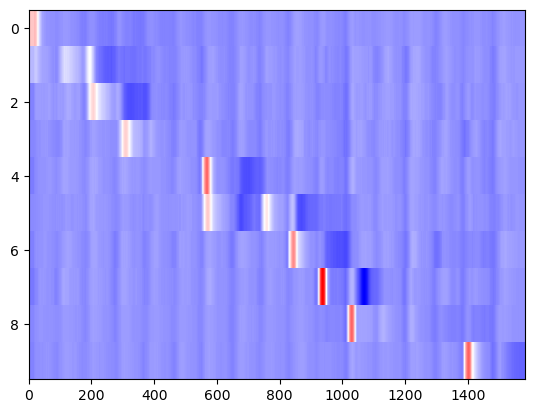

In [18]:
all_ids_c_savs = list()
for id in range(all_ids_c.shape[0]):
    sig_r = all_ids_c[id,...].T
    all_ids_c_savs.append(sg.savgol_filter(sig_r,30,1,deriv=1))
    #rises.append(np.min(np.where(sav_test_m[:30,] == np.max(sav_test_m[:30,]))))
   #np.min(np.where(sav_test_r == np.max(sav_test_r))))
all_ids_c_savs = np.array(all_ids_c_savs)
plt.imshow(all_ids_c_savs,interpolation='nearest',aspect='auto',cmap='bwr')#,vmin=-0.9,vmax=1.2)

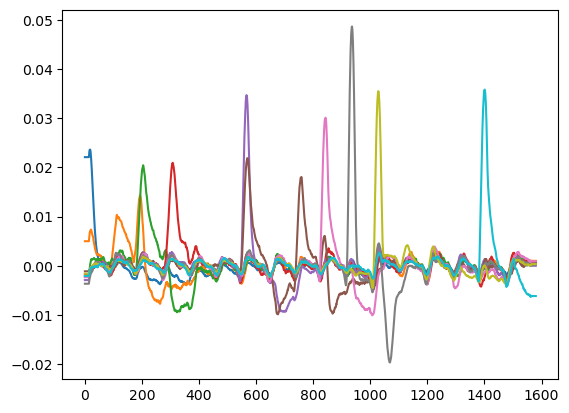

In [19]:
plt.plot(all_ids_c_savs.T)

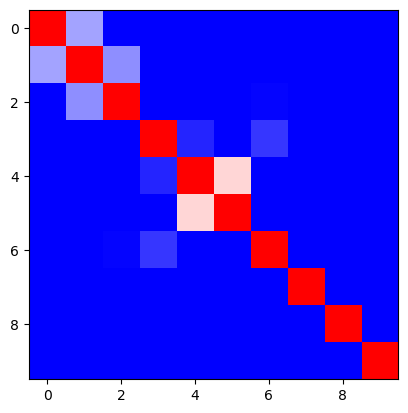

In [206]:
plt.imshow(squareform(pdist(all_ids_c_savs,'correlation')), interpolation='nearest',cmap='bwr_r',vmax=0.8)#,norm=divnorm)#,vmax=0.6)

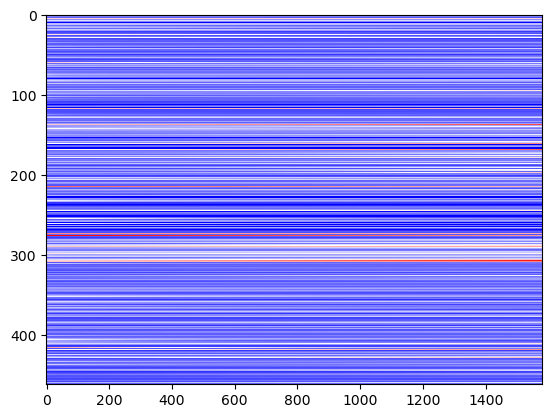

In [780]:
plt.imshow(bg_clean,interpolation='nearest',aspect='auto',cmap='bwr')

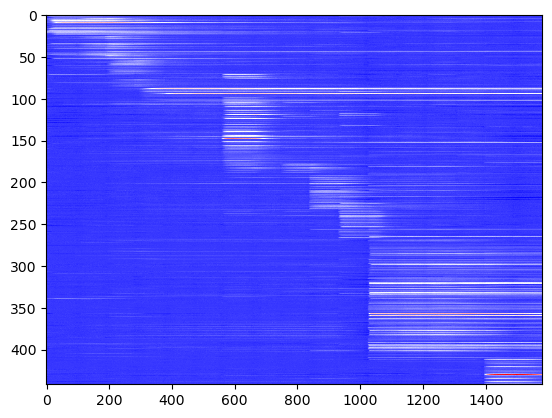

In [775]:
plt.imshow(all_ids_clean_c[np.argsort(np.array(id_nums)),...],interpolation='nearest',aspect='auto',cmap='bwr')

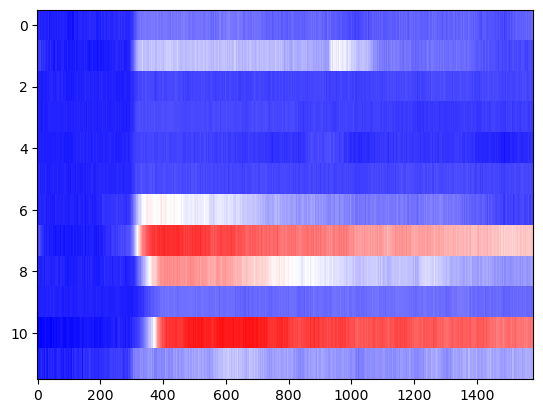

In [774]:
plt.imshow(all_ids_clean_c[np.where(np.array(id_nums)==4)[0],...],interpolation='nearest',aspect='auto',cmap='bwr')

In [767]:
np.where(np.array(id_nums)==1)

(array([  5,   6,   7,   8,   9,  83,  84,  85,  86, 121, 122, 123, 124,
        191, 192, 193, 194, 195, 196, 197, 273, 317, 318, 319, 320],
       dtype=int64),)

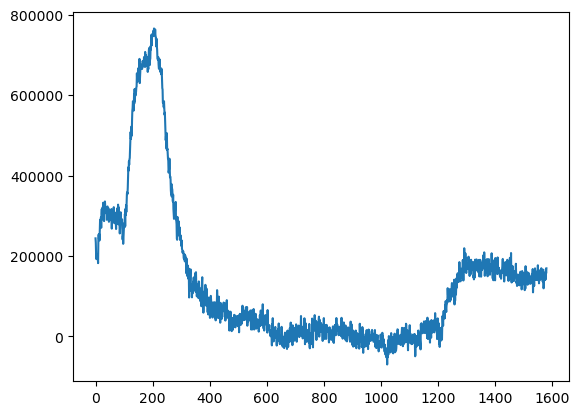

In [770]:
plt.plot(all_ids_clean_c[np.where(np.array(id_nums)==1)[0],...][19,...])

In [484]:
np.array(id_nums)[10:15]

array([2, 2, 2, 3, 3])

In [485]:
np.array(prob_nums)[10:15]

array([2, 2, 2, 2, 2])

In [487]:
np.argsort(np.array(id_nums))

array([123, 193, 194, 195, 196, 197,  83,  84,  85,  86, 124, 273, 192,
       191, 121, 320,   9,   8,   7,   6,   5, 319, 318, 317, 122, 198,
       323, 199, 278, 379, 380, 381, 382, 383, 200, 277, 276,  87, 274,
       327, 326, 325, 324, 328, 201, 275, 127,  11,  10, 322, 321, 125,
       126,  12, 384, 385, 386, 387, 388, 281, 279, 128,  14, 390, 389,
        17,  16,  15, 280,  13, 338,  88, 206, 205, 204, 203, 202, 339,
       332, 331, 334, 335, 336, 330, 329, 337, 333, 130,  91,  90, 282,
        18,  19,  20, 131, 129,  22,  89,  21, 135, 136, 143, 142, 141,
       140, 139, 138, 144, 137, 402, 398, 343, 342, 341, 340, 254, 255,
       256, 212, 211, 399, 210, 208, 207, 391, 392, 393, 394, 395, 396,
       397, 209, 134, 345, 132,  98,  97,  96,  95,  94,  93,  92, 283,
       284, 133, 286, 287, 288, 289, 290, 291, 292, 293,  31,  30,  29,
        28,  27,  26,  25,  24,  23,  99, 100, 285, 102, 101, 406, 405,
       404, 403, 344, 407, 400, 105, 104, 103, 401, 146, 145, 29

In [299]:
np.unique(np.array(id_nums),return_counts=True)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 array([ 25,  29,  33,  12,  79,  12,  43,  40, 138,  31], dtype=int64))

In [219]:
color_map = {1: '#1f77b4', #avp
             2: '#ff7f0e', #oxt
             3: '#2ca02c', #5ht
            4: '#d62728', #cck
            5: '#9467bd', #ne
            6: '#8c564b', #da
            7: '#e377c2', #ach
            8: '#7f7f7f', #atp
            9: '#bcbd22', #mt
            10: '#17becf'} #ha

In [217]:
color_map = colors.ListedColormap(['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf'])

NameError: name 'colors' is not defined

TypeError: unhashable type: 'dict'

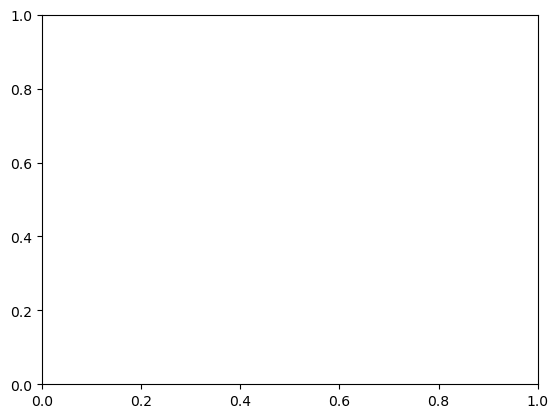

In [220]:
plt.imshow(np.array(id_nums)[np.lexsort((id_nums,prob_nums))][...,np.newaxis],cmap=color_map,interpolation='nearest',aspect='auto')

In [303]:
col_val = np.zeros((all_ids_clean_c.shape[0],1))
for i in range(np.sort(np.array(id_nums)).shape[0]):
    col_val[i] = color_map[np.sort(np.array(id_nums))[i]]

ValueError: could not convert string to float: '#1f77b4'

In [309]:
np.unique(np.array(prob_nums),return_counts=True)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 array([ 5, 62, 16, 38, 70, 63, 19, 44, 62, 63], dtype=int64))

In [312]:
np.array(prob_nums)[np.argsort(np.array(id_nums))].shape

(442,)

In [319]:
prob_id_map = np.zeros((all_ids_clean_c.shape[0],10))
for i in range(np.array(prob_nums)[np.argsort(np.array(id_nums))].shape[0]):
    prob_id_map[i,np.array(prob_nums)[np.argsort(np.array(id_nums))][i]-1] = 1

In [317]:
np.array(prob_nums)[np.argsort(np.array(id_nums))].shape[0]

442

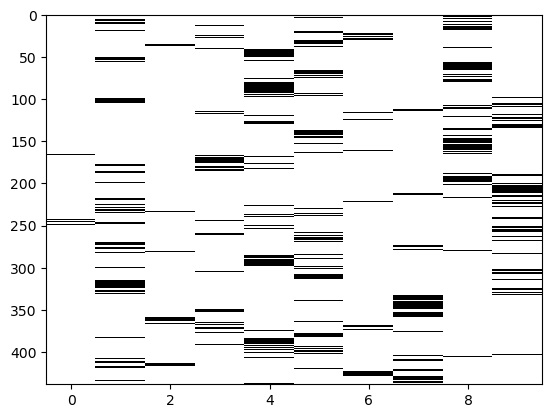

In [341]:
plt.imshow(prob_id_map[np.argsort(np.array(prob_nums)[np.argsort(np.array(id_nums))]),...],interpolation='nearest',aspect='auto',cmap='gray_r')

In [174]:
#OLD
bg_clean_o = bg_clean[np.argsort(np.array(id_nums)),...]
bg_clean_o_c = bg_clean_o[np.mean(all_ids_clean_o,axis=1)!=0]

In [204]:
bg_clean_o_c = bg_clean[np.argsort(np.array(id_nums)),...]
bg_clean_o_c.shape

(442, 1581)

In [943]:
from matplotlib import colors
divnorm=colors.TwoSlopeNorm(vcenter=0)

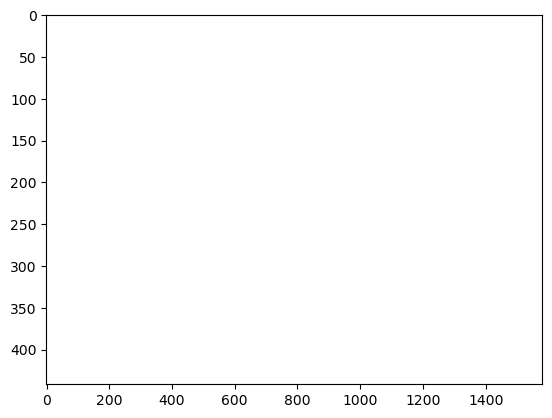

In [481]:
plt.imshow((all_ids_clean_o_c.T/np.max(all_ids_clean_o_c,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)#,vmin=-0.1,vmax=1.5)

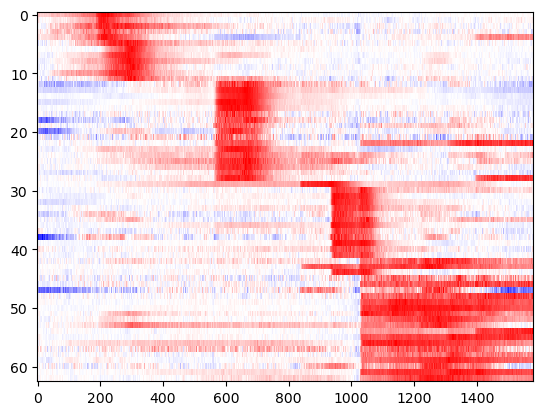

In [267]:
l=10
plt.imshow((all_ids_clean_o_c.T/np.max(all_ids_clean_o_c,axis=1))[...,np.array(prob_nums_o_c)==l].T,interpolation='nearest',aspect='auto',cmap='bwr')#,norm=divnorm)#,vmin=-0.1,vmax=1.5)

In [268]:
print(len(cnmf_dicts_id[l]['avp_rows']))
print(len(cnmf_dicts_id[l]['oxt_rows']))
print(len(cnmf_dicts_id[l]['5ht_rows']))
print(len(cnmf_dicts_id[l]['cck_rows']))
print(len(cnmf_dicts_id[l]['ne_rows']))
print(len(cnmf_dicts_id[l]['da_rows']))
print(len(cnmf_dicts_id[l]['ach_rows']))
print(len(cnmf_dicts_id[l]['atp_rows']))
print(len(cnmf_dicts_id[l]['mt_rows']))
print(len(cnmf_dicts_id[l]['ha_rows']))

0
5
7
0
17
0
3
13
18
0


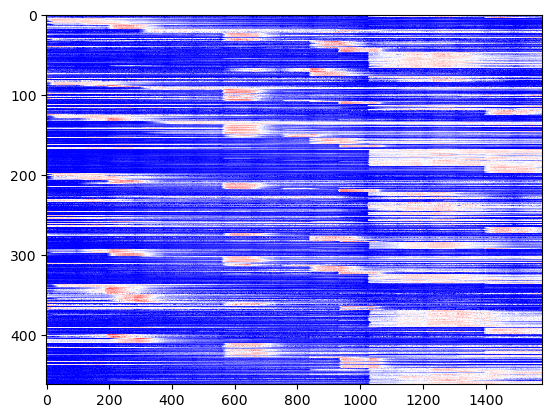

In [469]:
plt.imshow(all_ids_norm1,interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)#,vmax=1)

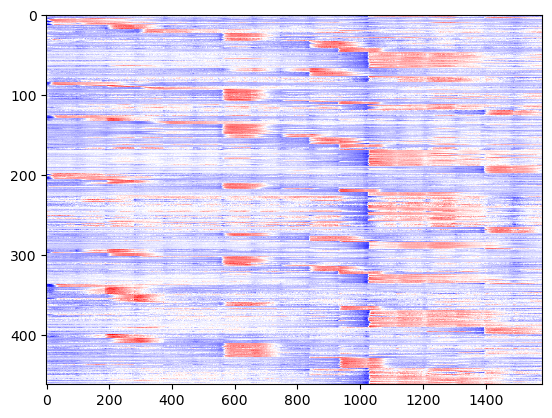

In [475]:
sample_rate = 31/60
def lowpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'lowpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def highpass(data: np.ndarray, cutoff: float, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'highpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data
def bandpass(data: np.ndarray, cutoff, sample_rate: float, poles: int = 5):
    sos = sg.butter(poles, cutoff, 'bandpass', fs=sample_rate, output='sos')
    filtered_data = scipy.signal.sosfiltfilt(sos, data)
    return filtered_data

times = np.arange(all_ids_norm1.shape[1])/sample_rate #[...,:936]

#filtered = lowpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate)
#filtered = cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400]-highpass(cnmf_dicts_invivo_ip[l]['CY_mov_matched_raw_corr_norm1'][hdbs_invivo.labels_==c,...][...,:2400], 1/600, sample_rate,1)
#filtered =  bandpass(CY_m_matched_raw_corr_norm1[...,:3000], [1/8000,1/50], sample_rate,1)
filtered2 = bandpass(all_ids_norm1, [1/2000,1/10], sample_rate,1) #[np.argsort(hdbs_invivo.labels_),...]

#from matplotlib import colors
#divnorm=colors.TwoSlopeNorm(vcenter=0)
#filtered_sort = np.sort(filtered,axis=1)
#filtered_b10 = np.mean(filtered_sort[:,:int(np.ceil(filtered_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
#filtered_t10 = np.mean(filtered_sort[:,-int(np.ceil(filtered_sort.shape[1]/10)):],axis=1)
#filtered_norm1 = ((filtered.T-filtered_b10)/(filtered_t10-filtered_b10)).T
#plt.imshow(filtered_norm1[np.argsort(rises),...],interpolation='nearest',aspect='auto',cmap='bwr')#,vmax=1)

filtered2_sort = np.sort(filtered2,axis=1)
filtered2_b10 = np.mean(filtered2_sort[:,:int(np.ceil(filtered2_sort.shape[1]/10))],axis=1) #[[x for x in np.arange(21).tolist() if x not in oxt_rm],...]
filtered2_t10 = np.mean(filtered2_sort[:,-int(np.ceil(filtered2_sort.shape[1]/10)):],axis=1)
filtered2_norm1 = ((filtered2.T-filtered2_b10)/(filtered2_t10-filtered2_b10)).T
plt.imshow(filtered2_norm1,interpolation='nearest',aspect='auto',cmap='bwr')

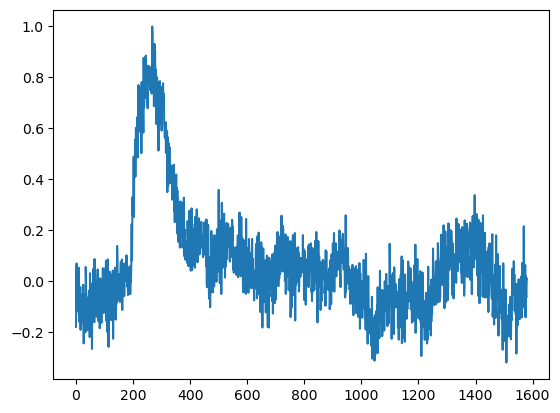

In [220]:
plt.plot((all_ids_clean_o_c.T/np.max(all_ids_clean_o_c,axis=1))[...,np.array(id_nums_o_c)==2][...,9])

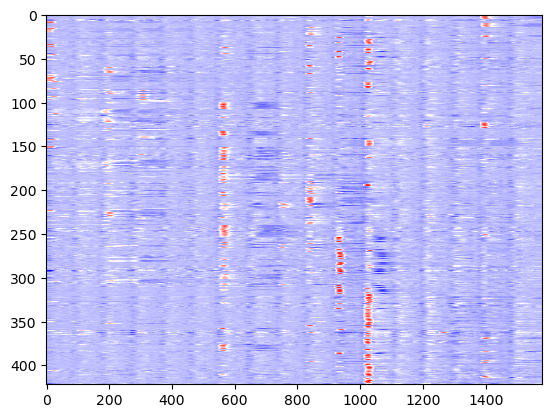

In [177]:
all_ids_clean_o_c_savs = list()
for id in range(all_ids_clean_o_c.shape[0]):
    sig_r = (all_ids_clean_o_c.T/np.max(all_ids_clean_o_c,axis=1))[...,id]
    all_ids_clean_o_c_savs.append(sg.savgol_filter(sig_r,30,1,deriv=1))
all_ids_clean_o_c_savs = np.array(all_ids_clean_o_c_savs)
plt.imshow(all_ids_clean_o_c_savs,interpolation='nearest',aspect='auto',cmap='bwr')

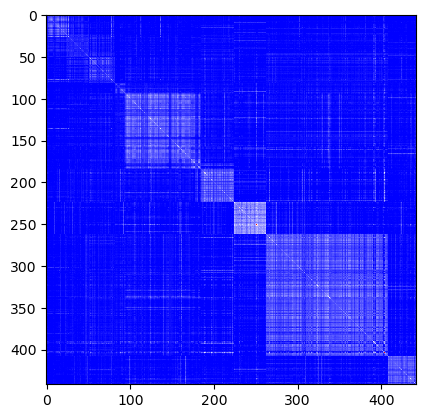

In [6093]:
plt.imshow(np.matmul(all_ids_clean_o_c_savs,all_ids_clean_o_c_savs.T),interpolation='nearest',cmap='bwr',vmin=0)

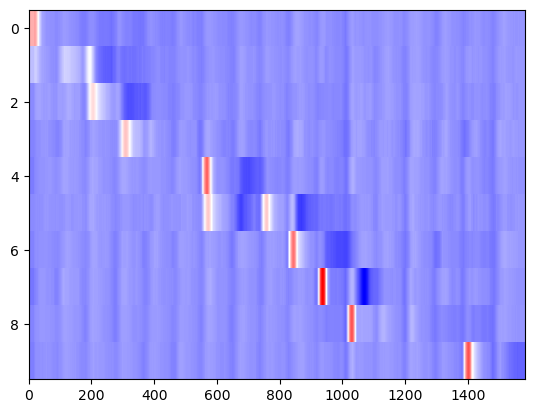

In [6101]:
cluster_savs = np.zeros((10,all_ids_clean_o_c_savs.shape[1]))
for clu in range(0,10):
    cluster_savs[clu,:] = np.mean(all_ids_clean_o_c_savs[np.array(id_nums_o_c)==clu+1,...],axis=0)
plt.imshow(cluster_savs, interpolation='nearest',aspect='auto',cmap='bwr')

In [9]:
plt.imshow(np.matmul(all_ids_clean_o_c_savs,cluster_savs.T),interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)

NameError: name 'all_ids_clean_o_c_savs' is not defined

In [6106]:
np.argmax(np.matmul(all_ids_clean_o_c_savs,cluster_savs.T)[5,...])

0

In [6108]:
id_nums_o_c[5]

1

In [6109]:
checks = []
for r in range(all_ids_clean_o_c_savs.shape[0]):
    if np.argmax(np.matmul(all_ids_clean_o_c_savs,cluster_savs.T)[r,...]) != id_nums_o_c[r]-1:
        checks.append(r)
checks

[10,
 26,
 31,
 32,
 33,
 38,
 63,
 78,
 80,
 92,
 180,
 306,
 308,
 310,
 316,
 391,
 393,
 395,
 403,
 404,
 408]

In [6182]:
well_onsets = 93*np.array([0,1,2,3,6,8,9,10,11,15])
well_onsets

array([   0,   93,  186,  279,  558,  744,  837,  930, 1023, 1395])

In [6181]:
well_onsets[id_nums_o_c[0]-1]

0

In [6205]:
checks2 = []
for r in range(all_ids_clean_o_c.shape[0]):
    if not (np.argmax(all_ids_clean_o_c[r,...]) >= well_onsets[id_nums_o_c[r]-1] and np.argmax(all_ids_clean_o_c[r,...]) <= well_onsets[id_nums_o_c[r]-1]+180):
        checks2.append(r)
checks2

[2,
 9,
 15,
 20,
 85,
 86,
 87,
 88,
 89,
 92,
 121,
 147,
 148,
 161,
 173,
 175,
 177,
 183,
 263,
 265,
 266,
 267,
 269,
 271,
 272,
 273,
 274,
 275,
 276,
 277,
 278,
 279,
 280,
 281,
 282,
 283,
 284,
 285,
 286,
 287,
 288,
 289,
 291,
 292,
 293,
 295,
 296,
 297,
 299,
 302,
 303,
 305,
 306,
 307,
 308,
 309,
 310,
 312,
 313,
 314,
 316,
 317,
 318,
 321,
 322,
 323,
 324,
 325,
 326,
 328,
 329,
 330,
 331,
 332,
 334,
 338,
 339,
 340,
 341,
 342,
 344,
 345,
 346,
 347,
 348,
 349,
 350,
 351,
 352,
 354,
 355,
 356,
 357,
 359,
 360,
 365,
 366,
 367,
 368,
 370,
 371,
 374,
 377,
 378,
 379,
 380,
 381,
 382,
 384,
 385,
 386,
 387,
 388,
 389,
 391,
 392,
 393,
 395,
 396,
 397,
 398,
 400,
 402,
 403,
 404,
 407,
 408,
 424,
 440]

In [6206]:
len(checks2)

129

In [6174]:
np.argmax(all_ids_clean_o_c[1,...])

C:\ProgramData\miniconda3\envs\caiman_curation\lib\site-packages\IPython\core\displayhook.py:281: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


95

In [6175]:
np.argmax(all_ids_clean_o_c[1,...]) >= 93*(id_nums_o_c[1]-1) and np.argmax(all_ids_clean_o_c[1,...]) <= 93*(id_nums_o_c[1])

False

In [6122]:
keep_checks = []

In [6150]:
i = 21
print(np.argmax(np.matmul(all_ids_clean_o_c_savs,cluster_savs.T)[checks[i],...])+1)
print(id_nums_o_c[checks[i]])
plt.plot(all_ids_clean_o_c[checks[i],...].T)

IndexError: list index out of range

In [6149]:
keep_checks.append(checks[i])

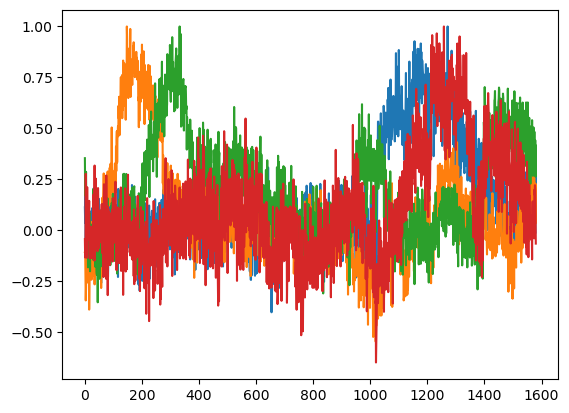

In [6274]:
j1 = 125
j2 = 130
plt.plot(((all_ids_clean_o_c.T/np.max(all_ids_clean_o_c,axis=1)).T)[np.array(checks2)[j1:j2],...].T)

In [6282]:
r1 = 129
plt.plot(all_ids_clean_o_c[np.array(checks2)[r1],...].T)

IndexError: index 129 is out of bounds for axis 0 with size 129

In [6281]:
keep_checks.append(checks2[r1])

In [6284]:
keep_checks2 = deepcopy(keep_checks)
keep_checks = []
tr = [keep_checks.append(x) for x in keep_checks2 if x not in keep_checks]
print(len(keep_checks))
keep_checks

14


[63, 306, 308, 391, 393, 395, 403, 404, 408, 266, 274, 392, 424, 440]

In [6290]:
to_change = []

In [6317]:
j=14
print(np.argmax(np.matmul(all_ids_clean_o_c_savs,cluster_savs.T)[keep_checks[j],...])+1)
print(id_nums_o_c[keep_checks[j]])
plt.plot(all_ids_clean_o_c[keep_checks[j],...].T)

IndexError: list index out of range

In [6316]:
to_change.append(keep_checks[j])

In [6334]:
len(to_change)
# 12 rows to change from all_ids_clean_o_c
# they correspond to probes and clusters in prob_nums_o_c and id_nums_o_c
# change their identities directly in their dicts? or just downstream, and keep a note of them somehow? dicts! then can update matched IDs in other movies
# also - toss out the 20 trashed cells and set their IDs to 0!

12

In [6337]:
to_trash = np.where(np.mean(all_ids_clean,axis=1)==0)[0].tolist()
len(to_trash)
# 20 rows to trash from all_ids_clean
# they correspond to probes and clusters in prob_nums and id_nums

20

In [7139]:
k = 12
print(prob_nums_o_c[to_change[k]])
id_nums_o_c[to_change[k]]

IndexError: list index out of range

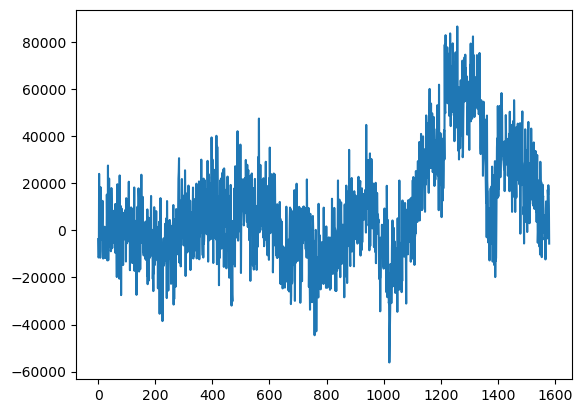

In [7133]:
plt.plot(all_ids_clean_o_c[to_change[k],...].T)

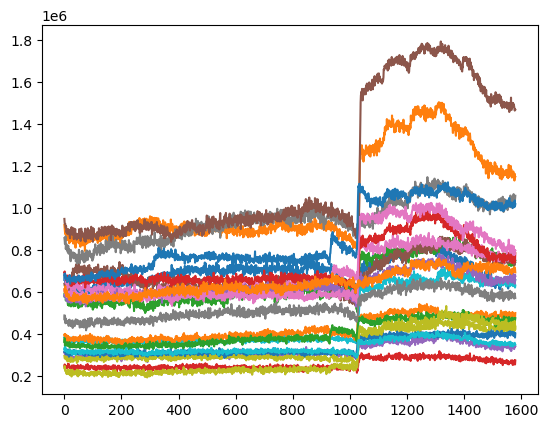

In [7134]:
plt.plot(cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['CY_matched_raw_corr'][cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['mt_rows'],...].T)

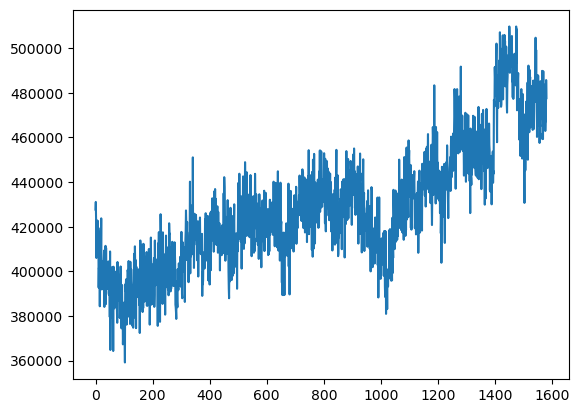

In [7015]:
m = 3
plt.plot(cnmf_dicts_id[prob_nums[to_trash[k]]]['CY_matched_raw_corr'][cnmf_dicts_id[prob_nums[to_trash[k]]]['ha_rows'][m],...].T)

In [7019]:
cnmf_dicts_id[prob_nums[to_trash[k]]]['ha_rows']

[35, 8, 73, 44, 77, 60, 95]

In [7017]:
cnmf_dicts_id[prob_nums[to_trash[k]]]['ha_rows'][m]

72

In [7018]:
cnmf_dicts_id[prob_nums[to_trash[k]]]['ha_rows'] = [x for x in cnmf_dicts_id[prob_nums[to_trash[k]]]['ha_rows'] if x != cnmf_dicts_id[prob_nums[to_trash[k]]]['ha_rows'][m]]

In [6812]:
save_dir = os.path.split(os.path.dirname(cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['cnmf_path']))[0]
save_path = os.path.join(save_dir, 'id_movie_row_ids.pickle')
fix = load_pickle(save_path)

In [6813]:
fix['avp_rows']

[34, 67, 41, 78, 18, 89, 61]

In [6811]:
prob_nums_o_c[to_change[k]]

6

In [6808]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['avp_rows'] = [x for x in cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['ha_rows'] if x!=cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['avp_rows'][m]]

In [6814]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['avp_rows'] = fix['avp_rows']

In [6810]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['ha_rows']

[35, 8, 73, 72, 44, 77, 60, 95]

In [6786]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['mt_rows']

[2,
 4,
 8,
 17,
 20,
 21,
 27,
 47,
 52,
 58,
 60,
 61,
 66,
 70,
 72,
 73,
 78,
 80,
 88,
 92,
 94,
 82]

In [6785]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['mt_rows'].append(cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['ha_rows'][m])

In [6787]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['ha_rows'] = [x for x in cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['ha_rows'] if x!=cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['ha_rows'][m]]

In [ ]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['avp_rows']

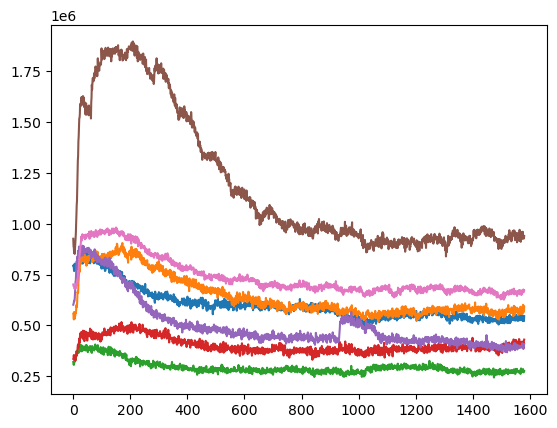

In [6816]:
plt.plot(cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['CY_matched_raw_corr'][cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['avp_rows'],...].T)

In [6771]:
cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['5ht_rows'] = [x for x in cnmf_dicts_id[prob_nums_o_c[to_change[k]]]['5ht_rows'] if x!=2]

In [6819]:
np.array(id_nums_o_c)[to_change]

array([ 3,  9,  9,  9,  9,  9,  9,  9,  9,  9, 10, 10])

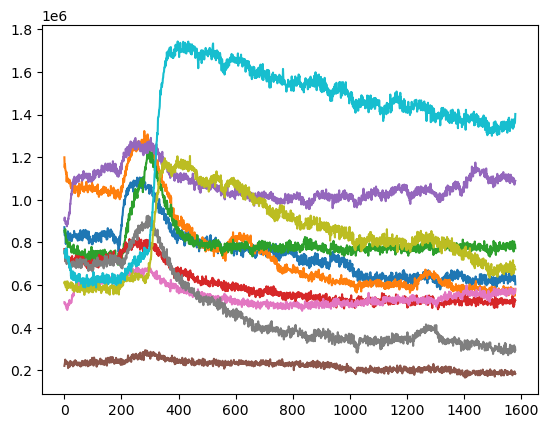

In [6069]:
plt.plot(all_ids[np.argsort(np.array(id_nums)),...][75:85,...].T)

In [7027]:
to_change

[63, 308, 391, 393, 395, 403, 404, 408, 266, 392, 424, 440]

In [7028]:
to_trash

[10,
 80,
 112,
 113,
 116,
 154,
 162,
 166,
 167,
 227,
 228,
 229,
 237,
 246,
 251,
 252,
 260,
 262,
 265,
 269]

In [ ]:
# 12 rows to change from all_ids_clean_o_c
# they correspond to probes and clusters in prob_nums_o_c and id_nums_o_c
# change their identities directly in their dicts? or just downstream, and keep a note of them somehow? dicts! then can update matched IDs in other movies
# also - toss out the 20 trashed cells and set their IDs to 0!
# 20 rows to trash from all_ids_clean
# they correspond to probes and clusters in prob_nums and id_nums

In [7135]:
# all that remains is to change id_nums_o_c (and then id_nums_c) with the changed identities
#k = 6
print(prob_nums_o_c[to_change[k]])
id_nums_o_c[to_change[k]]

9


10

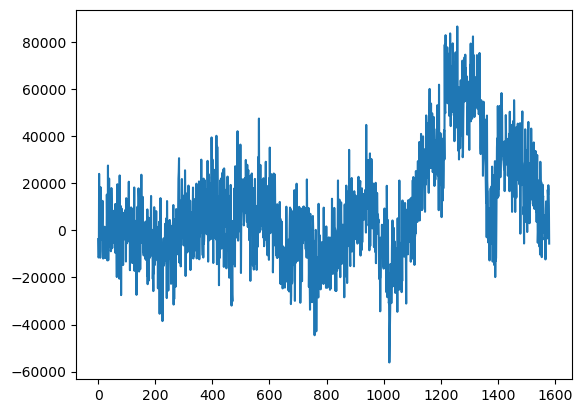

In [7136]:
plt.plot(all_ids_clean_o_c[to_change[k],...].T)

In [7137]:
id_nums_o_c[to_change[k]]

10

In [7138]:
id_nums_o_c[to_change[k]] = 9

In [7157]:
np.array(id_nums_o_c)

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  8,  8

In [269]:
id_nums_o_c = np.array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
        3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,
        4,  4,  4,  4,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
        5,  5,  5,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  6,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,  7,
        7,  7,  7,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,  8,
        8,  8,  8,  8,  8,  8,  8,  8,  9,  9,  9,  7,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  7,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,  9,
        2,  0,  3,  9,  7,  9,  9,  9,  9,  9,  9,  9,  2,  7,  9,  9,  9,
        2, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10,  3,
       10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10,  9, 10])

In [276]:
id_nums_o_c.shape

(442,)

In [270]:
all_ids_clean_o_c.shape

(442, 1581)

In [271]:
# finalize and save clean and reclassified datasets
all_ids_clean_o_c_f = all_ids_clean_o_c[np.array(id_nums_o_c)>0]
id_nums_o_c_f = np.array(id_nums_o_c)[np.array(id_nums_o_c)>0].tolist()
prob_nums_o_c_f = np.array(prob_nums_o_c)[np.array(id_nums_o_c)>0].tolist()
bg_clean_o_c_f = bg_clean_o_c[np.array(id_nums_o_c)>0]

In [272]:
all_ids_clean_o_c_f_i = all_ids_clean_o_c_f[np.lexsort((prob_nums_o_c_f,id_nums_o_c_f))]
all_ids_clean_o_c_f_p = all_ids_clean_o_c_f[np.lexsort((id_nums_o_c_f,prob_nums_o_c_f))]
bg_clean_o_c_f_i = bg_clean_o_c_f[np.lexsort((prob_nums_o_c_f,id_nums_o_c_f))]
bg_clean_o_c_f_p = bg_clean_o_c_f[np.lexsort((id_nums_o_c_f,prob_nums_o_c_f))]

In [273]:
all_ids_clean_o_c_f_pn = (all_ids_clean_o_c_f.T/np.max(all_ids_clean_o_c_f,axis=1)).T
all_ids_clean_o_c_f_i_pn = (all_ids_clean_o_c_f_i.T/np.max(all_ids_clean_o_c_f_i,axis=1)).T
all_ids_clean_o_c_f_p_pn = (all_ids_clean_o_c_f_p.T/np.max(all_ids_clean_o_c_f_p,axis=1)).T
all_ids_clean_o_c_f_dff = (all_ids_clean_o_c_f.T/np.mean(bg_clean_o_c_f[...,:93],axis=1)).T
all_ids_clean_o_c_f_i_dff = (all_ids_clean_o_c_f_i.T/np.mean(bg_clean_o_c_f_i[...,:93],axis=1)).T
all_ids_clean_o_c_f_p_dff = (all_ids_clean_o_c_f_p.T/np.mean(bg_clean_o_c_f_p[...,:93],axis=1)).T

C:\Users\Peter\AppData\Local\Temp\ipykernel_14632\1718893526.py:4: RuntimeWarning: divide by zero encountered in divide
  all_ids_clean_o_c_f_dff = (all_ids_clean_o_c_f.T/np.mean(bg_clean_o_c_f[...,:93],axis=1)).T
C:\Users\Peter\AppData\Local\Temp\ipykernel_14632\1718893526.py:5: RuntimeWarning: divide by zero encountered in divide
  all_ids_clean_o_c_f_i_dff = (all_ids_clean_o_c_f_i.T/np.mean(bg_clean_o_c_f_i[...,:93],axis=1)).T
C:\Users\Peter\AppData\Local\Temp\ipykernel_14632\1718893526.py:6: RuntimeWarning: divide by zero encountered in divide
  all_ids_clean_o_c_f_p_dff = (all_ids_clean_o_c_f_p.T/np.mean(bg_clean_o_c_f_p[...,:93],axis=1)).T


In [274]:
divnorm=colors.TwoSlopeNorm(vcenter=0.)

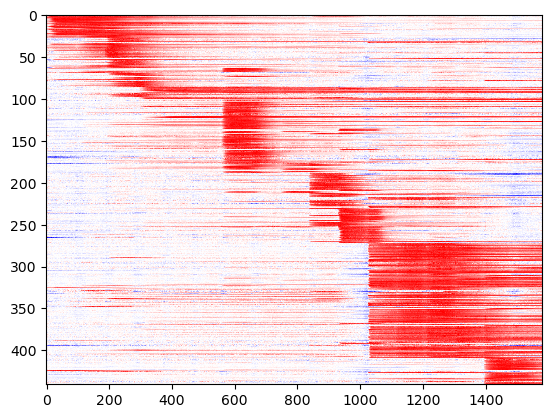

In [275]:
plt.imshow((all_ids_clean_o_c_f_i.T/np.max(all_ids_clean_o_c_f_i,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

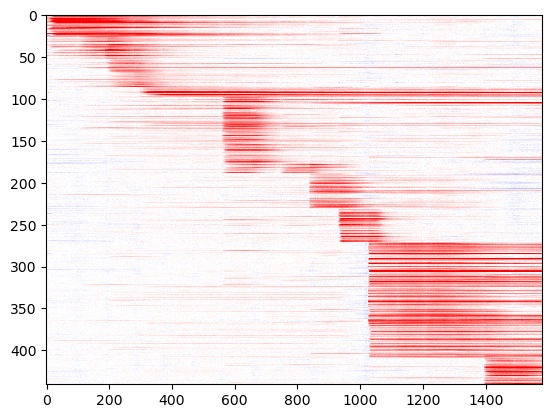

In [7215]:
plt.imshow((all_ids_clean_o_c_f_i.T/np.mean(bg_clean_o_c_f_i,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

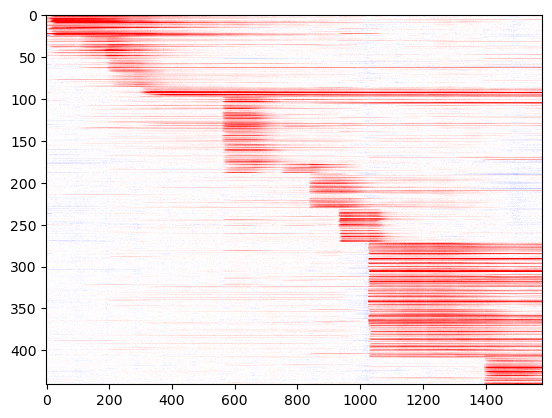

In [7216]:
plt.imshow((all_ids_clean_o_c_f_i.T/np.max(bg_clean_o_c_f_i,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

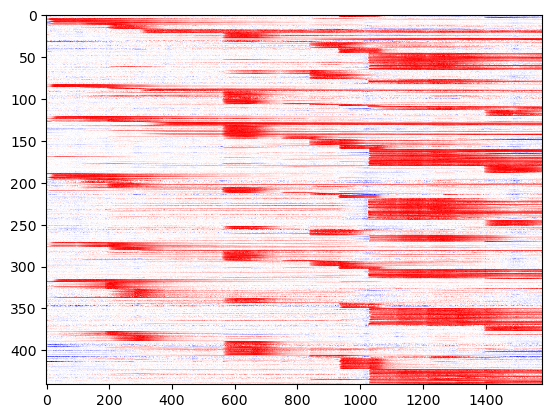

In [7217]:
plt.imshow((all_ids_clean_o_c_f_p.T/np.max(all_ids_clean_o_c_f_p,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

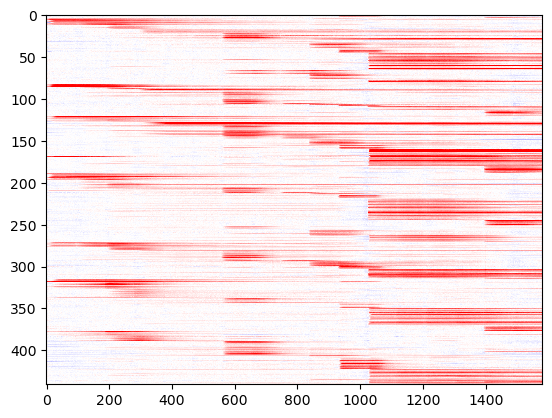

In [7218]:
plt.imshow((all_ids_clean_o_c_f_p.T/np.mean(bg_clean_o_c_f_p,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

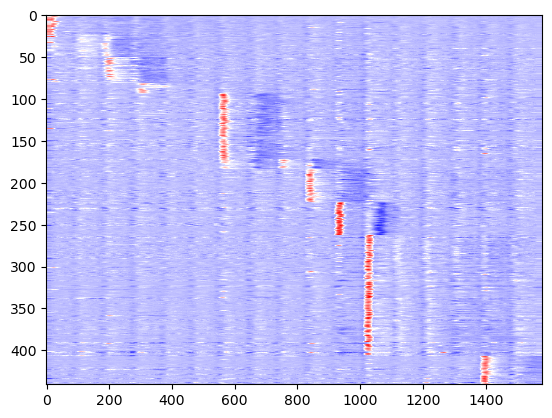

In [7220]:
all_ids_clean_o_c_f_savs = list()
for id in range(all_ids_clean_o_c_f.shape[0]):
    sig_r = (all_ids_clean_o_c_f.T/np.max(all_ids_clean_o_c_f,axis=1))[...,id]
    all_ids_clean_o_c_f_savs.append(sg.savgol_filter(sig_r,30,1,deriv=1))
all_ids_clean_o_c_f_savs = np.array(all_ids_clean_o_c_f_savs)
plt.imshow(all_ids_clean_o_c_f_savs,interpolation='nearest',aspect='auto',cmap='bwr')

In [7223]:
all_ids_clean_o_c_f_pear = np.zeros((all_ids_clean_o_c_f.shape[0],all_ids_clean_o_c_f.shape[0]))

In [7226]:
for i in trange(all_ids_clean_o_c_f.shape[0]):
    for j in range(all_ids_clean_o_c_f.shape[0]):
        all_ids_clean_o_c_f_pear[i,j] = scipy.stats.pearsonr(all_ids_clean_o_c_f[i,...],all_ids_clean_o_c_f[j,...])[0]

  0%|          | 0/441 [00:00<?, ?it/s]

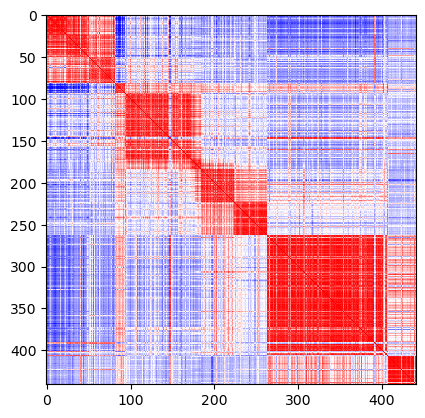

In [7227]:
plt.imshow(all_ids_clean_o_c_f_pear,interpolation='nearest',cmap='bwr')

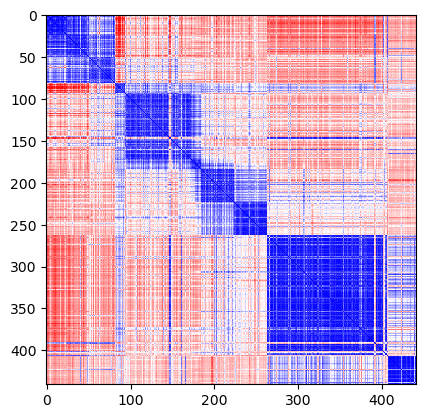

In [7228]:
plt.imshow(squareform(pdist(all_ids_clean_o_c_f,'correlation')), interpolation='nearest',cmap='bwr')

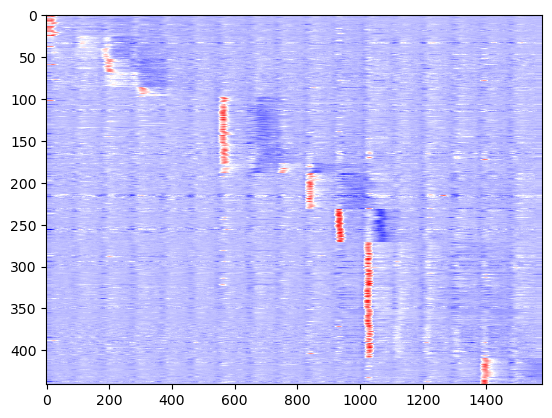

In [7231]:
all_ids_clean_o_c_f_i_savs = list()
for id in range(all_ids_clean_o_c_f_i.shape[0]):
    sig_r = (all_ids_clean_o_c_f_i.T/np.max(all_ids_clean_o_c_f_i,axis=1))[...,id]
    all_ids_clean_o_c_f_i_savs.append(sg.savgol_filter(sig_r,30,1,deriv=1))
all_ids_clean_o_c_f_i_savs = np.array(all_ids_clean_o_c_f_i_savs)
plt.imshow(all_ids_clean_o_c_f_i_savs,interpolation='nearest',aspect='auto',cmap='bwr')

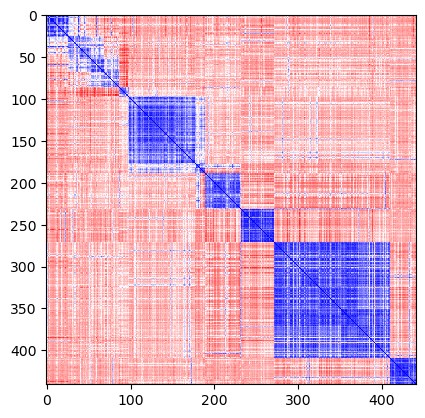

In [7236]:
plt.imshow(squareform(pdist(all_ids_clean_o_c_f_i_savs,'correlation')), interpolation='nearest',cmap='bwr')

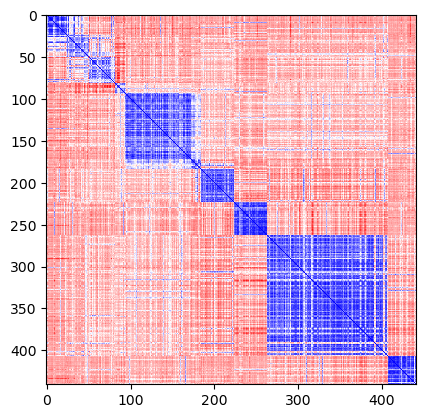

In [7237]:
plt.imshow(squareform(pdist(all_ids_clean_o_c_f_savs,'correlation')), interpolation='nearest',cmap='bwr')

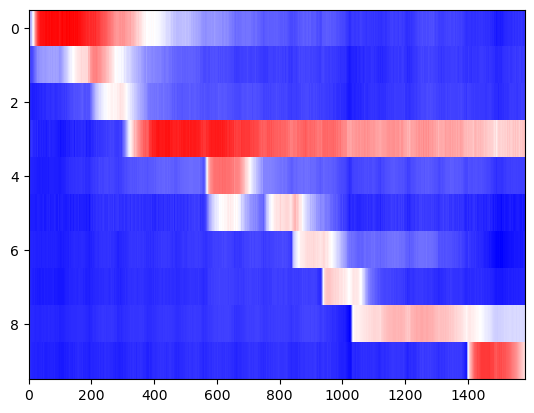

In [7243]:
cluster_timecourses_f = np.zeros((10,all_ids_clean_o_c_f.shape[1]))
for clu in range(0,10):
    cluster_timecourses_f[clu,:] = np.mean(all_ids_clean_o_c_f[np.array(id_nums_o_c_f)==clu+1,...],axis=0)
plt.imshow(cluster_timecourses_f, interpolation='nearest',aspect='auto',cmap='bwr')

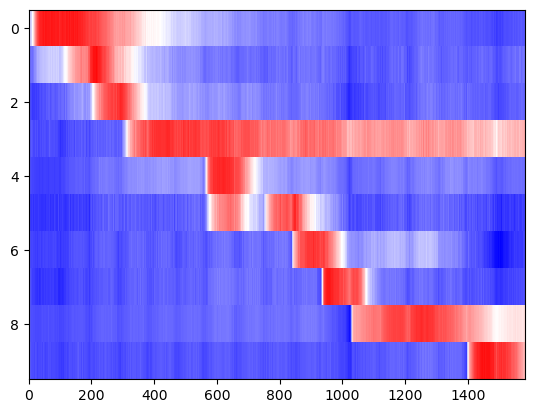

In [7245]:
cluster_timecourses_f_pn = np.zeros((10,all_ids_clean_o_c_f_pn.shape[1]))
for clu in range(0,10):
    cluster_timecourses_f_pn[clu,:] = np.mean(all_ids_clean_o_c_f_pn[np.array(id_nums_o_c_f)==clu+1,...],axis=0)
plt.imshow(cluster_timecourses_f_pn, interpolation='nearest',aspect='auto',cmap='bwr')

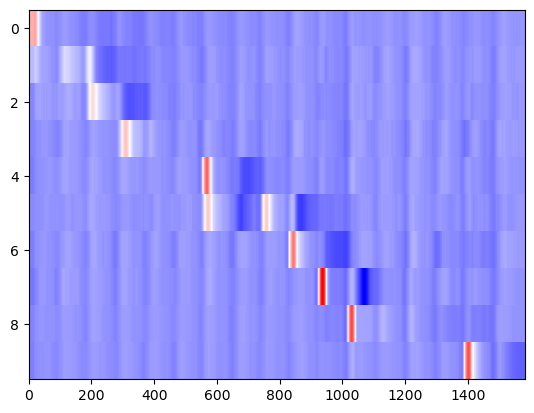

In [7246]:
cluster_timecourses_f_pn_savs = list()
for id in range(cluster_timecourses_f_pn.shape[0]):
    sig_r = cluster_timecourses_f_pn[id,...].T
    cluster_timecourses_f_pn_savs.append(sg.savgol_filter(sig_r,30,1,deriv=1))
cluster_timecourses_f_pn_savs = np.array(cluster_timecourses_f_pn_savs)
plt.imshow(cluster_timecourses_f_pn_savs,interpolation='nearest',aspect='auto',cmap='bwr')

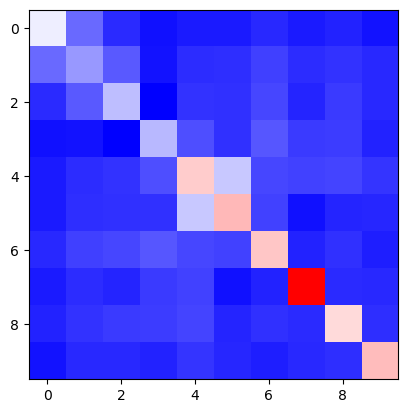

In [7272]:
plt.imshow(np.matmul(cluster_timecourses_f_pn_savs,cluster_timecourses_f_pn_savs.T), interpolation='nearest',cmap='bwr')

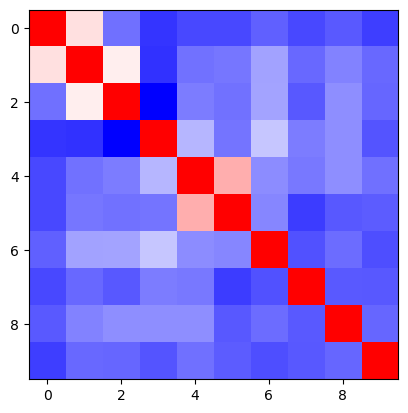

In [8230]:
plt.imshow(squareform(pdist(cluster_timecourses_f_pn_savs,'correlation')), interpolation='nearest',cmap='bwr_r')#,vmax=0.7)#,norm=divnorm)#,vmax=0.6)

In [7287]:
squareform(pdist(cluster_timecourses_f_pn_savs,'correlation'))

array([[0.        , 0.50920322, 0.90573654, 1.04326742, 0.99584272,
        0.99979887, 0.94107911, 0.99752121, 0.95751101, 1.02286605],
       [0.50920322, 0.        , 0.54499381, 1.04649899, 0.90370632,
        0.89344462, 0.79379705, 0.92691615, 0.86697753, 0.92528837],
       [0.90573654, 0.54499381, 0.        , 1.16380878, 0.88096668,
        0.90077768, 0.79018719, 0.96124407, 0.83948551, 0.92939444],
       [1.04326742, 1.04649899, 1.16380878, 0.        , 0.74680019,
        0.89801089, 0.71151436, 0.87793802, 0.83955507, 0.97077116],
       [0.99584272, 0.90370632, 0.88096668, 0.74680019, 0.        ,
        0.396508  , 0.84154123, 0.88844291, 0.84042081, 0.90650091],
       [0.99979887, 0.89344462, 0.90077768, 0.89801089, 0.396508  ,
        0.        , 0.85787887, 1.0247569 , 0.96071462, 0.95448778],
       [0.94107911, 0.79379705, 0.79018719, 0.71151436, 0.84154123,
        0.85787887, 0.        , 0.97667312, 0.91575125, 0.98518446],
       [0.99752121, 0.92691615, 0.9612440

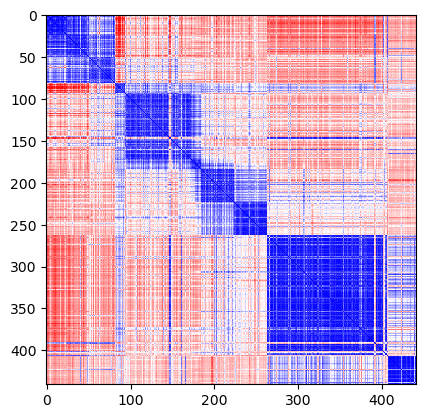

In [7288]:
plt.imshow(squareform(pdist(all_ids_clean_o_c_f_pn,'correlation')), interpolation='nearest',cmap='bwr')#,norm=divnorm)#,vmax=0.6)

In [7262]:
l=10
binary_ids = np.zeros((len(well_ids_id[l]),all_ids_clean_o_c_f_pn.shape[1]))
for i in range(len(well_ids_id[l])):
    binary_ids[i,well_onsets_id[l][i]:well_onsets_id[l][i]+3*mean_factor_id[l]] = 1

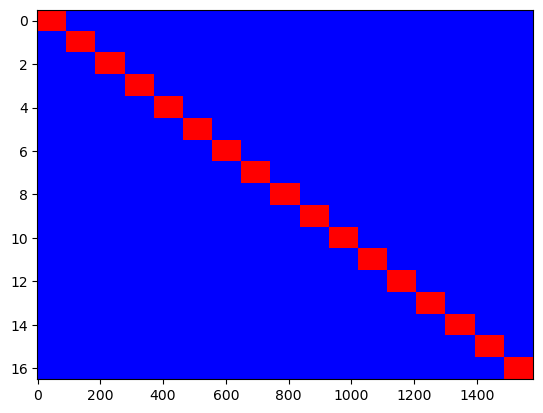

In [7264]:
plt.imshow(binary_ids, interpolation='nearest',aspect='auto',cmap='bwr')

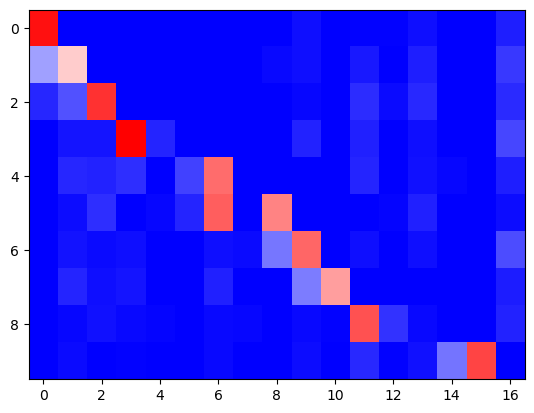

In [7290]:
plt.imshow(np.matmul(binary_ids,cluster_timecourses_f_pn_savs.T).T, interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)#,norm=divnorm)

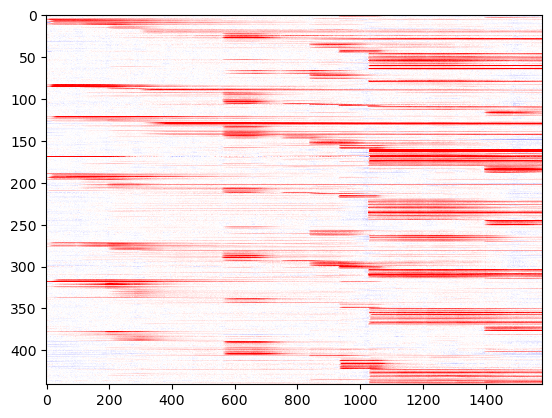

In [7271]:
plt.imshow(all_ids_clean_o_c_f_p_dff, interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)

In [7282]:
# use these to calculate peak dF/Fs, e.g. window post dip minus window pre? or use dF/F traces with bg correction straight up
well_onsets

array([   0,   93,  186,  279,  558,  744,  837,  930, 1023, 1395])

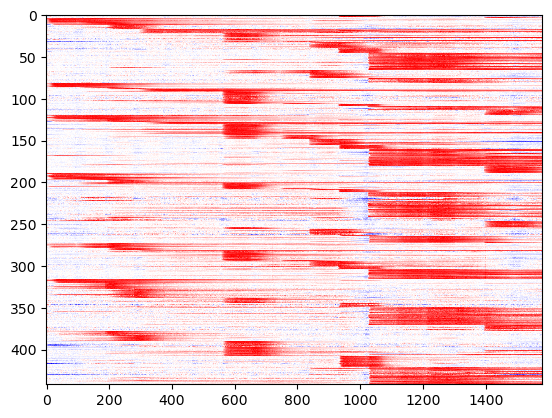

In [6061]:
plt.imshow((all_ids_clean_c.T/np.max(all_ids_clean_c,axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)#,vmin=-0.1,vmax=1.5)

C:\Users\Peter\AppData\Local\Temp\ipykernel_59236\1794828549.py:1: RuntimeWarning: invalid value encountered in divide
  plt.imshow((all_ids_clean[np.argsort(np.array(id_nums)),...].T/np.max(all_ids_clean[np.argsort(np.array(id_nums)),...],axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',vmin=-0.1,vmax=1.5)


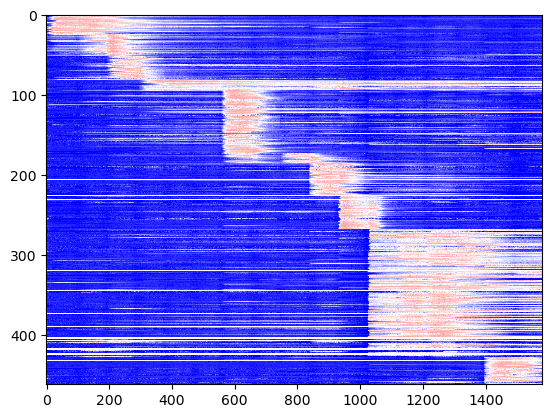

In [6017]:
plt.imshow((all_ids_clean[np.argsort(np.array(id_nums)),...].T/np.max(all_ids_clean[np.argsort(np.array(id_nums)),...],axis=1)).T,interpolation='nearest',aspect='auto',cmap='bwr',vmin=-0.1,vmax=1.5)

In [1]:
plt.imshow(all_ids_norm1[np.argsort(np.array(id_nums)),...],interpolation='nearest',aspect='auto',cmap='bwr',norm=divnorm)#,vmin=0)

NameError: name 'plt' is not defined

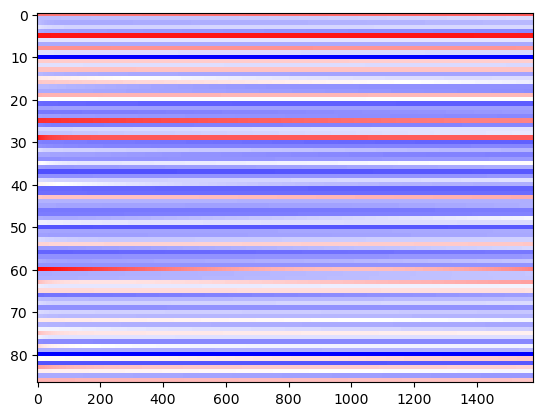

In [4163]:
plt.imshow(bg_clean[:r+1,...],interpolation='nearest',aspect='auto',cmap='bwr')

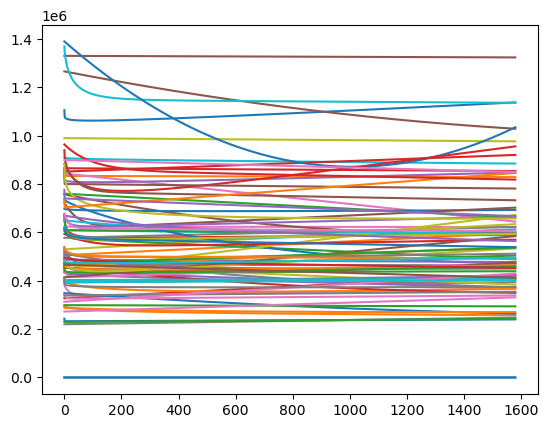

In [4164]:
plt.plot(bg_clean[:r+1,...].T)

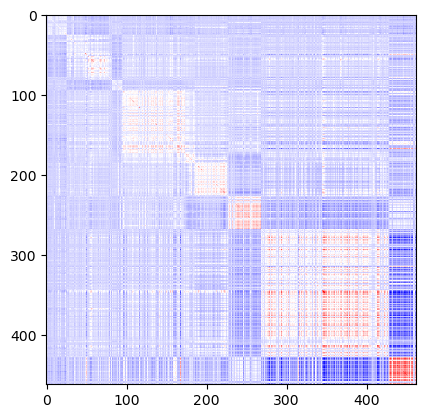

In [3392]:
plt.imshow(np.matmul(filtered[np.argsort(np.array(id_nums)),...],filtered[np.argsort(np.array(id_nums)),...].T),interpolation='nearest',cmap='bwr')

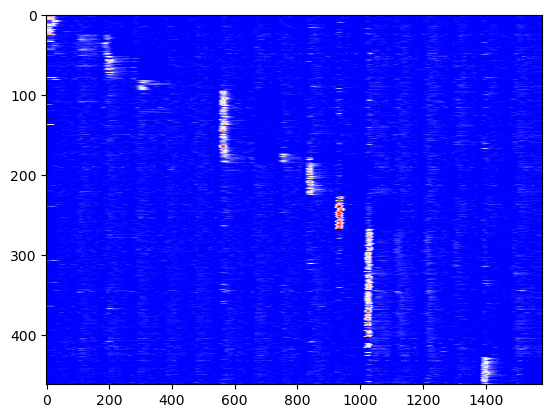

In [2842]:
plt.imshow(all_ids_savs[np.argsort(np.array(id_nums)),...],interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)

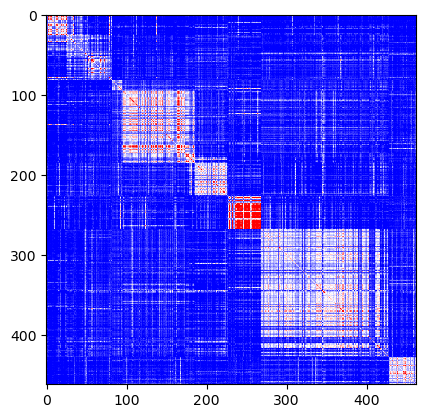

In [2850]:
plt.imshow(np.matmul(all_ids_savs[np.argsort(np.array(id_nums)),...],all_ids_savs[np.argsort(np.array(id_nums)),...].T),interpolation='nearest',cmap='bwr',vmin=0,vmax=0.04)

In [2863]:
all_ids_c = np.zeros((10,cnmf_dicts_id[1]['CY_matched_raw'].shape[1]))
for c in range(1,11):
    all_ids_c[c-1,:] = np.mean(all_ids[np.array(id_nums)==c,...],axis=0).T
all_ids_c.shape

(10, 1581)

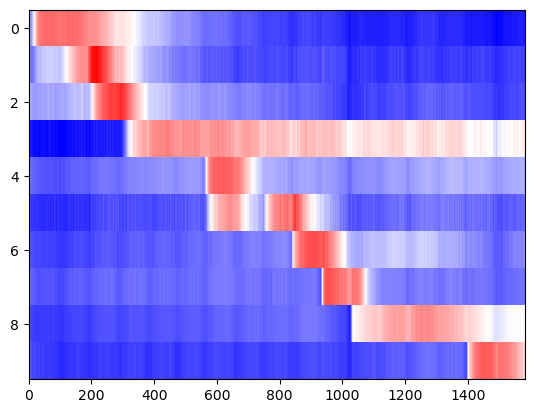

In [2864]:
plt.imshow(all_ids_c,interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)

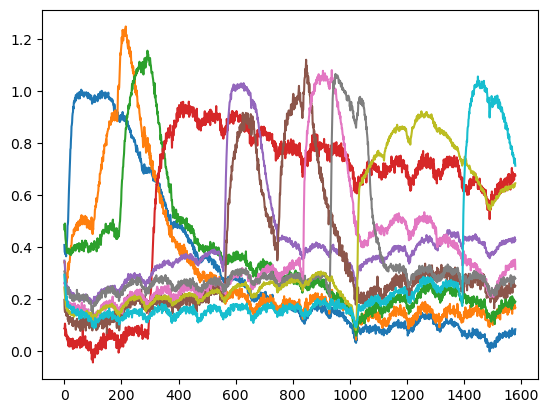

In [2885]:
plt.plot(all_ids_c.T)

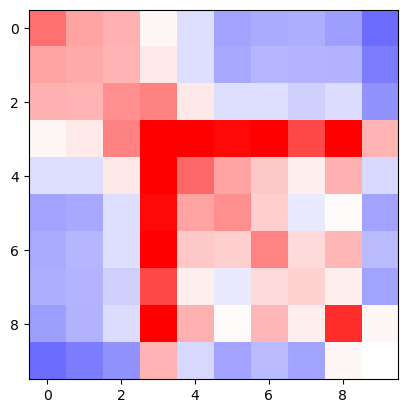

In [2880]:
plt.imshow(np.matmul(all_ids_c,all_ids_c.T),interpolation='nearest',cmap='bwr',vmin=0,vmax=400)

In [2881]:
all_ids_c_savs = list()
for id in range(all_ids_c.shape[0]):
    sig_r = all_ids_c[id,...].T
    all_ids_c_savs.append(sg.savgol_filter(sig_r,30,1,deriv=1))
    #rises.append(np.min(np.where(sav_test_m[:30,] == np.max(sav_test_m[:30,]))))
   #np.min(np.where(sav_test_r == np.max(sav_test_r))))
all_ids_c_savs = np.array(all_ids_c_savs)

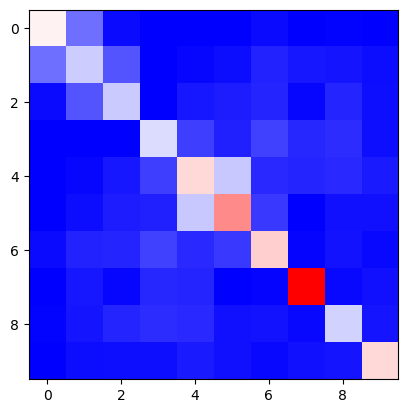

In [2884]:
plt.imshow(np.matmul(all_ids_c_savs,all_ids_c_savs.T),interpolation='nearest',cmap='bwr',vmin=0)

In [2889]:
# best case single movie
l = 5
cnmf_dicts_doses[l]['CY_matched_raw'].shape

(99, 1209)

In [2890]:
print(cnmf_dicts_id[l]['avp_rows'])
print(cnmf_dicts_id[l]['oxt_rows'])
print(cnmf_dicts_id[l]['5ht_rows'])
print(cnmf_dicts_id[l]['cck_rows'])
print(cnmf_dicts_id[l]['ne_rows'])
print(cnmf_dicts_id[l]['da_rows'])
print(cnmf_dicts_id[l]['ach_rows'])
print(cnmf_dicts_id[l]['atp_rows'])
print(cnmf_dicts_id[l]['mt_rows'])
print(cnmf_dicts_id[l]['ha_rows'])

[56, 82, 76, 53]
[90, 58, 71]
[87]
[19, 77, 6]
[33, 2, 3, 4, 70, 41, 43, 17, 49, 52, 28, 29, 62]
[89, 93, 37, 31]
[39, 42, 45, 14, 21, 88, 25, 63]
[97, 7, 8, 55, 24, 60, 61, 95]
[1, 10, 11, 12, 13, 15, 16, 18, 22, 34, 35, 36, 44, 46, 48, 80, 86, 91, 96, 98]
[0, 67, 5, 38, 47, 84, 85, 57, 27]


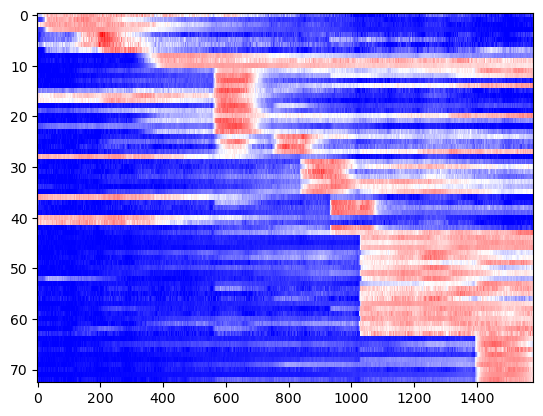

In [2892]:
plt.imshow(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][cnmf_dicts_id[l]['avp_rows']+cnmf_dicts_id[l]['oxt_rows']+cnmf_dicts_id[l]['5ht_rows']+cnmf_dicts_id[l]['cck_rows']+cnmf_dicts_id[l]['ne_rows']+cnmf_dicts_id[l]['da_rows']+cnmf_dicts_id[l]['ach_rows']+cnmf_dicts_id[l]['atp_rows']+cnmf_dicts_id[l]['mt_rows']+cnmf_dicts_id[l]['ha_rows'],...],interpolation='nearest',aspect='auto',cmap='bwr',vmin=0)

In [1124]:
# summary dose responses
dose_wells = [np.setdiff1d(np.arange(len(well_ids_doses[i])),wells_exclude_doses[i]) for i in range(len(movie_list_full))]
dose_wells[0] = dose_wells[0][0:13]
dose_wells[2] = dose_wells[2][0:13]

In [1125]:
dose_wells

[array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 array([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]),
 array([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]),
 array([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]),
 array([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24]),
 array([12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24])]

In [1126]:
# from here exclude movie 0
doses_by_ligand = [np.zeros((0,mean_factor_doses[1]*3*len(dose_wells[1])))]*10
for l in trange(1,len(movie_list_full)):
    for c in range(1,11):
        doses_by_ligand[c-1] = np.vstack((doses_by_ligand[c-1],cnmf_dicts_doses[l]['CY_matched_raw_corr'][np.array(row_ids[l][pythonic_list_doses[l]])==c,dose_wells[l][0]*3*mean_factor_doses[l]:(dose_wells[l][-1]+1)*3*mean_factor_doses[l]]))

  0%|          | 0/10 [00:00<?, ?it/s]

In [2007]:
ids_by_ligand_probeid = []
for l in trange(1,len(movie_list_full)):
    for c in range(1,11):
        doses_by = cnmf_dicts_doses[l]['CY_matched_raw_corr'][np.array(row_ids[l][pythonic_list_doses[l]])==c,dose_wells[l][0]*3*mean_factor_doses[l]:(dose_wells[l][-1]+1)*3*mean_factor_doses[l]]      
        ids_by_ligand_probeid = ids_by_ligand_probeid + [[l,c]]*doses_by.shape[0]
len(ids_by_ligand_probeid)

  0%|          | 0/10 [00:00<?, ?it/s]

431

In [1127]:
doses_by_ligand_by_movie = []
for l in trange(1,len(movie_list_full)):
    dbll = []
    for c in range(1,11):
        dbll.append(cnmf_dicts_doses[l]['CY_matched_raw_corr'][np.array(row_ids[l][pythonic_list_doses[l]])==c,dose_wells[l][0]*3*mean_factor_doses[l]:(dose_wells[l][-1]+1)*3*mean_factor_doses[l]])
    doses_by_ligand_by_movie.append(dbll)

  0%|          | 0/10 [00:00<?, ?it/s]

In [1128]:
dtally = 0
for i in range(10):
    print(doses_by_ligand[i].shape)
    dtally += doses_by_ligand[i].shape[0]
dtally

(26, 1209)
(31, 1209)
(30, 1209)
(12, 1209)
(77, 1209)
(14, 1209)
(40, 1209)
(38, 1209)
(134, 1209)
(29, 1209)


431

In [1145]:
all_doses_dirty = np.zeros((0,doses_by_ligand[0].shape[1]))
for i in range(10):
    all_doses_dirty = np.vstack((all_doses_dirty,doses_by_ligand[i]))
all_doses_dirty.shape

(431, 1209)

In [1141]:
all_doses_clean.shape

(308, 1209)

In [1142]:
doses_bg_clean.shape

(308, 1209)

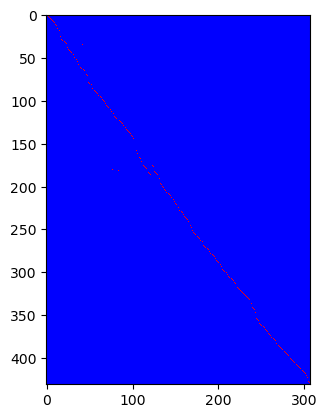

In [1146]:
plt.imshow(cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation')<0.001, interpolation='nearest',cmap='bwr')#,vmax=0.1)#,norm=divnorm)#,vmax=0.6)

In [1147]:
cmins_d = np.min(cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation'),axis=0)
cmins_d.shape

(308,)

In [1149]:
np.sum(cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation')<0.001)

306

In [1152]:
cdists_d = cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation')

In [1153]:
cminargs_d = []
for i in trange(cmins_d.shape[0]):
    cminargs_d += np.where(cdists_d[:,i]==cmins_d[i])[0].tolist()

  0%|          | 0/308 [00:00<?, ?it/s]

In [1191]:
len(cminargs_d)

308

In [1172]:
np.where(cmins_d>0.001)[0]

array([166, 201], dtype=int64)

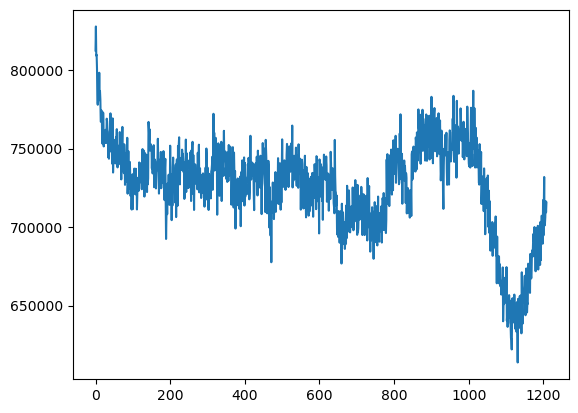

In [1308]:
plt.plot((all_doses_clean+doses_bg_clean)[201,...].T)

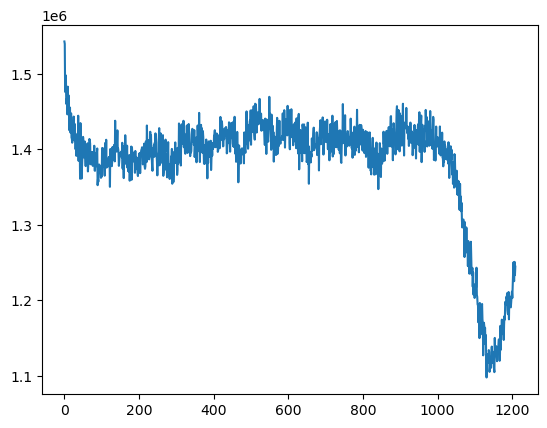

In [1306]:
plt.plot(all_doses_dirty[201,...].T)

In [1173]:
cutargs_d = np.where(cmins_d>0.00001)[0]
cutargs_d.shape

(2,)

In [1181]:
print(len([cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d]))
np.unique(np.array([cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d]),return_counts=True) #duplicates are DA cells!

306


(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  12,  13,
         16,  17,  19,  26,  28,  29,  30,  31,  32,  33,  34,  35,  38,
         39,  40,  41,  42,  43,  44,  45,  47,  49,  50,  52,  53,  55,
         58,  60,  61,  62,  63,  64,  65,  67,  70,  71,  79,  80,  81,
         82,  83,  86,  88,  89,  90,  91,  92,  93,  94,  95,  96,  97,
         99, 100, 101, 103, 104, 106, 107, 108, 109, 111, 112, 113, 115,
        119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 132,
        134, 135, 136, 137, 138, 139, 141, 142, 145, 151, 157, 158, 159,
        162, 166, 167, 168, 171, 172, 173, 176, 177, 178, 179, 180, 181,
        182, 183, 184, 185, 186, 187, 191, 192, 197, 198, 200, 202, 204,
        205, 206, 207, 208, 209, 210, 211, 213, 214, 215, 216, 218, 220,
        221, 222, 224, 225, 228, 229, 230, 231, 233, 235, 236, 237, 238,
        239, 241, 246, 247, 248, 252, 254, 255, 256, 257, 258, 259, 260,
        261, 263, 264, 265, 268, 269, 270, 271, 272

In [1180]:
np.where(np.unique(np.array([cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d]),return_counts=True)[1]==2)

(array([111, 112, 113, 118, 119, 120, 121, 122], dtype=int64),)

In [1223]:
np.unique(np.array([cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d]),return_counts=True)[0][111]

176

In [1224]:
np.where(np.array([cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d])==176)

(array([113, 123], dtype=int64),)

In [1309]:
doses_params_clean[166,...]

array([1.0, 1125974.6631092865, 0.7501288419798398, -620.7501724307127,
       1692199.1275155493, 710, 850, None, None, 558, 1116, 8, 12],
      dtype=object)

In [1310]:
doses_params_clean[201,...]

array([1.0, 32581.47238074935, 0.995, -2.4102118632801024,
       707538.1324098912, 650, 780, None, None, 558, 1116, 9, 23],
      dtype=object)

In [1214]:
all_doses_dirty.shape

(431, 1209)

In [1219]:
all_doses_dirty_cr = np.zeros((0,2))
for i in range(10):
    for j in range(len(doses_by_ligand[i])):
        all_doses_dirty_cr = np.vstack((all_doses_dirty_cr,np.array([i+1,j])))
all_doses_dirty_cr = all_doses_dirty_cr.astype('int')

In [1316]:
all_doses_dirty_cr.shape

(431, 2)

In [1230]:
all_doses_dirty_cr_kept = np.zeros((0,2))
for i in np.unique(np.array([cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d]),return_counts=True)[0].tolist():
    all_doses_dirty_cr_kept = np.vstack((all_doses_dirty_cr_kept,all_doses_dirty_cr[i,...]))
all_doses_dirty_cr_kept = all_doses_dirty_cr_kept.astype('int')

In [1262]:
all_doses_dirty_cr_skipped = np.array(list(set(map(tuple, all_doses_dirty_cr)) - set(map(tuple, all_doses_dirty_cr_kept))))
all_doses_dirty_cr_skipped = all_doses_dirty_cr_skipped[np.lexsort((all_doses_dirty_cr_skipped[...,1],all_doses_dirty_cr_skipped[...,0]))]

In [1263]:
all_doses_dirty_cr_skipped

array([[  1,  11],
       [  1,  14],
       [  1,  15],
       [  1,  18],
       [  1,  20],
       [  1,  21],
       [  1,  22],
       [  1,  23],
       [  1,  24],
       [  1,  25],
       [  2,   1],
       [  2,  10],
       [  2,  11],
       [  2,  20],
       [  2,  22],
       [  2,  25],
       [  2,  28],
       [  2,  30],
       [  3,   0],
       [  3,   2],
       [  3,   9],
       [  3,  11],
       [  3,  12],
       [  3,  15],
       [  3,  16],
       [  3,  17],
       [  3,  18],
       [  3,  19],
       [  3,  20],
       [  3,  21],
       [  3,  27],
       [  3,  28],
       [  4,   0],
       [  4,  11],
       [  5,   3],
       [  5,   6],
       [  5,  11],
       [  5,  15],
       [  5,  17],
       [  5,  18],
       [  5,  19],
       [  5,  32],
       [  5,  34],
       [  5,  41],
       [  5,  44],
       [  5,  45],
       [  5,  47],
       [  5,  48],
       [  5,  49],
       [  5,  50],
       [  5,  51],
       [  5,  53],
       [  5,

In [1264]:
all_doses_dirty_skipped = np.zeros((0,doses_by_ligand[0].shape[1]))
for i in range(all_doses_dirty_cr_skipped.shape[0]):
    all_doses_dirty_skipped = np.vstack((all_doses_dirty_skipped,doses_by_ligand[all_doses_dirty_cr_skipped[i,0]-1][all_doses_dirty_cr_skipped[i,1]]))
all_doses_dirty_skipped.shape

(133, 1209)

In [1271]:
all_doses_dirty_skipped_sort = np.sort(all_doses_dirty_skipped,axis=1)
all_doses_dirty_skipped_b10 = np.mean(all_doses_dirty_skipped_sort[:,:int(np.ceil(all_doses_dirty_skipped_sort.shape[1]/10))],axis=1) # bottom 10% mean
all_doses_dirty_skipped_t10 = np.mean(all_doses_dirty_skipped_sort[:,-int(np.ceil(all_doses_dirty_skipped_sort.shape[1]/10)):],axis=1) # top 10% mean
    
all_doses_dirty_skipped_dff = ((all_doses_dirty_skipped.T-all_doses_dirty_skipped_b10)/(all_doses_dirty_skipped_b10)).T
all_doses_dirty_skipped_norm1 = ((all_doses_dirty_skipped.T-all_doses_dirty_skipped_b10)/(all_doses_dirty_skipped_t10-all_doses_dirty_skipped_b10)).T

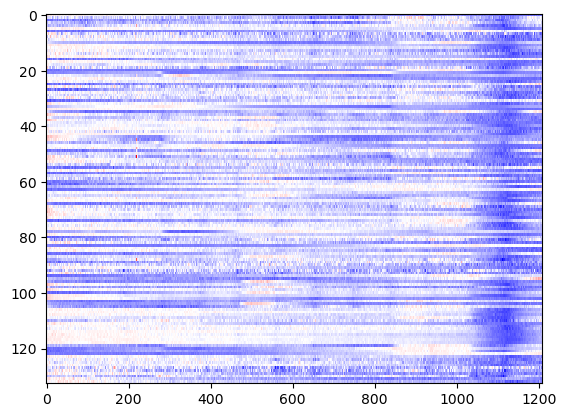

In [1273]:
plt.imshow(all_doses_dirty_skipped_norm1,interpolation='nearest',aspect='auto',cmap='bwr')

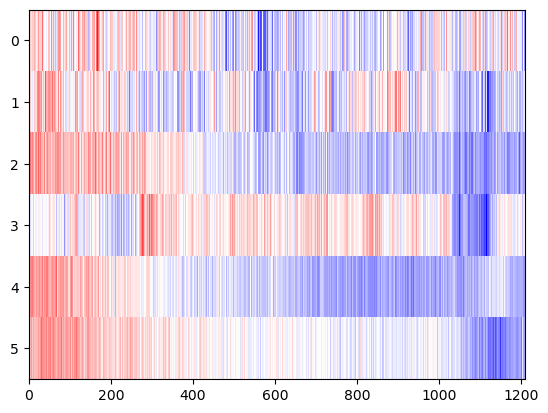

In [1302]:
c = 10
plt.imshow(all_doses_dirty_skipped_norm1[all_doses_dirty_cr_skipped[...,0]==c],interpolation='nearest',aspect='auto',cmap='bwr')

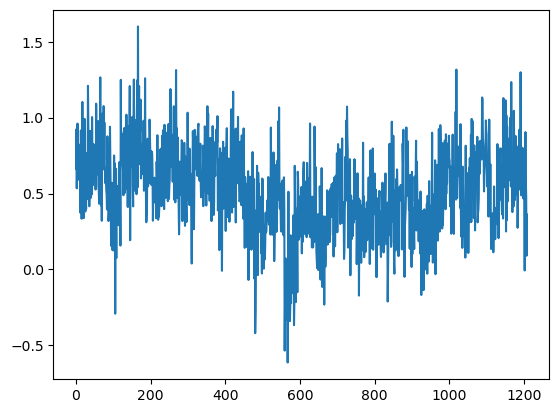

In [1303]:
r = 0
plt.plot(all_doses_dirty_skipped_norm1[all_doses_dirty_cr_skipped[...,0]==c][r,...].T)

In [1315]:
all_doses_dirty_cr_kept.shape

(298, 2)

In [1313]:
doses_params_clean[...,-2:].astype('int')

array([[  1,   0],
       [  1,   1],
       [  1,   2],
       [  1,   3],
       [  1,   4],
       [  1,   5],
       [  1,   6],
       [  1,   7],
       [  1,   8],
       [  1,   9],
       [  1,  10],
       [  1,  12],
       [  1,  13],
       [  1,  16],
       [  1,  17],
       [  1,  19],
       [  2,   0],
       [  2,   2],
       [  2,   3],
       [  2,   4],
       [  2,   5],
       [  2,   6],
       [  2,   7],
       [  2,   8],
       [  2,  11],
       [  2,  12],
       [  2,  13],
       [  2,  14],
       [  2,  15],
       [  2,  16],
       [  2,  17],
       [  2,  19],
       [  2,  21],
       [  2,  22],
       [  2,  24],
       [  2,  25],
       [  2,  27],
       [  3,   1],
       [  3,   3],
       [  3,   4],
       [  3,   5],
       [  3,   6],
       [  3,   7],
       [  3,   8],
       [  3,   9],
       [  3,  11],
       [  3,  12],
       [  3,  15],
       [  3,  16],
       [  3,  25],
       [  3,  26],
       [  3,  27],
       [  3,

In [ ]:
# 306 of 308 previously bg corrected dose responses match - throw out the 2 that don't and confirm that the rest have correct sensor identity


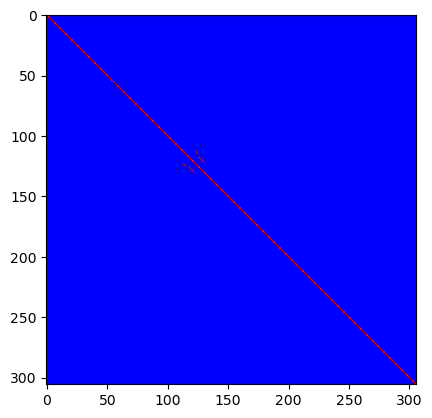

In [1318]:
plt.imshow(cdist(all_doses_dirty[[cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d],...],(all_doses_clean+doses_bg_clean)[[i for i in range(len(cminargs_d)) if i not in cutargs_d],...],'correlation')<0.001, interpolation='nearest',cmap='bwr')#,vmax=0.1)#,norm=divnorm)#,vmax=0.6)

In [1329]:
np.unique(doses_params_clean[[i for i in range(len(cminargs_d)) if i not in cutargs_d],...][...,-2:].astype('int')[...,0],return_counts=True)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 array([ 16,  21,  18,  10,  48,  18,  26,  24, 102,  23], dtype=int64))

In [1330]:
np.unique(all_doses_dirty_cr[[cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d],...][...,0],return_counts=True)

(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 array([ 16,  23,  16,  10,  46,  20,  26,  24, 102,  23], dtype=int64))

In [1331]:
all_doses_clean_trim = all_doses_clean[[i for i in range(len(cminargs_d)) if i not in cutargs_d],...]
doses_bg_clean_trim = doses_bg_clean[[i for i in range(len(cminargs_d)) if i not in cutargs_d],...]
doses_params_clean_trim = doses_params_clean[[i for i in range(len(cminargs_d)) if i not in cutargs_d],...]

In [1332]:
for i in range(all_doses_clean_trim.shape[0]):
    if doses_params_clean[[i for i in range(len(cminargs_d)) if i not in cutargs_d],...][...,-2:].astype('int')[i,0] != all_doses_dirty_cr[[cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d],...][i,0]:
        print([i,doses_params_clean[[i for i in range(len(cminargs_d)) if i not in cutargs_d],...][...,-2:].astype('int')[i,0],all_doses_dirty_cr[[cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d],...][i,0]])

[42, 3, 2]
[45, 3, 2]
[77, 5, 6]
[84, 5, 6]


In [ ]:
# 2 cells from 5ht to oxt - fine, same time dipping
# 2 cells from ne to da - check second dipping round!

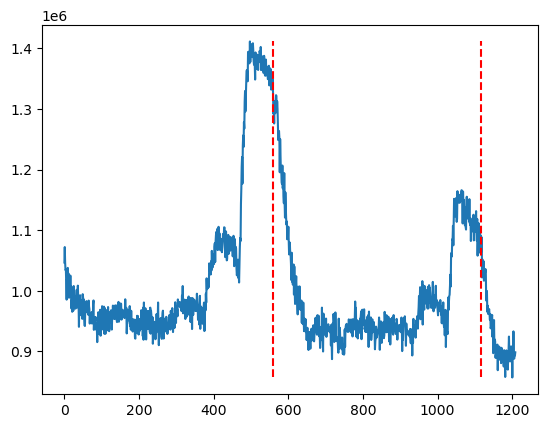

In [1373]:
plt.plot((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T)
plt.vlines(558,ymin=np.min((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),ymax=np.max((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),colors='r',linestyles='dashed')
plt.vlines(1116,ymin=np.min((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),ymax=np.max((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),colors='r',linestyles='dashed')

(887174.5174059644, 1349377.2274893292)

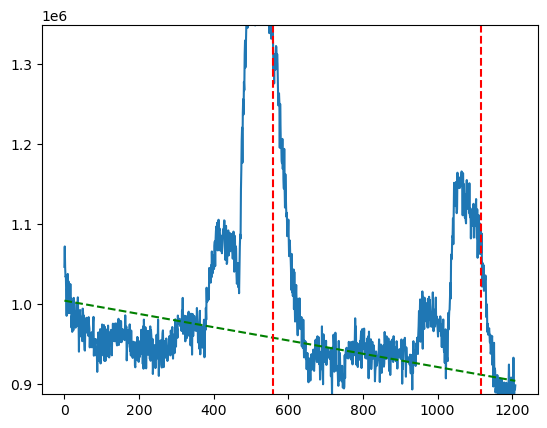

In [1383]:
start = 610
end = 900
blstart = None
blend = None
dosestart = 558
doseend = 1116
if blstart is not None:
    xdata = np.hstack((np.arange(start,blstart),np.arange(blend,end)))
else:
    xdata = np.arange(start,end)
popt, pcov = curve_fit(func, xdata, (all_doses_clean_trim+doses_bg_clean_trim)[84,xdata].T, bounds=([0,0,0,-np.inf,-np.inf], [np.inf,np.inf,1,np.inf,np.inf]), max_nfev = (all_doses_clean_trim+doses_bg_clean_trim).shape[1]*10000)
plt.plot((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T.T)
plt.plot(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt), 'g--',
         label='fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f, e=%5.3f' % tuple(popt))
plt.vlines(558,ymin=np.min((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),ymax=np.max((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),colors='r',linestyles='dashed')
plt.vlines(1116,ymin=np.min((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),ymax=np.max((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T),colors='r',linestyles='dashed')
ax = plt.gca()
ax.set_ylim([np.min((all_doses_clean_trim+doses_bg_clean_trim)[84,dosestart:doseend].T),np.max((all_doses_clean_trim+doses_bg_clean_trim)[84,dosestart:doseend].T)])

(-57569.94374035939, 391433.18149702356)

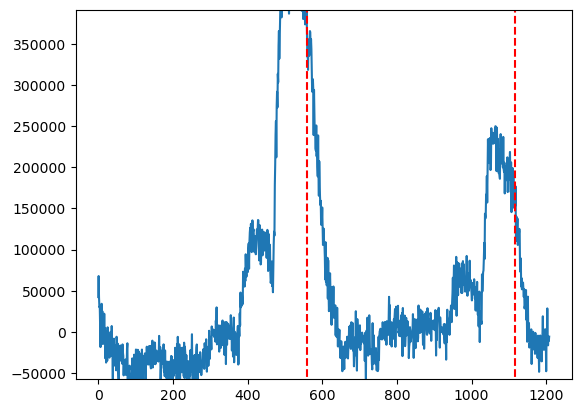

In [1385]:
plt.plot((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt))
plt.vlines(558,ymin=np.min((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt)),ymax=np.max((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt)),colors='r',linestyles='dashed')
plt.vlines(1116,ymin=np.min((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt)),ymax=np.max((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt)),colors='r',linestyles='dashed')
ax = plt.gca()
ax.set_ylim([np.min(((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt))[dosestart:doseend]),np.max(((all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt))[dosestart:doseend])])

In [1390]:
all_doses_clean_add = (all_doses_clean_trim+doses_bg_clean_trim)[84,...].T-func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt)
doses_bg_clean_add = func(np.arange((all_doses_clean_trim+doses_bg_clean_trim).shape[1]), *popt)
doses_params_clean_add = np.hstack((popt,start,end,blstart,blend,dosestart,doseend,6,26))
doses_params_clean_add

array([1.0, 6408.146843139537, 0.9949999999999999, -83.01625689296688,
       1004267.1173385811, 610, 900, None, None, 558, 1116, 6, 26],
      dtype=object)

In [1346]:
all_doses_clean_trim_da = np.zeros((0,doses_by_ligand[0].shape[1]))
for i in range(all_doses_clean_trim.shape[0]):
    if all_doses_dirty_cr[[cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d],...][i,0]==6:
        all_doses_clean_trim_da = np.vstack((all_doses_clean_trim_da,all_doses_clean_trim[i,...]))
all_doses_clean_trim_da.shape

(20, 1209)

In [1512]:
for i in range(all_doses_clean_trim.shape[0]-1):
    if all_doses_dirty_cr[[cminargs_d[i] for i in range(len(cminargs_d)) if i not in cutargs_d],...][i,0]==7:
        print([i,doses_params_clean_trim[i,-2:].astype('int')])
print([i+1,doses_params_clean_trim[i+1,-2:].astype('int')])

[131, array([7, 1])]
[132, array([7, 2])]
[133, array([7, 7])]
[134, array([7, 8])]
[135, array([ 7, 10])]
[136, array([ 7, 12])]
[137, array([ 7, 14])]
[138, array([ 7, 15])]
[139, array([ 7, 16])]
[140, array([ 7, 17])]
[141, array([ 7, 18])]
[142, array([ 7, 19])]
[143, array([ 7, 20])]
[144, array([ 7, 21])]
[145, array([ 7, 23])]
[146, array([ 7, 24])]
[147, array([ 7, 26])]
[148, array([ 7, 27])]
[149, array([ 7, 29])]
[150, array([ 7, 31])]
[151, array([ 7, 32])]
[152, array([ 7, 33])]
[153, array([ 7, 35])]
[154, array([ 7, 36])]
[155, array([ 7, 38])]
[156, array([ 7, 39])]
[306, array([ 6, 26])]


In [1387]:
doses_params_clean_trim[84,11] = 6

In [1506]:
doses_params_clean_trim[84,...]

array([99091.58311855566, 0.09682705722017416, 0.7670876559454685,
       -30.816692989912138, 955470.9458716222, 0, 300, None, None, 0, 558,
       6, 26], dtype=object)

In [1391]:
all_doses_clean_trim = np.vstack((all_doses_clean_trim,all_doses_clean_add))
doses_bg_clean_trim = np.vstack((doses_bg_clean_trim,doses_bg_clean_add))
doses_params_clean_trim = np.vstack((doses_params_clean_trim,doses_params_clean_add))

In [1516]:
doses_params_clean_trim.shape

(307, 13)

In [1397]:
# Finalized 9/10/2024
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_doses_clean_trim.npy',all_doses_clean_trim)
np.save(r'H:\CNMFoutputs\peter\mask_matching\doses_bg_clean_trim.npy',doses_bg_clean_trim)
np.save(r'H:\CNMFoutputs\peter\mask_matching\doses_params_clean_trim.npy',doses_params_clean_trim)

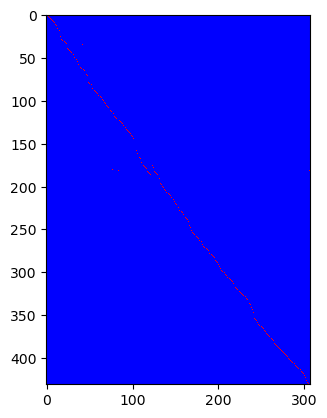

In [2013]:
plt.imshow(cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation')<0.001, interpolation='nearest',cmap='bwr')#,vmax=0.1)#,norm=divnorm)#,vmax=0.6)

In [2044]:
(cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation')<0.001).shape

(431, 307)

In [2029]:
clean_dirty_ref = np.zeros((all_doses_clean.shape[0]))
for i in trange(all_doses_clean.shape[0]):
    clean_dirty_ref[i] = np.where((cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation')<0.001)[...,i])[0]

  0%|          | 0/307 [00:00<?, ?it/s]

C:\Users\Peter\AppData\Local\Temp\ipykernel_14632\838410710.py:3: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  clean_dirty_ref[i] = np.where((cdist(all_doses_dirty,all_doses_clean+doses_bg_clean,'correlation')<0.001)[...,i])[0]


In [2034]:
clean_dirty_ref.astype('int')

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  12,  13,
        16,  17,  19,  26,  28,  29,  30,  31,  32,  33,  34,  39,  40,
        41,  42,  43,  44,  45,  47,  49,  50,  52,  53,  55,  58,  60,
        61,  62,  63,  35,  64,  65,  38,  67,  70,  71,  79,  80,  81,
        82,  83,  86,  88,  89,  90,  91,  92,  93,  94,  95,  96,  97,
        99, 100, 101, 103, 104, 106, 107, 108, 109, 111, 112, 113, 181,
       115, 119, 120, 121, 122, 123, 182, 124, 125, 126, 127, 128, 129,
       130, 132, 134, 135, 136, 137, 138, 139, 141, 142, 145, 151, 157,
       158, 159, 162, 166, 167, 168, 171, 172, 173, 176, 177, 178, 179,
       180, 183, 184, 185, 186, 187, 176, 177, 178, 183, 184, 185, 186,
       187, 191, 192, 197, 198, 200, 202, 204, 205, 206, 207, 208, 209,
       210, 211, 213, 214, 215, 216, 218, 220, 221, 222, 224, 225, 228,
       229, 230, 231, 233, 235, 236, 237, 238, 239, 241, 246, 247, 248,
       252, 254, 255, 256, 257, 258, 259, 260, 261, 263, 264, 26

In [2042]:
np.array(ids_by_ligand_probeid)[clean_dirty_ref.astype('int'),...].shape

(307, 2)

In [2046]:
np.save(r'H:\CNMFoutputs\peter\mask_matching\ids_by_ligand_probeid.npy',np.array(ids_by_ligand_probeid)[clean_dirty_ref.astype('int'),...])
ids_by_ligand_probeid = np.array(ids_by_ligand_probeid)[clean_dirty_ref.astype('int'),...]

In [2049]:
ids_by_ligand_probeid[0,...]

array([1, 7])

In [2062]:
masks_by_ligand_probeid = []
for l in trange(1,len(movie_list_full)):
    for c in range(1,11):
        masks_by_ligand_probeid = masks_by_ligand_probeid + list(cnmf_dicts_doses[l]['spcomps_matched_raw'][np.array(row_ids[l][pythonic_list_doses[l]])==c,...])  
len(masks_by_ligand_probeid)

  0%|          | 0/10 [00:00<?, ?it/s]

C:\ProgramData\miniconda3\envs\caiman_curation\lib\site-packages\IPython\core\displayhook.py:281: UserWarning: Output cache limit (currently 1000 entries) hit.
Flushing oldest 200 entries.
  warn('Output cache limit (currently {sz} entries) hit.\n'


431

In [2064]:
masks_by_ligand_probeid_l = [masks_by_ligand_probeid[i] for i in clean_dirty_ref.astype('int')]

In [2066]:
save_path_m = r'H:\CNMFoutputs\peter\mask_matching\masks_by_ligand_probeid_l.pickle'
    
with open(save_path_m, 'wb') as f:
    pickle.dump(masks_by_ligand_probeid_l, f)

In [3159]:
# dose response curves are doable and will work out
## but for some ligands, too few cells so need to be careful/do good baseline corrections one by one (at least linear fits locally)
## and for others, there are a lot of cells so need to trash bad ones systematically (time consuming)
## after all this is done - tau fits will be easy (but some movies won't have enough/any examples) - do this on mean trace per cell? error propagation??

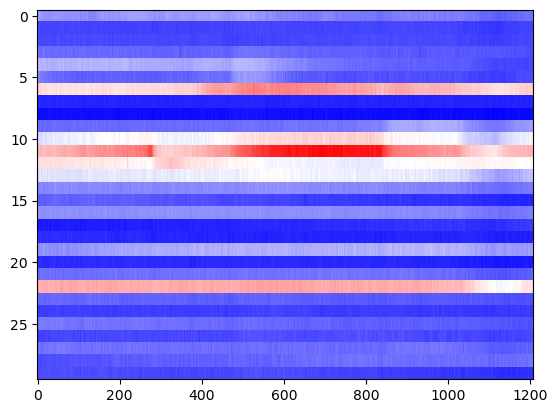

In [1130]:
c=3
plt.imshow(doses_by_ligand[c-1],interpolation='nearest',aspect='auto',cmap='bwr')

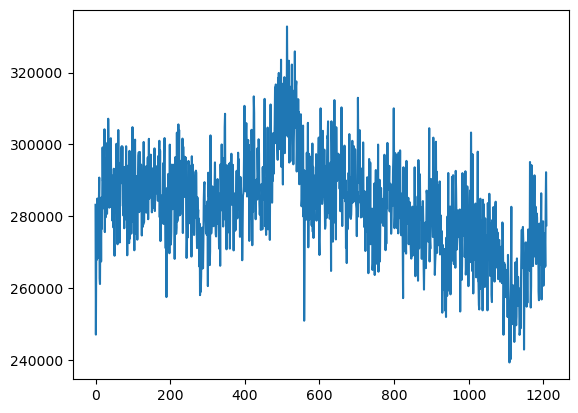

In [1139]:
r = 8
plt.plot(doses_by_ligand[c-1][r,...].T)

In [ ]:
# 0:558 - first group of 6
# 558:1116 - second group of 6 (da used in both)
# make a summary corrected dose-response peak-normalized dataset - each good cell for each sensor with good baseline fit a-la Ryann's paper
# baseline can be linear or exponential (+/- stretched?)
# save parameters for each fit so they can be recovered!

In [ ]:
# fit bg subtraction to each individual raw curve - then peak-normalize
# need to save parameters

In [7352]:
all_doses_clean = np.zeros((0,doses_by_ligand[0].shape[1]))
doses_bg_clean = np.zeros(all_doses_clean.shape)
doses_params_clean = np.zeros((all_doses_clean.shape[0],13)) # 5 fit parameters plus start/end and blstart/blend plus plus dosestart/doseend plus ligand id plus row

In [1375]:
from scipy.optimize import curve_fit
def func(x, a, b, c, d, e):
    a=0
    return a * np.exp(-b * (x**c)) + d*x + e

In [10762]:
c=10
r=30
plt.plot(doses_by_ligand[c-1][r,...].T)
plt.vlines(558,ymin=np.min(doses_by_ligand[c-1][r,...].T),ymax=np.max(doses_by_ligand[c-1][r,...].T),colors='r',linestyles='dashed')
plt.vlines(1116,ymin=np.min(doses_by_ligand[c-1][r,...].T),ymax=np.max(doses_by_ligand[c-1][r,...].T),colors='r',linestyles='dashed')

IndexError: index 30 is out of bounds for axis 0 with size 30

(444474.38452396035, 686277.4356222716)

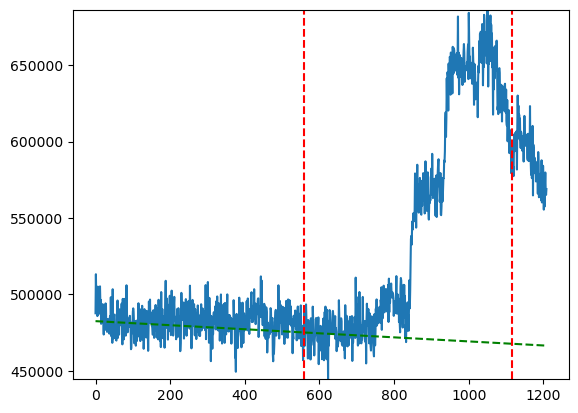

In [10758]:
start = 560
end = 633
blstart = None
blend = None
dosestart = 558
doseend = 1116
if blstart is not None:
    xdata = np.hstack((np.arange(start,blstart),np.arange(blend,end)))
else:
    xdata = np.arange(start,end)
popt, pcov = curve_fit(func, xdata, doses_by_ligand[c-1][r,xdata].T, bounds=([0,0,0,-np.inf,-np.inf], [np.inf,np.inf,1,np.inf,np.inf]), max_nfev = doses_by_ligand[c-1].shape[1]*10000)
plt.plot(doses_by_ligand[c-1][r,...].T.T)
plt.plot(np.arange(doses_by_ligand[c-1].shape[1]), func(np.arange(doses_by_ligand[c-1].shape[1]), *popt), 'g--',
         label='fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f, e=%5.3f' % tuple(popt))
plt.vlines(558,ymin=np.min(doses_by_ligand[c-1][r,...].T),ymax=np.max(doses_by_ligand[c-1][r,...].T),colors='r',linestyles='dashed')
plt.vlines(1116,ymin=np.min(doses_by_ligand[c-1][r,...].T),ymax=np.max(doses_by_ligand[c-1][r,...].T),colors='r',linestyles='dashed')
ax = plt.gca()
ax.set_ylim([np.min(doses_by_ligand[c-1][r,dosestart:doseend].T),np.max(doses_by_ligand[c-1][r,dosestart:doseend].T)])

(-29772.50717162498, 217692.5875488798)

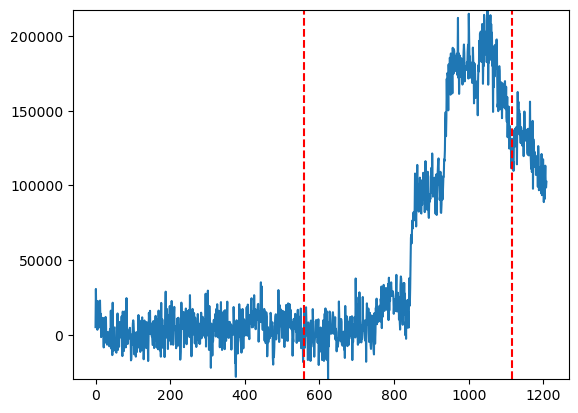

In [10759]:
plt.plot(doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt))
plt.vlines(558,ymin=np.min(doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt)),ymax=np.max(doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt)),colors='r',linestyles='dashed')
plt.vlines(1116,ymin=np.min(doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt)),ymax=np.max(doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt)),colors='r',linestyles='dashed')
ax = plt.gca()
ax.set_ylim([np.min((doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt))[dosestart:doseend]),np.max((doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt))[dosestart:doseend])])

In [10760]:
trash = False
if not trash:
    all_doses_clean = np.vstack((all_doses_clean,doses_by_ligand[c-1][r,...].T-func(np.arange(doses_by_ligand[c-1].shape[1]), *popt)))
    doses_bg_clean = np.vstack((doses_bg_clean,func(np.arange(doses_by_ligand[c-1].shape[1]), *popt)))
    doses_params_clean = np.vstack((doses_params_clean,np.hstack((popt,start,end,blstart,blend,dosestart,doseend,c,r))))
else:
    all_doses_clean = np.vstack((all_doses_clean,np.zeros(doses_by_ligand[c-1].shape[1])))
    doses_bg_clean = np.vstack((doses_bg_clean,np.zeros(doses_by_ligand[c-1].shape[1])))
    doses_params_clean = np.vstack((doses_params_clean,np.zeros(13)))

In [2010]:
all_doses_clean.shape

(307, 1209)

In [10763]:
doses_params_clean

array([[239593.3951003187, 0.14946080901562186, 0.4357402589949293, ...,
        558, 1, 0],
       [46998.19390064368, 0.16149086601792517, 0.7074423736134666, ...,
        558, 1, 1],
       [70478.39383349333, 0.16764862238387113, 0.6055491144430074, ...,
        558, 1, 2],
       ...,
       [1.0, 12854.998717933166, 0.004974999999999952, ..., 1116, 10, 27],
       [1.0, 399156.2033643002, 0.004999999999999893, ..., 1116, 10, 28],
       [1.0, 22723.499940947768, 0.9950000000000001, ..., 1116, 10, 29]],
      dtype=object)

In [11633]:
all_doses_clean[doses_params_clean[...,11]==9,558:1116].shape

(103, 558)

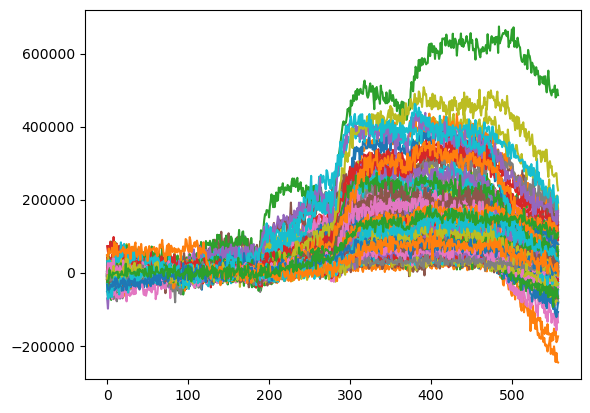

In [11615]:
plt.plot(all_doses_clean[doses_params_clean[...,11]==9,558:1116].T)

In [39]:
mt_probeids = []
for l in range(len(doses_by_ligand_by_movie)):
    mt_probeids += [l]*len(doses_by_ligand_by_movie[l][8])
    print(len(doses_by_ligand_by_movie[l][8]))

0
21
5
5
20
27
7
11
22
18


In [40]:
doses_params_clean[(doses_params_clean[...,11]==9),12].shape[0]

103

In [41]:
mt_probeids_clean = []
for m in range(doses_params_clean[(doses_params_clean[...,11]==9),12].shape[0]):
    mt_probeids_clean.append(mt_probeids[doses_params_clean[(doses_params_clean[...,11]==9),12][m]])

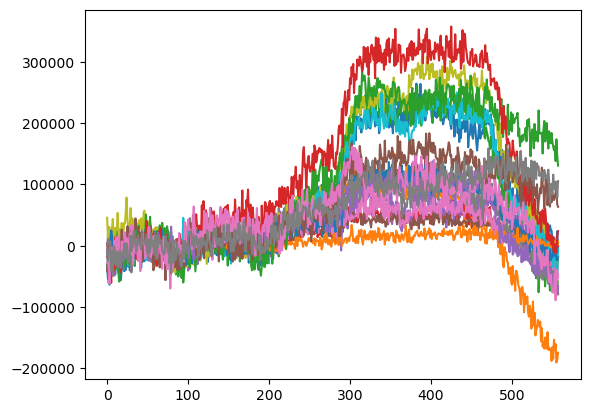

In [42]:
p = 1
plt.plot(all_doses_clean[(doses_params_clean[...,11]==9),558:1116][(np.array(mt_probeids_clean)==p),...].T)

In [ ]:
# start by subdividing traces and creating a single dataset of each id concentrations 1-6 (twice for da) peak-normalized
# observe and set a common zero well for each trace (e.g. without any starting artifact):
# clu 1 avp: well 2 (onset 93)
# clu 2 oxt: well 3 (onset 186)
# clu 3 5ht: well 2 (onset 93)
# clu 4 cck: well 3 (onset 186)
# clu 5 ne: well 2 (onset 93)
# clu 6 da (ne): well 3 (onset 186)
# clu 6 da (da): well 3 (onset 744, use lowest 1/3 for zero!)
# clu 7 ach: well 1 (onset 558)
# clu 8 atp: well 2 (onset 651)
# clu 9 mt: well 1 (onset 558)
# clu 10 ha: well 1 (onset 558)
# cut them all down to the same 0:558 range of six wells

In [1398]:
all_doses_clean = np.load(r'H:\CNMFoutputs\peter\mask_matching\all_doses_clean_trim.npy',allow_pickle=True)
doses_bg_clean = np.load(r'H:\CNMFoutputs\peter\mask_matching\doses_bg_clean_trim.npy',allow_pickle=True)
doses_params_clean = np.load(r'H:\CNMFoutputs\peter\mask_matching\doses_params_clean_trim.npy',allow_pickle=True)

In [1517]:
doses_params_clean[...,-2:]

array([[1, 0],
       [1, 1],
       [1, 2],
       [1, 3],
       [1, 4],
       [1, 5],
       [1, 6],
       [1, 7],
       [1.0, 8.0],
       [1, 9],
       [1, 10],
       [1, 12],
       [1, 13],
       [1, 16],
       [1, 17],
       [1, 19],
       [2, 0],
       [2, 2],
       [2, 3],
       [2, 4],
       [2, 5],
       [2, 6],
       [2, 7],
       [2, 8],
       [2, 11],
       [2, 12],
       [2, 13],
       [2, 14],
       [2, 15],
       [2, 16],
       [2, 17],
       [2, 19],
       [2, 21],
       [2, 22],
       [2, 24],
       [2, 25],
       [2, 27],
       [3, 1],
       [3, 3],
       [3, 4],
       [3, 5],
       [3, 6],
       [2, 7],
       [3, 8],
       [3, 9],
       [2, 11],
       [3, 12],
       [3, 15],
       [3, 16],
       [3, 25],
       [3, 26],
       [3, 27],
       [3, 28],
       [3, 29],
       [3, 32],
       [4, 1],
       [4, 2],
       [4, 3],
       [4, 4],
       [4, 5],
       [4, 6],
       [4, 7],
       [4, 8],
       [4, 9],
       

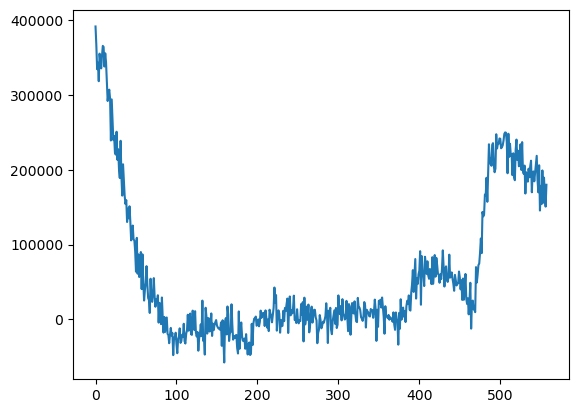

In [1532]:
plt.plot(all_doses_clean_trim[-1,:])

In [1897]:
gr_clus = [1,2,3,4,5,6,6,7,8,9,10]
gr_cuts = [558,558,558,558,558,558,1116,1116,1116,1116,1116]
gr_wbase = [2,3,2,3,2,3,3,1,2,1,1]
gr_wpeak = [5,5,5,5,5,5,5,4,5,4,4]

In [1997]:
all_doses_clean_trim = np.zeros((all_doses_clean.shape[0],558))
all_doses_clean_trim_pn = np.zeros((all_doses_clean.shape[0],558))
all_doses_clean_trim_wbw_pn = np.zeros((all_doses_clean.shape[0],6))
for j in trange(len(gr_clus)):
    vals = all_doses_clean[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_cuts[j]-558):gr_cuts[j]]
    vals_bwell = all_doses_clean[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_cuts[j]-93*(6-gr_wbase[j]+1)):(gr_cuts[j]-93*(6-gr_wbase[j]))]
    if j==6:
        vals_b = np.median(-np.sort(-vals_bwell,axis=1)[...,47:78],axis=1)
    else:
        vals_b = np.median(np.sort(vals_bwell,axis=1)[...,47:78],axis=1)
    vals_bn = (vals.T-vals_b).T
    vals_wbw = np.zeros((vals_bn.shape[0],6))
    
    for w in range(6):
        vals_well = vals_bn[...,w*93:(w+1)*93]
        vals_wbw[...,w] = np.median(np.sort(vals_well,axis=1)[...,47:78],axis=1) #previously used 62:
    vals_wbw[...,gr_wbase[j]-1] = np.zeros(vals_bn.shape[0])
    #if j==6:
    #    vals_wm = np.max(vals_wbw[...,(gr_wbase[6]-1):],axis=1)
    #else:
    #    vals_wm = np.max(vals_wbw,axis=1)
    vals_wm = vals_wbw[...,gr_wpeak[j]]

    all_doses_clean_trim[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),...] = vals
    all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),...] = (vals_bn.T/vals_wm).T
    all_doses_clean_trim_wbw_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),...] = (vals_wbw.T/vals_wm).T

  0%|          | 0/11 [00:00<?, ?it/s]

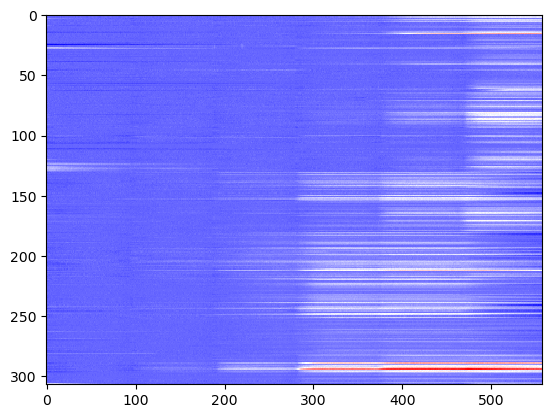

In [1998]:
plt.imshow(all_doses_clean_trim,interpolation='nearest',aspect='auto',cmap='bwr')

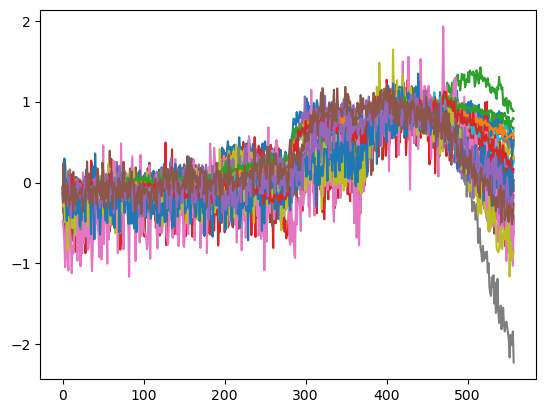

In [1900]:
j=7
plt.plot(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:].T)

In [1416]:
import pandas as pd
def rolling_snr(signal, window_size: int):
    signal_series = pd.Series(signal)
    rolling_mean = signal_series.rolling(window=window_size).mean()
    rolling_std = signal_series.rolling(window=window_size).std()
    rolling_snr = 10 * np.log10((rolling_mean**2) / (rolling_std**2).replace(0, np.finfo(float).eps)) # type: ignore
    return rolling_snr

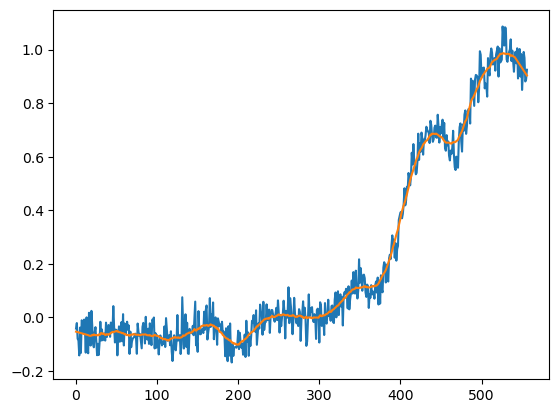

In [1453]:
r = 5
plt.plot(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:][r,...].T)
plt.plot(sg.savgol_filter(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:][r,...].T,31,1))
#plt.plot(rolling_snr(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:][r,...].T,10))

0.04373993701963431

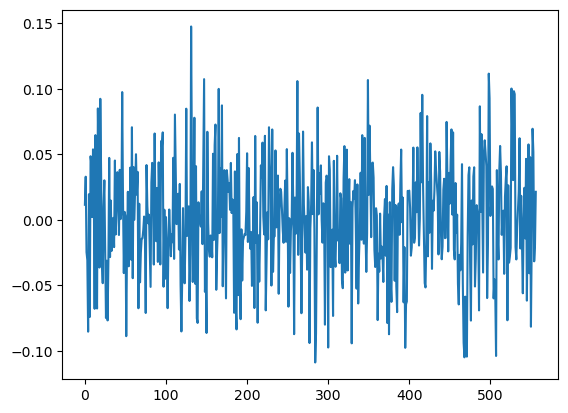

In [1454]:
plt.plot(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:][r,...].T-sg.savgol_filter(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:][r,...].T,31,1))
np.std(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:][r,...].T-sg.savgol_filter(all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j])-1:][r,...].T,31,1))

In [1999]:
all_doses_clean_trim_pn_std = []
for r in range(all_doses_clean_trim_pn.shape[0]):
    all_doses_clean_trim_pn_std.append(np.std(all_doses_clean_trim_pn[r,...].T-sg.savgol_filter(all_doses_clean_trim_pn[r,...].T,31,1)))

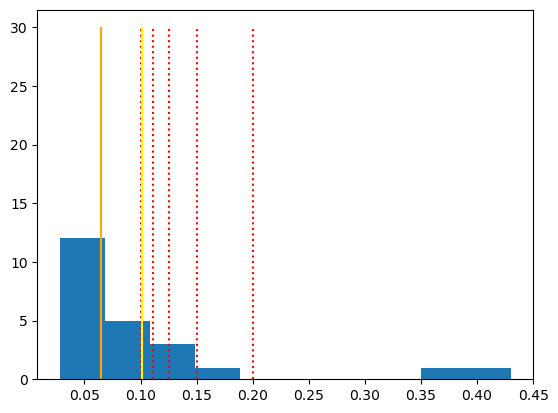

In [1986]:
j = 10
plt.hist(np.array(all_doses_clean_trim_pn_std)[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j])],bins=10)
plt.vlines(x=0.1,ymin=0,ymax=30,color='red',linestyle='dotted')
plt.vlines(x=0.111,ymin=0,ymax=30,color='red',linestyle='dotted')
plt.vlines(x=0.125,ymin=0,ymax=30,color='red',linestyle='dotted')
plt.vlines(x=0.15,ymin=0,ymax=30,color='red',linestyle='dotted')
plt.vlines(x=0.2,ymin=0,ymax=30,color='red',linestyle='dotted')
plt.vlines(x = np.mean(np.array(all_doses_clean_trim_pn_std)[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j])]),ymin=0,ymax=30,color='yellow')
plt.vlines(x = np.median(np.array(all_doses_clean_trim_pn_std)[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j])]),ymin=0,ymax=30,color='orange')

In [1463]:
doses_params_clean.shape

(307, 13)

In [1903]:
c_offset = [11,11,11,11,10,10,11,8,8,10,8]
kds = []
Ls = []

In [2000]:
trimlast = False
trimlast = [False,False,False,False,False,False,False,True,False,True,True]
j = 2
s1 = 10.**(np.arange(6)-c_offset[j])
s1 = s1[(gr_wbase[j])-1:]
#scut = 1/9 # keep just rows with SNR>=9
scut = 1.25*np.median(np.array(all_doses_clean_trim_pn_std)[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j])]) - 0.25*np.min(np.array(all_doses_clean_trim_pn_std)[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j])])
y1_norm = all_doses_clean_trim_wbw_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j])*(np.array(all_doses_clean_trim_pn_std)<scut),(gr_wbase[j])-1:]
if trimlast[j]:
    s1 = s1[:-1]
    y1_norm = y1_norm[...,:-1]

In [2001]:
from scipy.optimize import minimize,basinhopping
def fluor(x, k, L):
    return L / (1 + (k/x))

def model(params, s):
    k0, b, L = params
    b = 0
    return fluor(s,k0,L) + b

# Loss function for two observations
def loss(params, s, y):
    return np.sum((y - model(params, s))**2)
    
# Initial guess for the parameters
initial_guess = [1E-7,0,1]
bounds = [(None,None),(None,None),(1,None)]
#bounds = [(None,None),(None,None),(None,None)]

# Optimization
result = minimize(loss, initial_guess, args=(s1, y1_norm), bounds=bounds, method='BFGS', jac='cs')

# Extract the inverse Hessian matrix from the result (result.hess_inv)
hess_inv = result.hess_inv  # Already in dense matrix form

# Standard errors are the square roots of the diagonal elements of the Hessian inverse
std_errors = np.sqrt(np.diag(hess_inv))

# Confidence intervals (95%)
confidence_range = 1.96*std_errors  # 1.96 for 95% CI

C:\Users\Peter\AppData\Local\Temp\ipykernel_14632\2896961504.py:20: RuntimeWarning: Method BFGS cannot handle bounds.
  result = minimize(loss, initial_guess, args=(s1, y1_norm), bounds=bounds, method='BFGS', jac='cs')


Estimated K (nM) and saturation:  [290.95727619949696, 1.288752774632028]
Estimated standard errors:  [352.4683649361893, 0.49155915378629467]


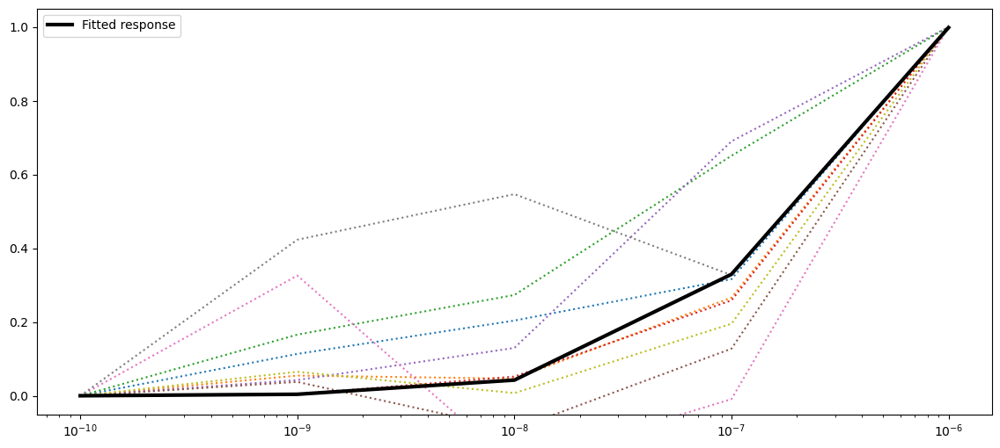

In [2002]:
# Extract the optimized parameters
k, b, L = result.x

# Print the results
print("Estimated K (nM) and saturation: ", [k*(10**9), L])
print("Estimated standard errors: ", [std_errors[0]*(10**9), std_errors[2]])

# Plot the observed vs. fitted signals for both observations
plt.figure(figsize=(14, 6))

plt.subplot(1, 1, 1)
plt.plot(s1,y1_norm.T,linestyle='dotted')
plt.plot(s1,model(result.x, s1), label='Fitted response',color='black',linewidth=3)
plt.ylim(-0.05,1.05)
plt.xscale('log')
plt.legend()
#plt.title('Sensor')

plt.show()

Text(0.5, 1.0, 'sensor dose response across probes')

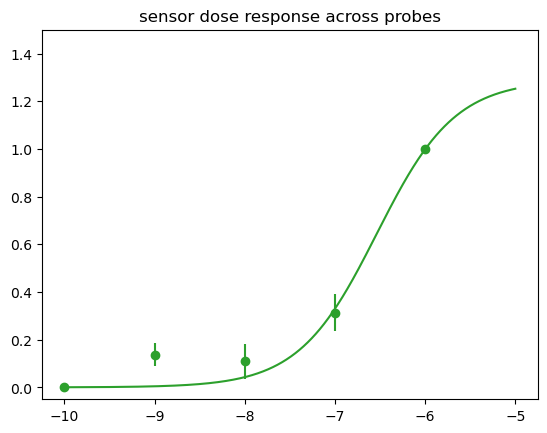

In [2003]:
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
ran = np.arange(-c_offset[j],-c_offset[j]+7)[(gr_wbase[j])-1:]
plt.plot(np.linspace(ran[0],ran[-1],1000),fluor(10**np.linspace(ran[0],ran[-1],1000),k,L),color=colors[j])
plt.errorbar(np.log10(s1),np.mean(y1_norm,axis=0),scipy.stats.sem(y1_norm,axis=0), linestyle='None', marker='o',color=colors[j])
plt.ylim(-0.05,1.5)
plt.title('sensor dose response across probes')

In [1755]:
kds.append(k)
Ls.append(L)

In [1759]:
kds

[8.429822696077575e-08,
 8.898779284283787e-08,
 9.708658406814673e-08,
 1.1931067376588326e-05,
 2.91020711719469e-06,
 7.568202675004545e-06,
 3.077292686791295e-07,
 4.9606766163062715e-06,
 6.424740283522035e-05,
 1.8592243692709665e-08,
 4.5951421892270056e-06]

In [1757]:
Ls

[1.0866386775751844,
 0.9905733008679563,
 1.0905881887619286,
 12.930587558318605,
 1.2899536416797936,
 1.756747091239942,
 1.305556567315318,
 1.0280513350412526,
 1.0486272476042238,
 1.0000000000000189,
 1.0034904667037903]

In [ ]:
# taus

In [11758]:
# Extract the inverse Hessian matrix from the result (result.hess_inv)
hess_inv = result.hess_inv  # Already in dense matrix form

# Standard errors are the square roots of the diagonal elements of the Hessian inverse
std_errors = np.sqrt(np.diag(hess_inv))

# Confidence intervals (95%)
confidence_interval = 1.96  # 1.96 for 95% CI

In [11759]:
std_errors

array([9.18963694e-08, 1.00000000e+00, 2.50921444e-01])

In [1679]:
kds

[]

In [11594]:
np.save(r'H:\CNMFoutputs\peter\mask_matching\all_doses_clean.npy',all_doses_clean)
np.save(r'H:\CNMFoutputs\peter\mask_matching\doses_bg_clean.npy',doses_bg_clean)
np.save(r'H:\CNMFoutputs\peter\mask_matching\doses_params_clean.npy',doses_params_clean)

In [ ]:
# calculating taus - first need to estimate concentrations in each trace based on Kd/L values

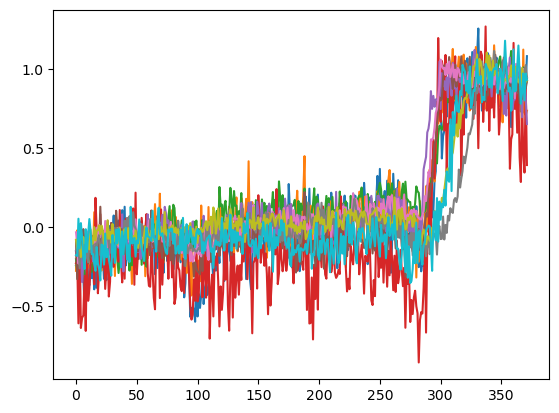

In [1676]:
j=3
adctp = all_doses_clean_trim_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),93*(gr_wbase[j]-1):]
plt.plot(adctp.T)

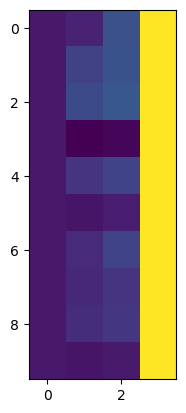

In [1677]:
plt.imshow(all_doses_clean_trim_wbw_pn[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_wbase[j]-1):])

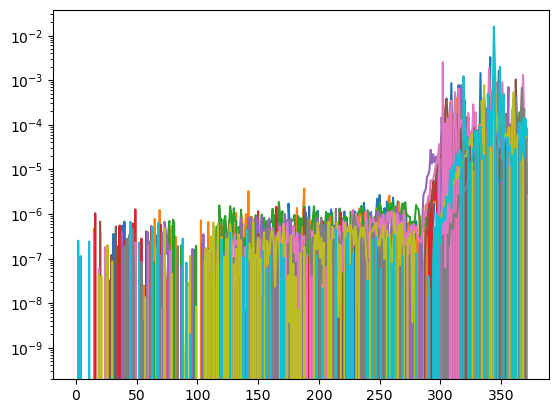

In [1758]:
plt.plot((kds[j]*adctp/(Ls[j]-adctp)).T)
plt.yscale('log')

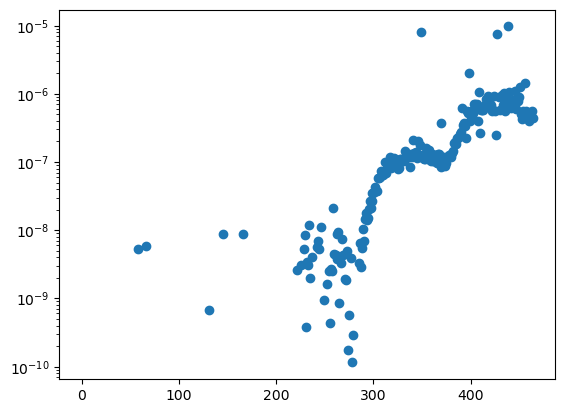

In [11614]:
plt.scatter(x=np.arange(np.mean((kds[j]*adctp/(Ls[j]-adctp)),axis=0).T.shape[0]),y=np.mean((kds[j]*adctp/(Ls[j]-adctp)),axis=0).T)
plt.yscale('log')

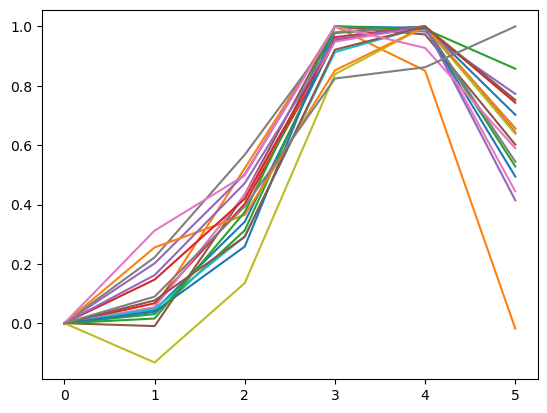

In [11668]:
p = 1
plt.plot(all_doses_clean_trim_wbw_pn[(doses_params_clean[...,11]==9),...][(np.array(mt_probeids_clean)==p),...].T)

In [348]:
mt_fits_by_p = []
trimlast = False
trimlast = True
j = 9
s1 = 10.**(np.arange(6)-c_offset[j])
s1 = s1[(gr_wbase[j])-1:]
if trimlast:
    s1 = s1[:-1]

from scipy.optimize import minimize,basinhopping

    
# Initial guess for the parameters
initial_guess = [1E-6,0,1]
bounds = [(None,None),(None,None),(1,None)]
#bounds = [(None,None),(None,None),(None,None)]

In [349]:
for p in tqdm(np.unique(mt_probeids_clean).tolist()):
    y1_norm = all_doses_clean_trim_wbw_pn[(doses_params_clean[...,11]==9),...][(np.array(mt_probeids_clean)==p),...]
    if trimlast:
        y1_norm = y1_norm[...,:-1]

    def fluor(x, k, L):
        return L / (1 + (k/x))

    def model(params, s):
        k0, b, L = params
        b = 0
        return fluor(s,k0,L) + b
    
    # Loss function for two observations
    def loss(params, s, y):
        return np.sum((y - model(params, s))**2)
        
    # Optimization
    result = minimize(loss, initial_guess, args=(s1, y1_norm), bounds=bounds, method='Powell')

    # Extract the optimized parameters
    k, b, L = result.x
    mt_fits_by_p.append([s1,y1_norm,k,b,L])

100%|████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:00<00:00, 79.79it/s]


In [350]:
len(mt_fits_by_p)

9

In [237]:
mt_fits_by_p

NameError: name 'mt_fits_by_p' is not defined

In [339]:
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

In [334]:
colors = plt.cycler("color", plt.cm.greys(np.linspace(0,1,10))).by_key()['color']

AttributeError: module 'matplotlib.cm' has no attribute 'greys'

In [369]:
cols = []
for p in range(len(mt_fits_by_p)):
    cols.append(((p+1)/12,(p+1)/12,(p+1)/12))

Text(0.5, 1.0, 'MT sensor dose response by probe')

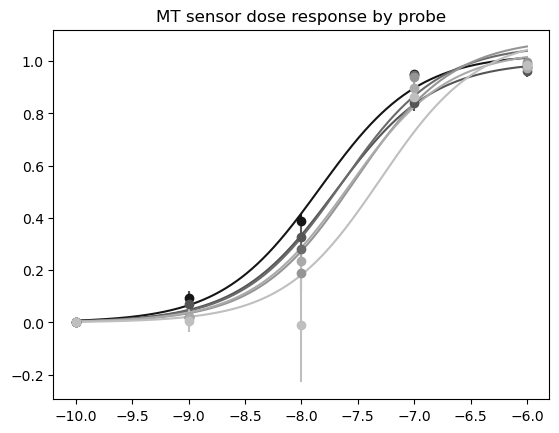

In [370]:
for p in range(len(mt_fits_by_p)):
    if mt_fits_by_p[p][1].shape[0]<4:
        continue
    else:
        plt.plot(np.linspace(-10,-6,1000),fluor(10**np.linspace(-10,-6,1000),mt_fits_by_p[p][2],mt_fits_by_p[p][4]),color=cols[p])#colors[p])
        plt.errorbar(np.log10(s1),np.mean(mt_fits_by_p[p][1],axis=0),scipy.stats.sem(mt_fits_by_p[p][1],axis=0), linestyle='None', marker='o',color=cols[p])#colors[p])
plt.title('MT sensor dose response by probe')

In [461]:
mt_ks = []
for p in range(len(mt_fits_by_p)):
    if mt_fits_by_p[p][1].shape[0]<4:
        continue
    else:
        mt_ks.append(mt_fits_by_p[p][2])

In [476]:
for p in range(len(mt_fits_by_p)):
    print(mt_fits_by_p[p][1].shape[0])

18
3
3
16
21
1
8
18
15


In [462]:
mt_ks

[1.457906724614263e-08,
 1.985410866275214e-08,
 2.2661393702320137e-08,
 2.982422040357837e-08,
 2.636424432680916e-08,
 5.0053319765104503e-08]

In [463]:
np.mean(mt_ks)

2.7222725684451154e-08

In [464]:
scipy.stats.sem(mt_ks,axis=0)

5.045477037436347e-09

In [43]:
p = 9
y1_norm = all_doses_clean_trim_wbw_pn[(doses_params_clean[...,11]==9),...][(np.array(mt_probeids_clean)==p),...]
if trimlast:
    s1 = s1[:-1]
    y1_norm = y1_norm[...,:-1]

Estimated K (nM) and saturation:  [50.053319765104504, 1.0952294227442132]
Number of MT cells:  15


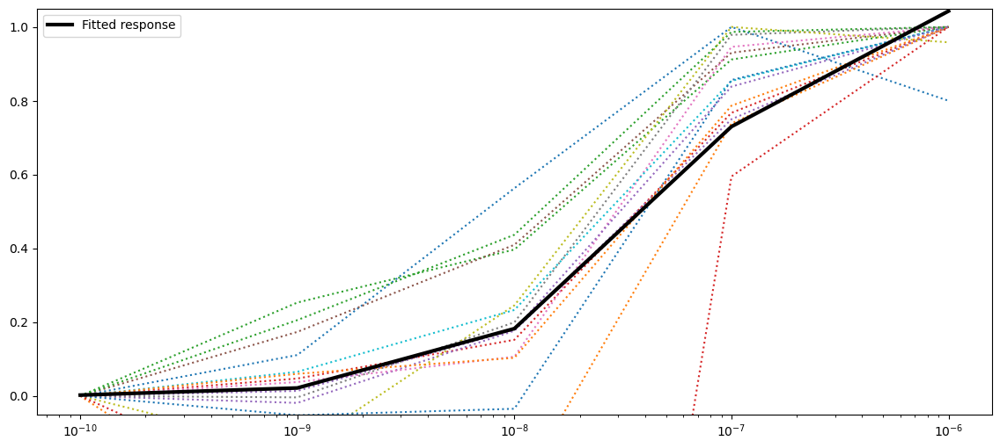

In [45]:


# Print the results
print("Estimated K (nM) and saturation: ", [k*(10**9), L])
print("Number of MT cells: ", y1_norm.shape[0])

# Plot the observed vs. fitted signals for both observations
plt.figure(figsize=(14, 6))

plt.subplot(1, 1, 1)
plt.plot(s1,y1_norm.T,linestyle='dotted')
plt.plot(s1,model(result.x, s1), label='Fitted response',color='black',linewidth=3)
plt.ylim(-0.05,1.05)
plt.xscale('log')
plt.legend()
#plt.title('Sensor')

plt.show()

(18, 5)

In [10911]:
j=6
vals = all_doses_clean[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_cuts[j]-558):gr_cuts[j]]
vals_bwell = all_doses_clean[(doses_params_clean[...,11]==gr_clus[j])*(doses_params_clean[...,10]==gr_cuts[j]),(gr_cuts[j]-93*(6-gr_wbase[j]+1)):(gr_cuts[j]-93*(6-gr_wbase[j]))]
if j==6:
    vals_b = np.mean(-np.sort(-vals_bwell,axis=1)[...,62:],axis=1)
else:
    vals_b = np.mean(np.sort(vals_bwell,axis=1)[...,62:],axis=1)
vals_bn = (vals.T-vals_b).T
vals_wbw = np.zeros((vals_bn.shape[0],6))

for w in range(6):
    vals_well = vals_bn[...,w*93:(w+1)*93]
    vals_wbw[...,w] = np.mean(np.sort(vals_well,axis=1)[...,62:],axis=1)
vals_wbw[...,gr_wbase[j]-1] = np.zeros(vals_bn.shape[0])
vals_wm = np.max(vals_wbw,axis=1)

vals_pn = (vals_bn.T/vals_wm).T
vals_wbw_pn = (vals_wbw.T/vals_wm).T

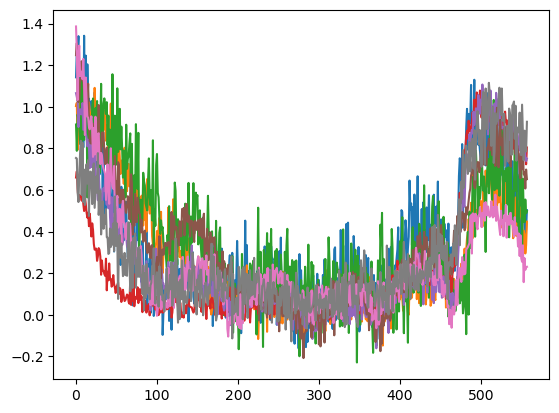

In [10912]:
plt.plot((vals_bn.T/vals_wm))

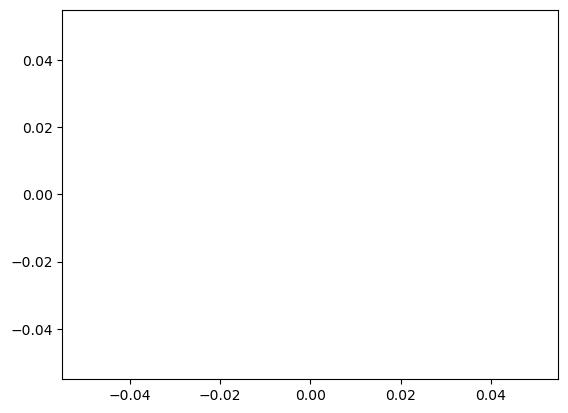

In [10907]:
plt.plot(vals_bn.T)

In [10816]:
doses_params_clean[...,11]==10

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

In [10815]:
doses_params_clean[...,10]==558

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True, False, False, False,
       False, False,

In [10819]:
(doses_params_clean[...,11]==6)*(doses_params_clean[...,10]==1116)

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True,  True,  True,
        True,  True,

In [2787]:
len(row_ids[l][pythonic_list_doses[l]])

73

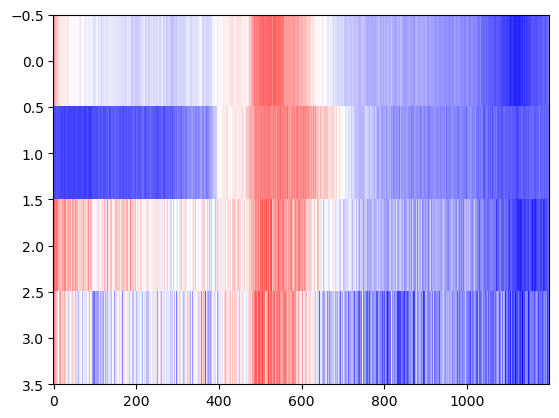

In [2798]:
c = 1
plt.imshow(cnmf_dicts_doses[l]['CY_matched_raw_corr_norm1'][np.array(row_ids[l][pythonic_list_doses[l]])==c,:1200],interpolation='nearest',aspect='auto',cmap='bwr')

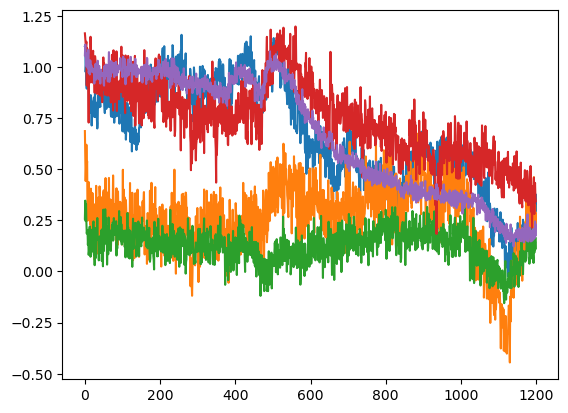

In [2774]:
plt.plot(cnmf_dicts_doses[l]['CY_matched_raw_corr_norm1'][np.array(row_ids[l][pythonic_list_doses[l]])==c,:1200].T)

In [2720]:
# testing these outputs
l = 5
i = 2
print(movie_list_full[l][i+1])

cnmf_dict_i_mov = {
    'base_dir': cnmf_dicts_id[l]['base_dir'],
    'cnmf_path': cnmf_dicts_id[l]['cnmf_path'],
    'cnmf': list(),
    'spcomps': list(),
    'CY': list(),
    'cnmf_matched_path': list(),
    'cnmf_matched': list(),
    'spcomps_matched': list(),
    'CY_matched': list(),
    'cnmf_matched_path_raw': list(),
    'cnmf_matched_raw': list(),
    'spcomps_matched_raw': list(),
    'CY_matched_raw': list()
}

if i==0:
    cnmf_dict_i_mov['cnmf_matched_path_raw'] = os.path.join(movie_list_full[l][i+1], f'ch0_means_movie_nobg_cnmf_mr_raw_refit_matched.hdf5')
else:
    cnmf_dict_i_mov['cnmf_matched_path_raw'] = os.path.join(movie_list_full[l][i+1], f'ch0_means_movie_nobg_cnmf_mr_raw_refit_matched{i:01}.hdf5')
            
# CNMFE model
cnmf_dict_i_mov['cnmf_matched_raw'] = cnmf.load_CNMF(cnmf_dict_i_mov['cnmf_matched_path_raw'], 
                            n_processes=1,
                            dview=None)
cnmf_dict_i_mov['CY_matched_raw'] = cnmf_dict_i_mov['cnmf_matched_raw'].estimates.C + cnmf_dict_i_mov['cnmf_matched_raw'].estimates.YrA # temporal loadings

H:\CNMFoutputs\peter\mask_matching\20230922_PL28_done\20230922_PL28_wells301_david_done_qc_doneqc


In [2721]:
cnmf_dict_i_mov['CY_matched_raw'].shape

(77, 1953)

In [2722]:
len(row_ids[l][i])

77

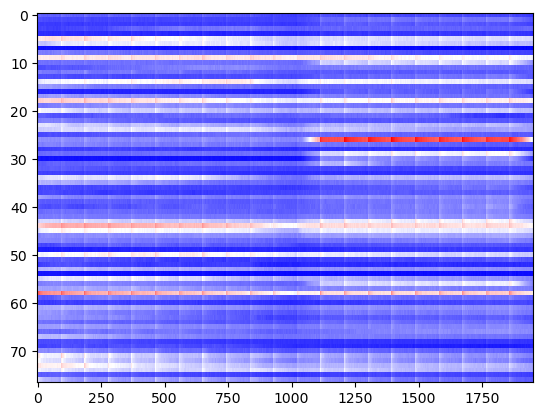

In [2723]:
plt.imshow(cnmf_dict_i_mov['CY_matched_raw'][np.argsort(row_ids[l][i]),...],interpolation='nearest',aspect='auto',cmap='bwr')

In [2724]:
np.sort(row_ids[l][i])[30]

2

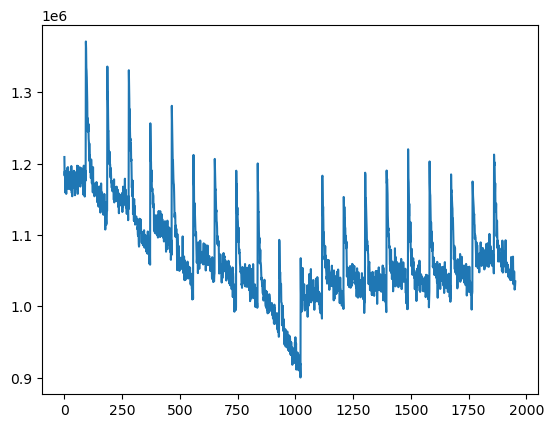

In [2726]:
plt.plot(cnmf_dict_i_mov['CY_matched_raw'][np.argsort(row_ids[l][i]),...][65,...].T)

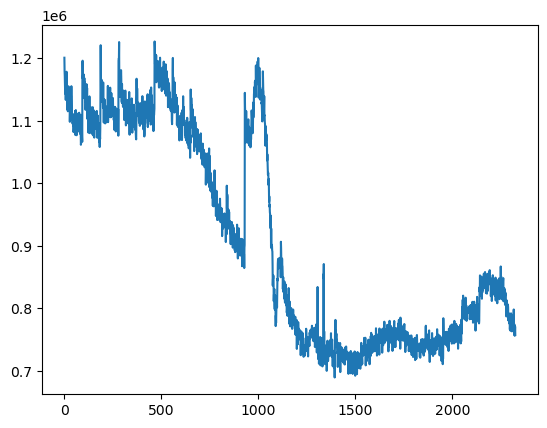

In [2431]:
j=69
plt.plot(cnmf_dict_i_mov['CY_matched_raw'][j,...].T)

In [2274]:
warp_dir = os.path.join(cnmf_dicts_id[l]['base_dir'],os.path.split(os.path.dirname(movie_list_id[l]))[1].split('_')[0] + '_' + os.path.split(os.path.dirname(movie_list_id[l]))[1].split('_')[1] + '_rwd')
compmatches = []
for path in [x for x in os.listdir(warp_dir) if 'compmatch' in x]:
    compmatches.append(np.load(os.path.join(warp_dir, path),allow_pickle=True)[()])

In [2275]:
comps = list(set(chain.from_iterable([x['Mrefs_c'] for x in compmatches])))
comp_id = comp_ids[l]
ids = [comp_id[comps.index(x)] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]

In [2276]:
ids

[1]

In [2283]:
row_ids[l][i][j]

1

In [2156]:
np.argsort(row_ids[l][i])

array([ 0, 29, 30, 65, 36, 37, 38, 39, 42, 27, 43, 48, 49, 52, 54, 55, 56,
       57, 62, 47, 25, 33,  5,  7,  9,  1,  2, 17, 15, 16, 45, 51,  6, 59,
       10, 24, 31, 46, 21, 11, 32, 58, 20,  8, 34, 12, 35, 41, 66, 19, 61,
       60,  3, 64, 22, 40, 13, 18, 28, 26, 44,  4, 50, 14, 63, 23, 53],
      dtype=int64)

In [2277]:
compmatches[i]['Mrefs'][j]

[37]

In [2278]:
comps

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99,
 100,
 101,
 102,
 103,
 104,
 105,
 106,
 107,
 108,
 109,
 110,
 111,
 112,
 113,
 114,
 115,
 116,
 117,
 118,
 119,
 120,
 121,
 122,
 123,
 124,
 125,
 126,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 137,
 138,
 139,
 140,
 141,
 142,
 143,
 144,
 145,
 146,
 147,
 148,
 149,
 150,
 151,
 152,
 153,
 154,
 155,
 156,
 157,
 158,
 159,
 160,
 161,
 162,
 163,
 164,
 165,
 166,
 167,
 168,
 169]

In [2280]:
comps[35]

37

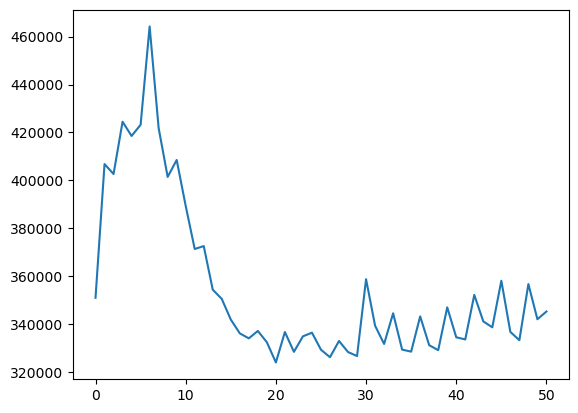

In [2295]:
plt.plot(cnmf_dicts_id[l]['CY'][37,])

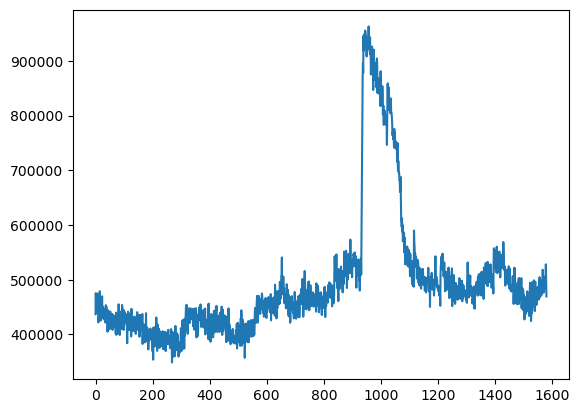

In [2432]:
plt.plot(cnmf_dicts_id[l]['CY_matched_raw'][j,])

In [2293]:
len(comps)

166

In [2294]:
cnmf_dicts_id[l]['CY'].shape

(170, 51)

In [1834]:
l=1
movie_list_id[l]

'H:\\CNMFoutputs\\peter\\mask_matching\\20230915_PL52_done\\20230915_PL52_wells301_Yael_Done_qc_doneqc'

In [1835]:
cnmf_dicts_id[l]['base_dir']

'H:\\CNMFoutputs\\peter\\stitch_warp_done'

In [1836]:
pythonic_list_id[l]

2

In [1837]:
warp_dir = os.path.join(base_dir,os.path.split(os.path.dirname(movie_list_id[l]))[1].split('_')[0] + '_' + os.path.split(os.path.dirname(movie_list_id[l]))[1].split('_')[1] + '_rwd')
warp_dir

'H:\\CNMFoutputs\\peter\\stitch_warp_done\\20230915_PL52_rwd'

In [1839]:
[x for x in os.listdir(warp_dir) if 'compmatch' in x]

['ch0_means_movie_nobg_compmatch.npy',
 'ch0_means_movie_nobg_compmatch1.npy',
 'ch0_means_movie_nobg_compmatch2.npy',
 'ch0_means_movie_nobg_compmatch3.npy']

In [1840]:
compmatches = []
for path in [x for x in os.listdir(warp_dir) if 'compmatch' in x]:
    compmatches.append(np.load(os.path.join(warp_dir, path),allow_pickle=True)[()])

100%|████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:01<00:00,  3.27it/s]


In [1925]:
comps = list(set(chain.from_iterable([x['Mrefs_c'] for x in compmatches])))

In [1926]:
comp_id = np.array([0]*len(comps))
comp_id.shape

(114,)

In [ ]:
# call ligand id by the following numbers:
# 1. avp
# 2. oxt
# 3. 5ht
# 4. cck
# 5. ne
# 6. da
# 7. ach
# 8. atp
# 9. mt
# 10. ha

In [1927]:
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['avp_rows']] for x in y]] = 1
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['oxt_rows']] for x in y]] = 2
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['5ht_rows']] for x in y]] = 3
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['cck_rows']] for x in y]] = 4
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['ne_rows']] for x in y]] = 5
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['da_rows']] for x in y]] = 6
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['ach_rows']] for x in y]] = 7
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['atp_rows']] for x in y]] = 8
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['mt_rows']] for x in y]] = 9
comp_id[[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['ha_rows']] for x in y]] = 10

print(comp_id)

[ 0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  8  0  0  0  0  7  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  7  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0 10  0  0  0  0  0]


In [1931]:
comp_ids[l] = list(comp_id)

In [1919]:
# at this point the ids are assigned to each component of the id movie - in all but 0,1,3 this is 001 ref movie for all other clicks

# to do - dictionary matching rows (i.e. components) across movies and propagating ids - in 0,1,3 additional step of transferring to 001 movie

# issue - components may be matched slightly differently in ref movie when clicked against different mov movies
## one solution - keep the union (e.g. trust all matches), another solution - keep the intersection (e.g. only matches that are confirmed every time)
## maybe best is to keep the mode! or - maybe the best is to trust the id-dose responses clicking since it probably had best driven mov components?
## how much of a problem is this? can it be assessed? what if a component is matched to different partners in different clicks?
## in case of different partners in different clicks, there is the possibility of mismatched ids also
## or - if components are merged in one clicking but kept apart in another - merge them in that one? would need to recalculate CNMF raw...
## does matching cell-by-cell really matter much beyond inheriting ids? any analyses ever where exact same cell has to be compared?

# how about - each compmatch has comp_ids for ref and mov comps - mov comp_ids inherit from ref via matches - then only issue is off-id matches
## how to negotiate these? probably core match is most trustworthy (also traces cleaned by clustering)
## then these matches must be wrong and id cannot be reliably propagated - unless one component clearly dominant??
## best measure of dominance is correlation with merged signal - e.g. component's signal from ['CY'] correlated with group's ['CY_matched']!

# so the logical flow goes:
# 1. propagate ids from cells 'CY_matched_raw' to their subcomponents 'CY'
# 2. (0,1,3 only) if ids are in mov - propagate them from mov's 'CY' to ref(001)'s 'CY' and 'CY_matched_raw' (unambiguous) - already done
# 3. propagate ids from ref subcomponents 'CY' to each ref/mov's 'CY_matched_raw' - and if off-id ref subcomponents are ever merged, pick id of 
    # subcomponent in ref 'CY' that is most correlated with corresponding ref 'CY_matched'

# as far as keeping track of all of these across movies - keep careful dictionaries:
## in the end - want the ids of the 'CY_matched_raw' rows - but for the ref movie, also need to keep subcomponent ids
## so basically, just need to make one list of subcomponent ids for 001 movie on 'CY' plus two lists of ref/mov component ids on 'CY_matched_raw' for every match
### don't worry about "chain matches" for now (e.g. matching cell-by-cell from mov 2 to mov 4 via ref 001) - although they're possible

In [ ]:
# propagating ids to non-ref movies
# row_ids is a list of length len(movie_list_id)
# each item within row_ids is a list of lists containing row ids for each match (same for ref and mov!)
# comp_ids is also a list of length len(movie_list_id)
# each item within comp_ids is a list of subcomponent ids for the given probe's 001 movie on 'CY'
row_id_l = []
for i in range(len(compmatches)):
    row_id = np.array([0]*len(compmatches[i]['Mrefs']))
    if i == pythonic_list_id[l]: # take directly from clustering
        row_id[cnmf_dicts_id[l]['avp_rows']] = 1
        row_id[cnmf_dicts_id[l]['oxt_rows']] = 2
        row_id[cnmf_dicts_id[l]['5ht_rows']] = 3
        row_id[cnmf_dicts_id[l]['cck_rows']] = 4
        row_id[cnmf_dicts_id[l]['ne_rows']] = 5
        row_id[cnmf_dicts_id[l]['da_rows']] = 6
        row_id[cnmf_dicts_id[l]['ach_rows']] = 7
        row_id[cnmf_dicts_id[l]['atp_rows']] = 8
        row_id[cnmf_dicts_id[l]['mt_rows']] = 9
        row_id[cnmf_dicts_id[l]['ha_rows']] = 10
    else: # propagate from 001 subcomps
        # first need to load the necessary cnmf stuff!
        cnmf_dict_i = {
            'base_dir': cnmf_dicts_id[l]['base_dir'],
            'cnmf_path': cnmf_dicts_id[l]['cnmf_path'],
            'cnmf': list(),
            'spcomps': list(),
            'CY': list(),
            'cnmf_matched_path': list(),
            'cnmf_matched': list(),
            'spcomps_matched': list(),
            'CY_matched': list(),
            'cnmf_matched_path_raw': list(),
            'cnmf_matched_raw': list(),
            'spcomps_matched_raw': list(),
            'CY_matched_raw': list()
        }
    
        if i==0:
            cnmf_dict_i['cnmf_matched_path'] = os.path.join(movie_list_full[l][0], f'ch0_means_movie_nobg_cnmf_merged_refit_matched.hdf5')
        else:
            cnmf_dict_i['cnmf_matched_path'] = os.path.join(movie_list_full[l][0], f'ch0_means_movie_nobg_cnmf_merged_refit_matched{i:01}.hdf5')
                
        # CNMFE model
        cnmf_dict_i['cnmf_matched'] = cnmf.load_CNMF(cnmf_dict_i['cnmf_matched_path'], 
                                    n_processes=1,
                                    dview=None)
        
        cnmf_dict_i['CY_matched'] = cnmf_dict_i['cnmf_matched'].estimates.C + cnmf_dict_i['cnmf_matched'].estimates.YrA # temporal loadings

        row_id = np.array([0]*len(compmatches[i]['Mrefs']))
        for j in range(len(compmatches[i]['Mrefs'])):
            ids = [comp_id[comps.index(x)] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]
            if len(ids) !=0:
                if np.unique(ids).shape[0] == 1:
                    row_id[j] = ids[0]
                else:
                    CY_subs = [cnmf_dicts_id[l]['CY'][comps.index(x),:] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]
                    CY_cell = cnmf_dict_i['CY_matched'][j]
                    pear_vals = np.array([scipy.stats.pearsonr(x,CY_cell) for x in CY_subs])
                    row_id[j] = ids[np.where(pear_vals==np.max(pear_vals))[0][0]]
        
    row_id_l.append(list(row_id))
row_ids[l] = row_id_l

In [2010]:
i = 1
comp_id

array([ 0,  0,  0,  0,  0,  0,  9,  0,  0,  0,  0,  0,  0,  0,  0,  8,  0,
        0,  0,  0,  7,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  7,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0, 10,  0,  0,  0,  0,  0])

In [1946]:
comps

[0,
 2,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 18,
 20,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 47,
 48,
 49,
 51,
 52,
 53,
 56,
 58,
 59,
 60,
 61,
 62,
 63,
 66,
 68,
 69,
 70,
 71,
 73,
 76,
 80,
 84,
 86,
 87,
 88,
 89,
 91,
 93,
 94,
 99,
 101,
 103,
 108,
 109,
 116,
 118,
 119,
 121,
 123,
 124,
 125,
 127,
 128,
 129,
 130,
 131,
 132,
 133,
 134,
 135,
 136,
 138,
 141,
 144,
 147,
 148,
 153,
 155,
 156,
 157,
 160,
 161,
 162,
 163,
 165,
 169,
 172,
 173,
 174,
 175,
 176,
 178,
 180,
 182]

In [1950]:
compmatches[i]['Mrefs']

[[109],
 [33],
 [128],
 [53],
 [182],
 [58],
 [180],
 [169],
 [121],
 [125, 60],
 [175],
 [48],
 [20],
 [119],
 [116],
 [41],
 [161],
 [6],
 [101],
 [130],
 [0],
 [28],
 [132, 25],
 [173, 84],
 [124],
 [36],
 [40],
 [134],
 [163, 43],
 [76],
 [59],
 [26],
 [176],
 [7, 10],
 [12],
 [87, 86],
 [144],
 [2],
 [45, 178, 44, 42],
 [38, 37],
 [162, 63],
 [133, 71],
 [73],
 [31],
 [52],
 [70, 153],
 [135],
 [51],
 [165, 93],
 [24, 123],
 [18],
 [136, 23],
 [16, 13],
 [62, 61],
 [27]]

In [2005]:
row_id = np.array([0]*len(compmatches[i]['Mrefs']))
for j in range(len(compmatches[i]['Mrefs'])):
    ids = [comp_id[comps.index(x)] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]
    if len(ids) !=0:
        if np.unique(ids).shape[0] == 1:
            row_id[j] = ids[0]
        else:
            CY_subs = [cnmf_dicts_id[l]['CY'][comps.index(x),:] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]
            CY_cell = cnmf_dict_i['CY_matched'][j]
            pear_vals = np.array([scipy.stats.pearsonr(x,CY_cell) for x in CY_subs])
            row_id[j] = ids[np.where(pear_vals==np.max(pear_vals))[0][0]]

In [2006]:
row_id

array([ 0,  0,  0,  0,  0,  0,  0,  0,  7,  0,  0,  0,  0,  8,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0,  0,  7,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  9,  0,  0,  0,  0,  0,  0,  0,  0,  0, 10,  0,  0,  0,
        0,  0,  0,  0,  0])

In [2011]:
cnmf_dict_i = {
    'base_dir': cnmf_dicts_id[l]['base_dir'],
    'cnmf_path': cnmf_dicts_id[l]['cnmf_path'],
    'cnmf': list(),
    'spcomps': list(),
    'CY': list(),
    'cnmf_matched_path': list(),
    'cnmf_matched': list(),
    'spcomps_matched': list(),
    'CY_matched': list(),
    'cnmf_matched_path_raw': list(),
    'cnmf_matched_raw': list(),
    'spcomps_matched_raw': list(),
    'CY_matched_raw': list()
}

if i==0:
    cnmf_dict_i['cnmf_matched_path'] = os.path.join(movie_list_full[l][0], f'ch0_means_movie_nobg_cnmf_merged_refit_matched.hdf5')
else:
    cnmf_dict_i['cnmf_matched_path'] = os.path.join(movie_list_full[l][0], f'ch0_means_movie_nobg_cnmf_merged_refit_matched{i:01}.hdf5')

# CNMFE model
cnmf_dict_i['cnmf_matched'] = cnmf.load_CNMF(cnmf_dict_i['cnmf_matched_path'], 
                            n_processes=1,
                            dview=None)

cnmf_dict_i['CY_matched'] = cnmf_dict_i['cnmf_matched'].estimates.C + cnmf_dict_i['cnmf_matched'].estimates.YrA # temporal loadings

In [2012]:
cnmf_dict_i['CY_matched'].shape

(55, 36)

In [1975]:
cnmf_dicts_id[l]['CY_matched'].shape

(54, 51)

In [2013]:
len(compmatches[i]['Mrefs'])

55

In [1977]:
CY_subs = [cnmf_dicts_id[l]['CY'][comps.index(x),:] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]
CY_cell = cnmf_dict_i['CY_matched'][j]

In [1987]:
scipy.stats.pearsonr(cnmf_dict_i['CY_matched'][0],cnmf_dict_i['CY_matched'][1])[0]

0.8174778793636985

In [1990]:
p = np.array([scipy.stats.pearsonr(x,cnmf_dict_i['CY_matched'][0])[0] for x in [cnmf_dict_i['CY_matched'][n] for n in [1,2,3,4]]])

In [1993]:
np.where(p==np.max(p))[0][0]

3

In [1951]:
compmatches[i]['Mrefs'][9]

[125, 60]

In [1954]:
comps.index(compmatches[i]['Mrefs'][9][1])

49

In [1956]:
comp_id[49]

0

In [1958]:
j=9
[comp_id[comps.index(x)] for x in compmatches[i]['Mrefs'][j] if comp_id[comps.index(x)]!=0]

[]

In [1965]:
np.unique([1,2,2])[0]

1

In [1968]:
cnmf_dicts_id[l]['CY_matched'].shape

(54, 51)

In [1911]:
[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['avp_rows']] for x in y]

[]

In [1907]:
comps.index(3)

ValueError: 3 is not in list

In [1879]:
len(compmatches[pythonic_list_id[l]]['Mrefs'])

54

In [1862]:
len([x for y in compmatches[pythonic_list_id[l]]['Mrefs'] for x in y])

69

In [1860]:
len(compmatches[pythonic_list_id[l]]['Mpairs'])

87

In [1871]:
set(compmatches[pythonic_list_id[l]]['Mrefs_c'])

{2,
 6,
 8,
 10,
 12,
 13,
 15,
 18,
 20,
 22,
 23,
 24,
 25,
 27,
 30,
 31,
 33,
 36,
 38,
 40,
 42,
 43,
 44,
 45,
 48,
 51,
 52,
 53,
 56,
 58,
 60,
 62,
 68,
 70,
 71,
 73,
 80,
 84,
 86,
 89,
 108,
 109,
 119,
 121,
 123,
 124,
 125,
 127,
 128,
 129,
 130,
 131,
 132,
 134,
 136,
 138,
 147,
 148,
 153,
 155,
 156,
 157,
 163,
 165,
 173,
 174,
 176,
 178,
 182}

In [1872]:
set(compmatches[pythonic_list_id[l-1]]['Mrefs_c'])

{0,
 2,
 6,
 7,
 10,
 12,
 13,
 16,
 18,
 20,
 23,
 24,
 25,
 26,
 27,
 28,
 31,
 33,
 36,
 37,
 38,
 40,
 41,
 42,
 43,
 44,
 45,
 48,
 51,
 52,
 53,
 58,
 59,
 60,
 61,
 62,
 63,
 70,
 71,
 73,
 76,
 84,
 86,
 87,
 93,
 101,
 109,
 116,
 119,
 121,
 123,
 124,
 125,
 128,
 130,
 132,
 133,
 134,
 135,
 136,
 144,
 153,
 161,
 162,
 163,
 165,
 169,
 173,
 175,
 176,
 178,
 180,
 182}

In [1882]:
len(set(compmatches[pythonic_list_id[l]]['Mrefs_c']) & set(compmatches[pythonic_list_id[l-1]]['Mrefs_c']))

50

In [1846]:
cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape

(54, 1581)

In [1849]:
cnmf_dicts_id[l]['atp_rows']

[3]

In [1901]:
[x for y in [compmatches[pythonic_list_id[l]]['Mrefs'][x] for x in cnmf_dicts_id[l]['atp_rows']] for x in y]

[15]

In [1895]:
cnmf_dicts_id[l]['atp_rows']

[3]

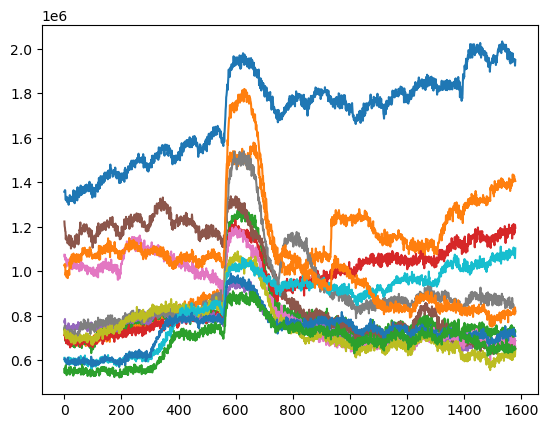

In [1830]:
l=5
plt.plot(cnmf_dicts_id[l]['CY_matched_raw_corr'][cnmf_dicts_id[l]['ne_rows'],...].T)

In [1428]:
well_onsets_id[l][well_ids_id[l].index('NE')]

558

6

In [1107]:
np.unique(hdbs_id.labels_).shape[0]

2

In [1108]:
np.argsort(hdbs_id.labels_)

array([ 0, 28, 29, 30, 31, 32, 33, 34, 35, 36, 38, 27, 39, 41, 42, 43, 44,
       46, 47, 48, 49, 50, 51, 40, 52, 26, 24,  1,  2,  3,  4,  5,  6,  7,
        8,  9, 10, 11, 25, 12, 14, 15, 16, 17, 18, 19, 20, 21, 23, 13, 53,
       37, 45, 22], dtype=int64)

In [ ]:
np.arange(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'].shape[0])[hdbs_id.labels_==1,...]

In [1103]:
cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][np.argsort(hdbs_id.labels_)[lcounts_id[1,0]:],...].shape

(3, 1581)

In [ ]:
plt.plot(cnmf_dicts_id[l]['CY_matched_raw_corr_norm1'][np.argsort(hdbs_id.labels_)[lcounts_id[1,0]:],...][15,...].T)